In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
! pip install ultralytics

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 898.5/898.5 kB 14.5 MB/s eta 0:00:00


In [134]:
import torch
import torch.nn as nn
from ultralytics import YOLO
from torchvision import transforms
from PIL import Image
import numpy as np
import random
import matplotlib.pyplot as plt


torch.backends.cudnn.deterministic = True
torch.backends.cudnn.benchmark = False

# Step 1: Load trained YOLOv8 model
Model = YOLO('/content/drive/MyDrive/DM project/best.pt')
class_idx = json.load(open("/content/model_labels.json"))
idx2label = list(class_idx.values())

print(idx2label)


['-Road narrows on right', '50 mph speed limit', 'Attention Please-', 'Beware of children', 'CYCLE ROUTE AHEAD WARNING', 'Dangerous Left Curve Ahead', 'Dangerous Rright Curve Ahead', 'End of all speed and passing limits', 'Give Way', 'Go Straight or Turn Right', 'Go straight or turn left', 'Keep-Left', 'Keep-Right', 'Left Zig Zag Traffic', 'No Entry', 'No_Over_Taking', 'Overtaking by trucks is prohibited', 'Pedestrian Crossing', 'Round-About', 'Slippery Road Ahead', 'Speed Limit 20 KMPh', 'Speed Limit 30 KMPh', 'Stop_Sign', 'Straight Ahead Only', 'Traffic_signal', 'Truck traffic is prohibited', 'Turn left ahead', 'Turn right ahead', 'Uneven Road']


In [135]:

# Step 2: Extract the backbone (CSPDarknet53)
backbone = Model.model.model[:10]


num_classes = 29
sample_image = torch.randn(1, 3, 416, 416)  # Adjust size if necessary
sample_output = backbone(sample_image)
output_channels = sample_output.shape[1]

classify_model = nn.Sequential(
    backbone,  # Use the CSPDarknet53 backbone
    nn.AdaptiveAvgPool2d((1, 1)),  # Global Average Pooling to reduce to (batch_size, channels, 1, 1)
    nn.Flatten(),  # Flatten to (batch_size, channels)
    nn.Linear(in_features=output_channels, out_features=num_classes)  # Linear layer for classification
)

preprocess = transforms.Compose([
    transforms.Resize((416, 416)),  # Resize to 416x416
    transforms.ToTensor(),          # Convert to tensor
    #transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),  # Normalize
])

def image_folder_custom_label(root, transform, custom_label) :

    # custom_label
    # type : List
    # index -> label
    # ex) ['tench', 'goldfish', 'great_white_shark', 'tiger_shark']

    old_data = dsets.ImageFolder(root = root, transform = transform)
    old_classes = old_data.classes

    label2idx = {}

    for i, item in enumerate(idx2label) :
        label2idx[item] = i

    new_data = dsets.ImageFolder(root = root, transform = transform,
                                 target_transform = lambda x : custom_label.index(old_classes[x]))
    new_data.classes = idx2label
    new_data.class_to_idx = label2idx

    return new_data

normal_data = image_folder_custom_label(root = '/content/drive/MyDrive/Data mining project/dataset_new', transform = preprocess, custom_label = idx2label)
normal_loader = Data.DataLoader(normal_data, batch_size=1, shuffle=False)

True Image & True Label


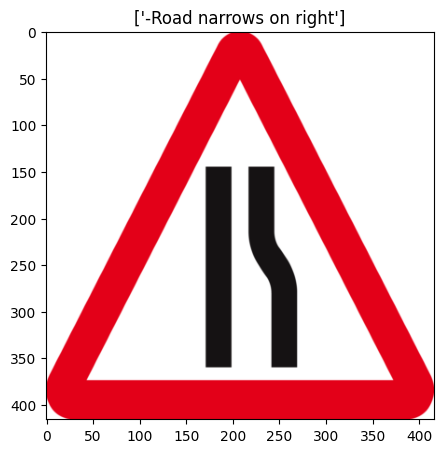

In [136]:
def imshow(img, title):
    npimg = img.numpy()
    fig = plt.figure(figsize = (5, 15))
    plt.imshow(np.transpose(npimg,(1,2,0)))
    plt.title(title)
    plt.show()
normal_iter = iter(normal_loader)
images, labels = next(normal_iter) # Change normal_iter.next() to next(normal_iter)

print("True Image & True Label")
imshow(torchvision.utils.make_grid(images, normalize=True), [normal_data.classes[i] for i in labels])

In [127]:
Model.names

{0: '-Road narrows on right',
 1: '50 mph speed limit',
 2: 'Attention Please-',
 3: 'Beware of children',
 4: 'CYCLE ROUTE AHEAD WARNING',
 5: 'Dangerous Left Curve Ahead',
 6: 'Dangerous Rright Curve Ahead',
 7: 'End of all speed and passing limits',
 8: 'Give Way',
 9: 'Go Straight or Turn Right',
 10: 'Go straight or turn left',
 11: 'Keep-Left',
 12: 'Keep-Right',
 13: 'Left Zig Zag Traffic',
 14: 'No Entry',
 15: 'No_Over_Taking',
 16: 'Overtaking by trucks is prohibited',
 17: 'Pedestrian Crossing',
 18: 'Round-About',
 19: 'Slippery Road Ahead',
 20: 'Speed Limit 20 KMPh',
 21: 'Speed Limit 30 KMPh',
 22: 'Stop_Sign',
 23: 'Straight Ahead Only',
 24: 'Traffic_signal',
 25: 'Truck traffic is prohibited',
 26: 'Turn left ahead',
 27: 'Turn right ahead',
 28: 'Uneven Road'}

True Image & Predicted Label
true label:['-Road narrows on right']


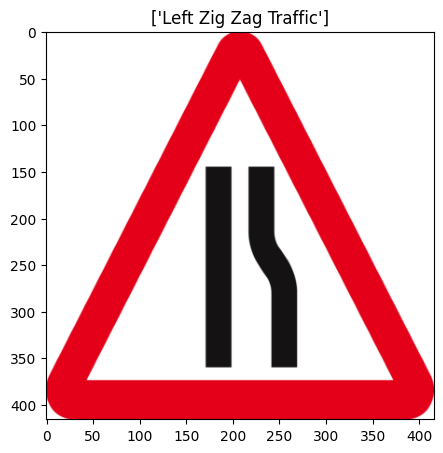

true label:['-Road narrows on right']


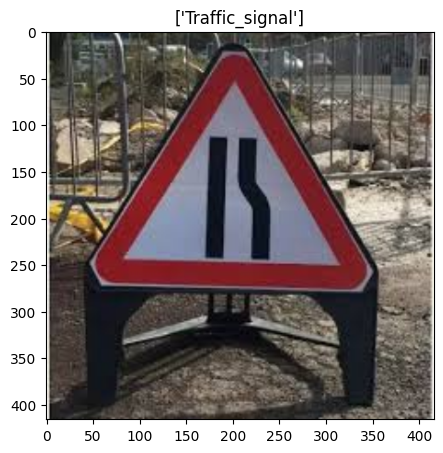

true label:['-Road narrows on right']


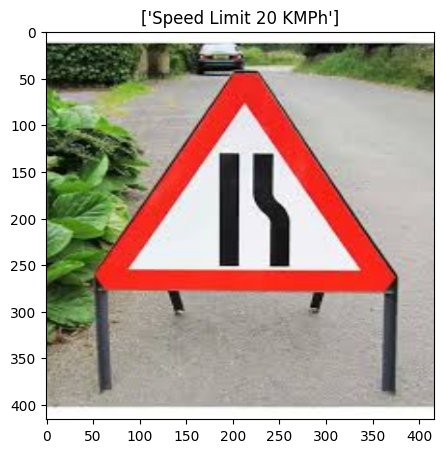

true label:['-Road narrows on right']


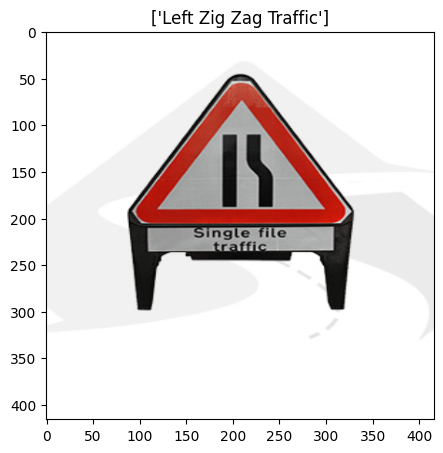

true label:['50 mph speed limit']


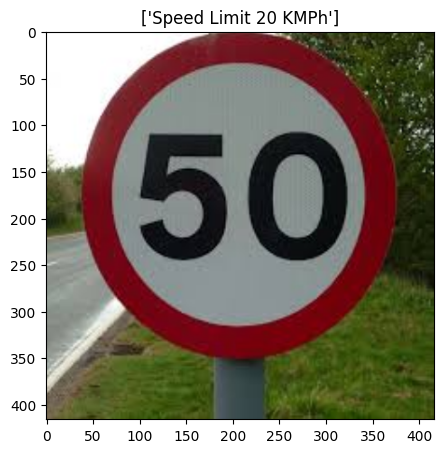

true label:['50 mph speed limit']


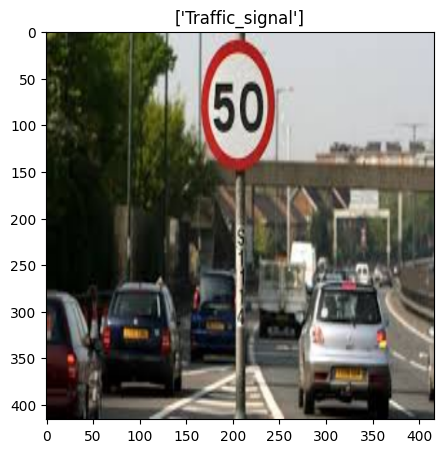

true label:['50 mph speed limit']


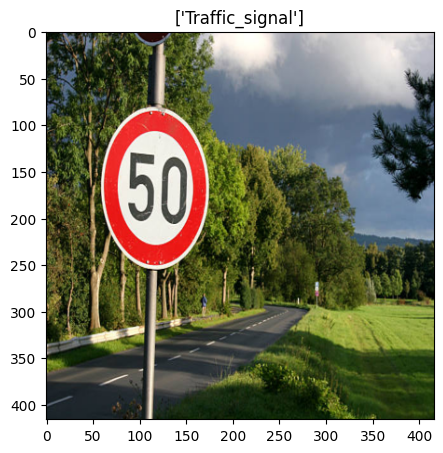

true label:['50 mph speed limit']


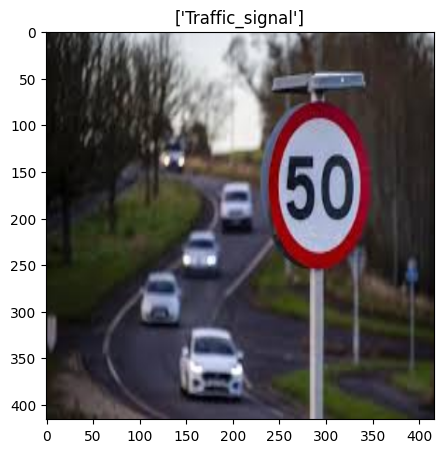

true label:['Attention Please-']


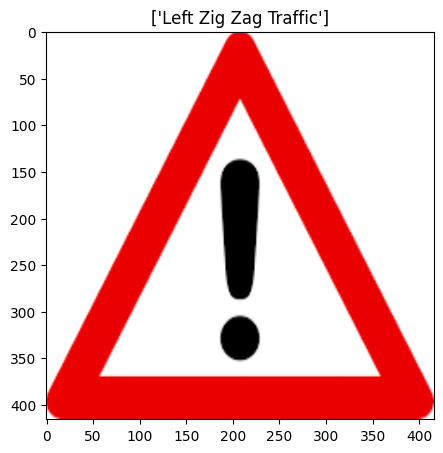

true label:['Attention Please-']


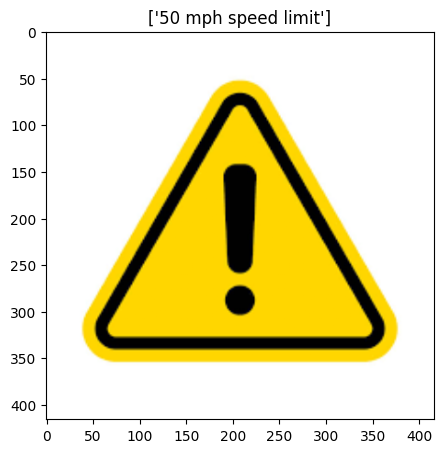

true label:['Attention Please-']


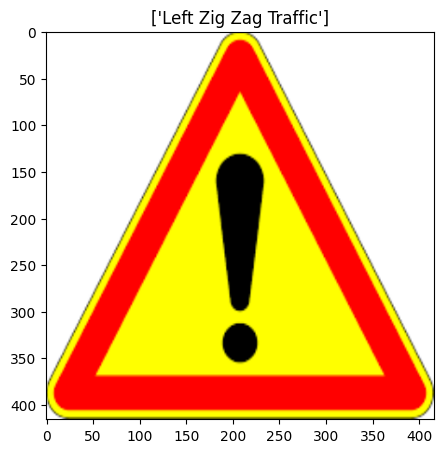

true label:['Attention Please-']


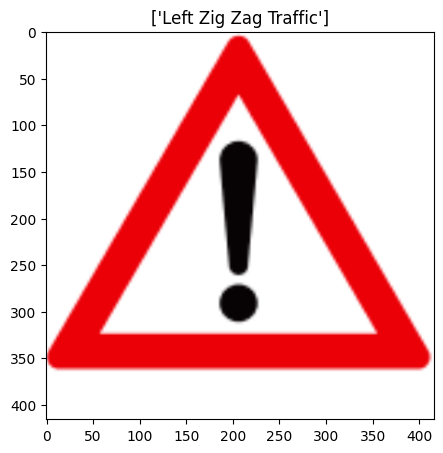

true label:['Attention Please-']


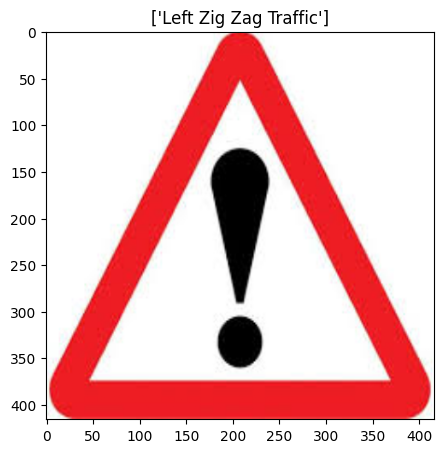

true label:['Beware of children']


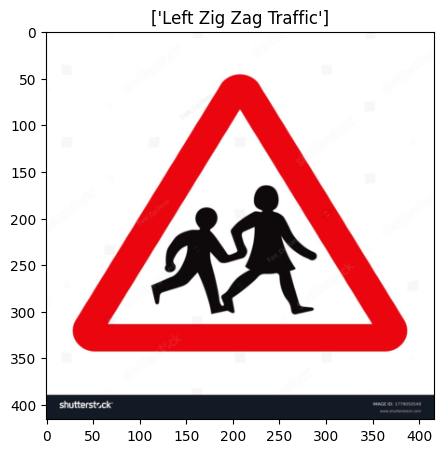

true label:['Beware of children']


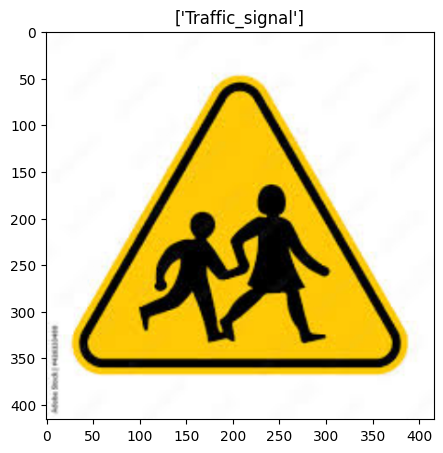

true label:['Beware of children']


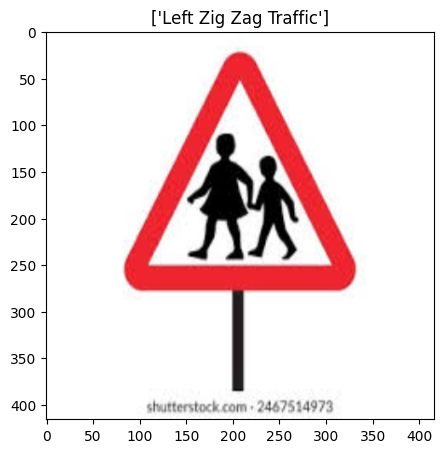

true label:['Beware of children']


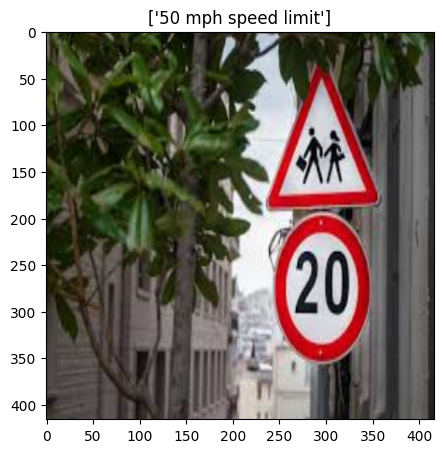

true label:['Beware of children']


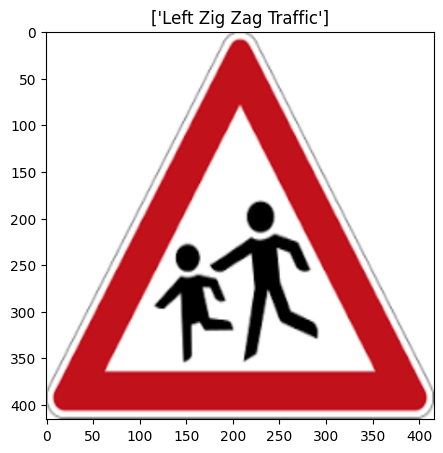

true label:['CYCLE ROUTE AHEAD WARNING']


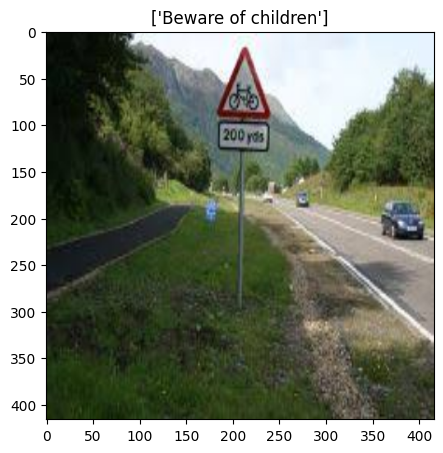

true label:['CYCLE ROUTE AHEAD WARNING']


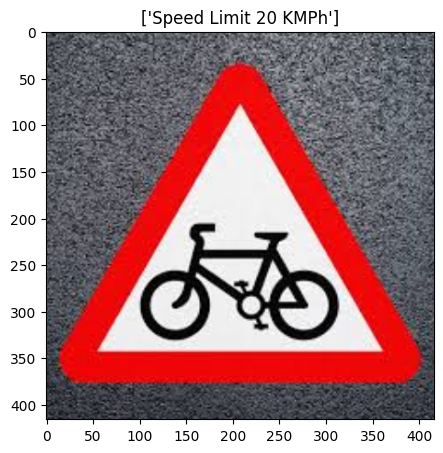

true label:['CYCLE ROUTE AHEAD WARNING']


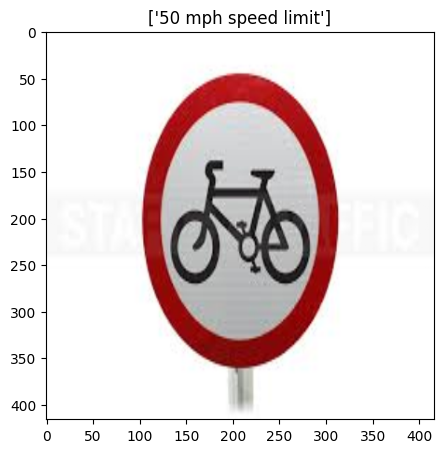

true label:['Dangerous Left Curve Ahead']


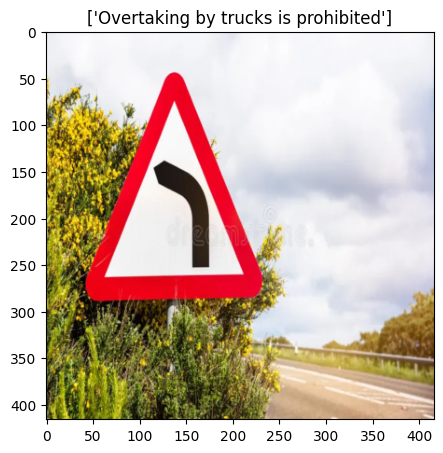

true label:['Dangerous Left Curve Ahead']


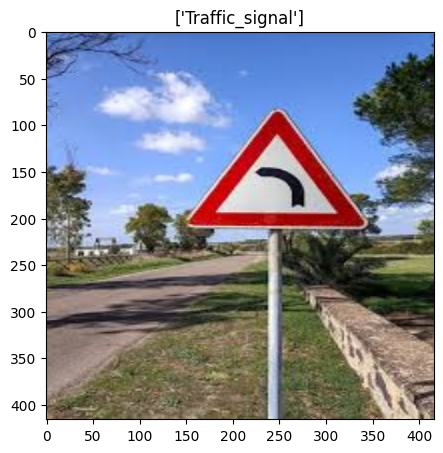

true label:['Dangerous Left Curve Ahead']


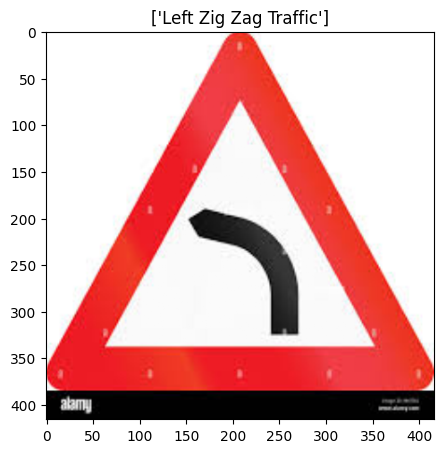

true label:['Dangerous Left Curve Ahead']


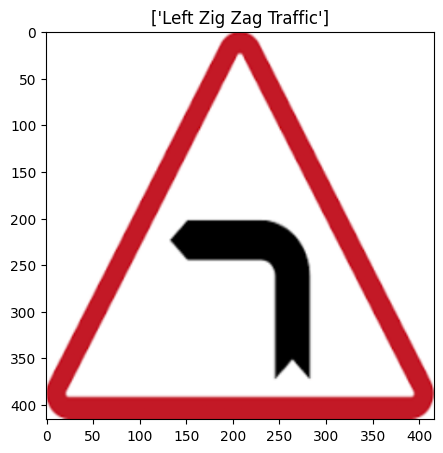

true label:['Dangerous Left Curve Ahead']


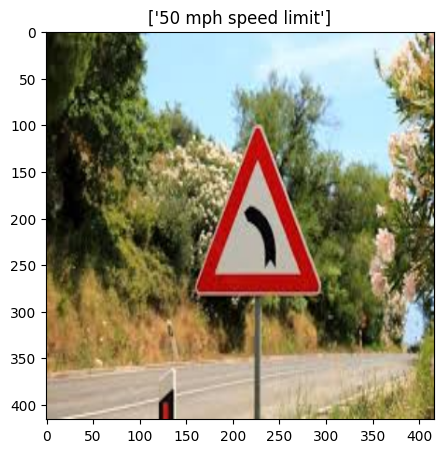

true label:['Dangerous Rright Curve Ahead']


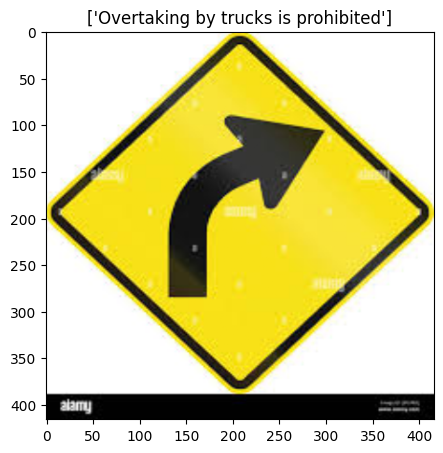

true label:['Dangerous Rright Curve Ahead']


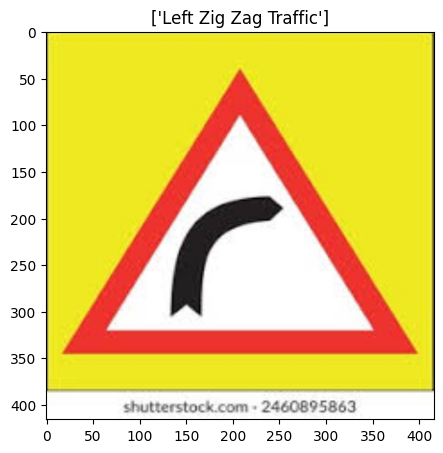

true label:['Dangerous Rright Curve Ahead']


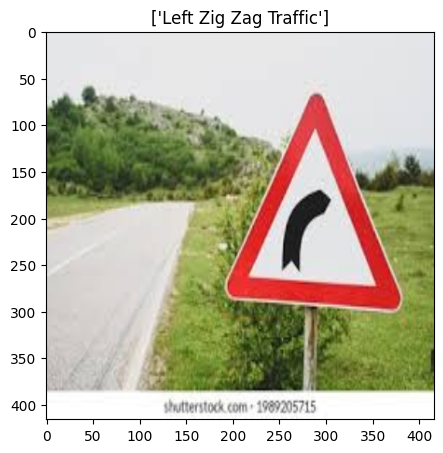

true label:['Dangerous Rright Curve Ahead']


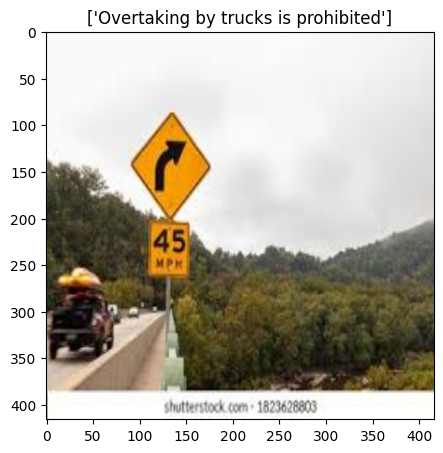

true label:['End of all speed and passing limits']


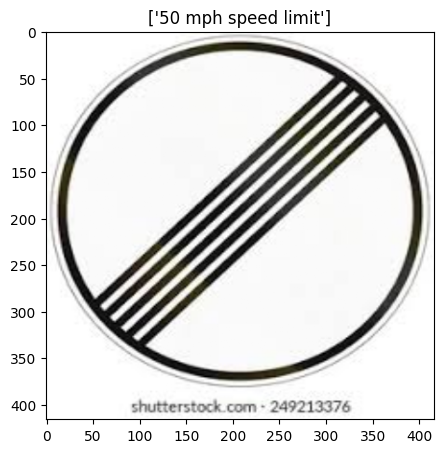

true label:['End of all speed and passing limits']


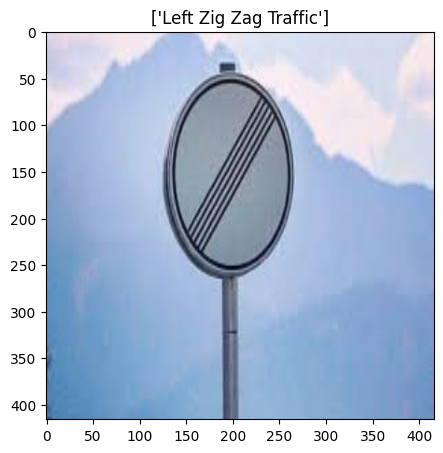

true label:['End of all speed and passing limits']


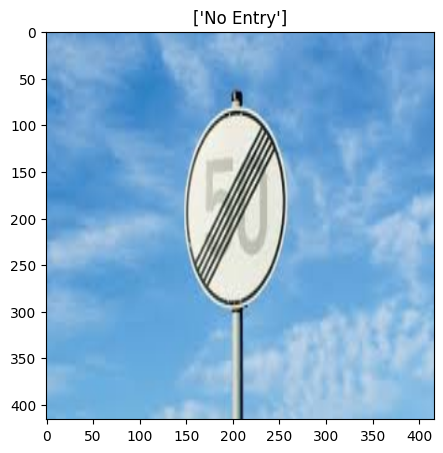

true label:['Give Way']


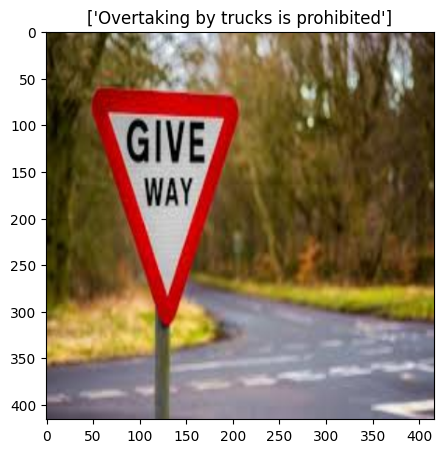

true label:['Give Way']


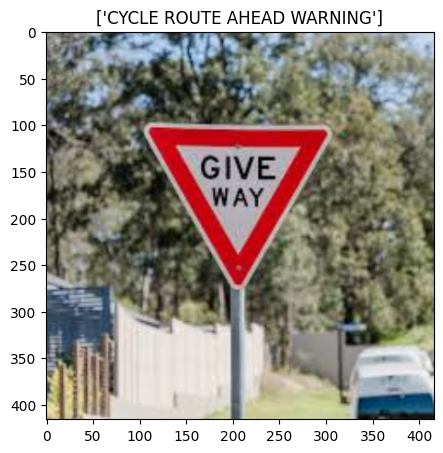

true label:['Give Way']


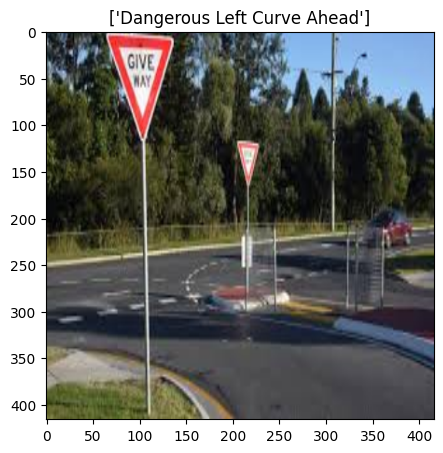

true label:['Give Way']


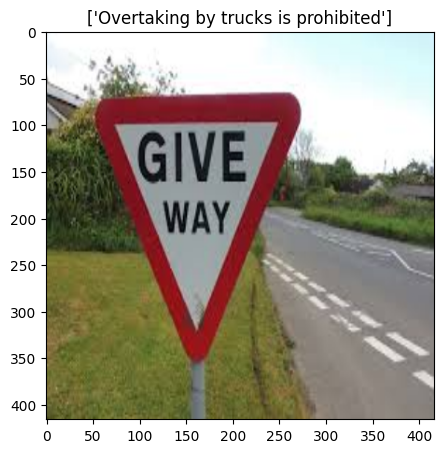

true label:['Give Way']


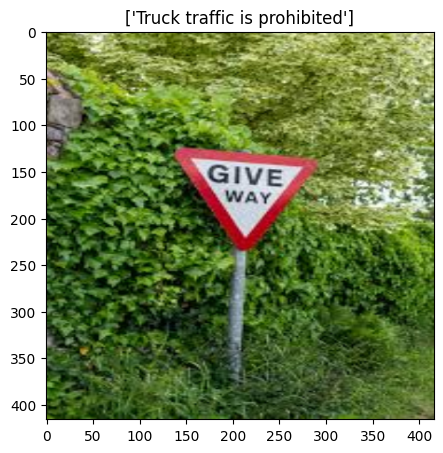

true label:['Give Way']


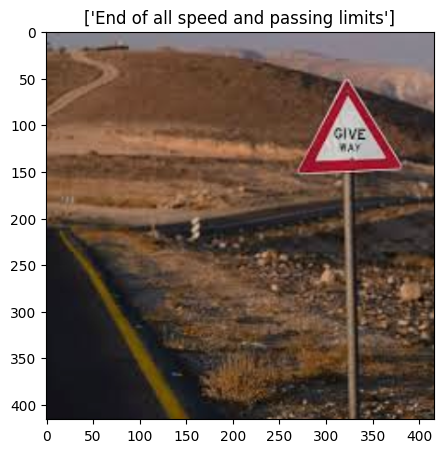

true label:['Go Straight or Turn Right']


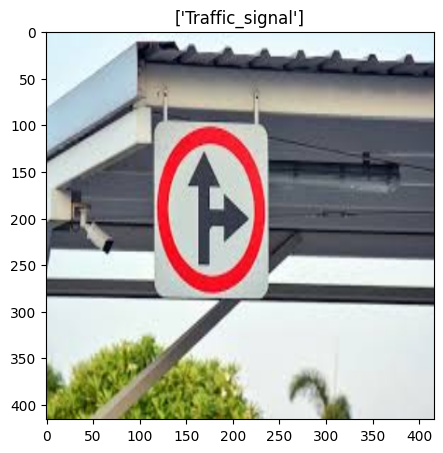

true label:['Go Straight or Turn Right']


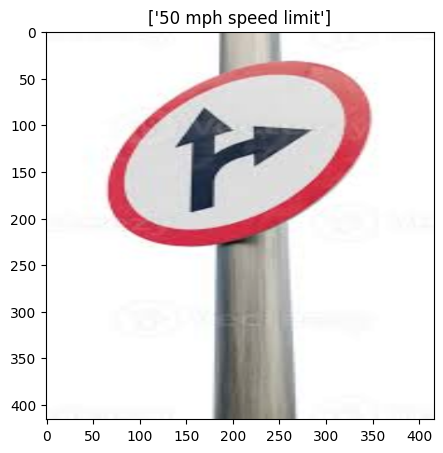

true label:['Go Straight or Turn Right']


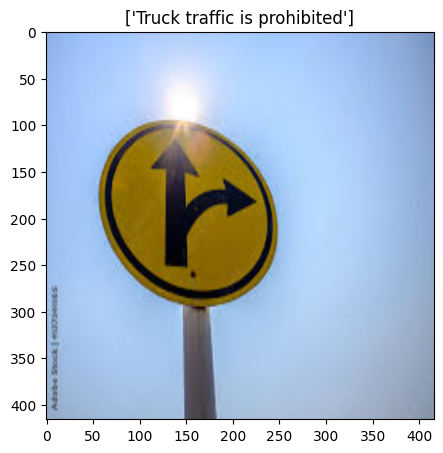

true label:['Go Straight or Turn Right']


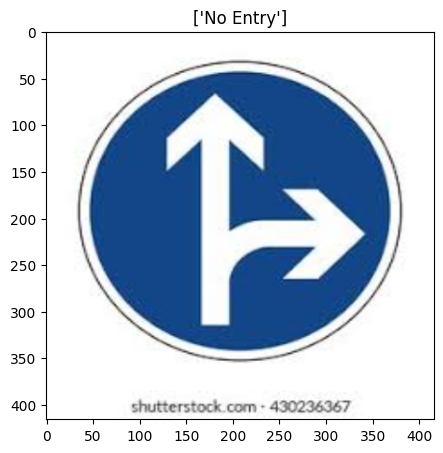

true label:['Go straight or turn left']


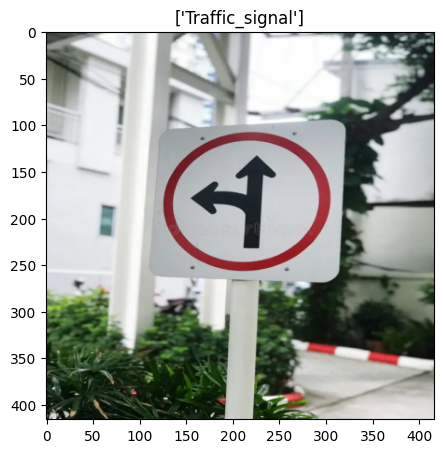

true label:['Go straight or turn left']


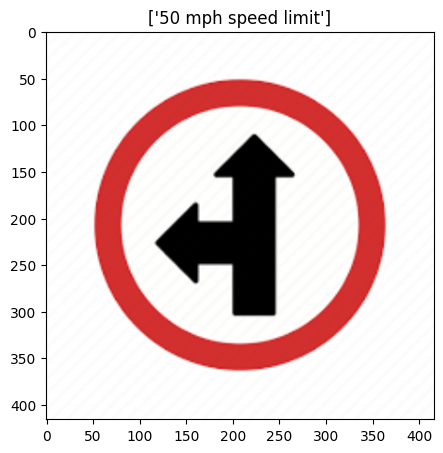

true label:['Go straight or turn left']


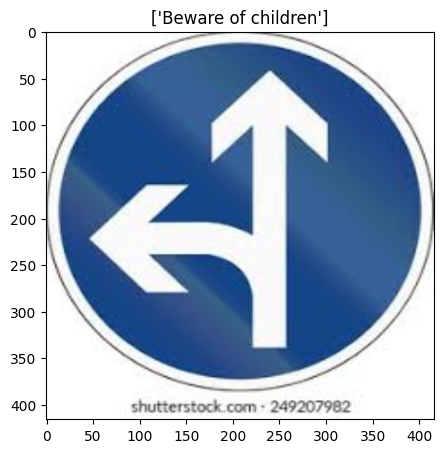

true label:['Keep-Left']


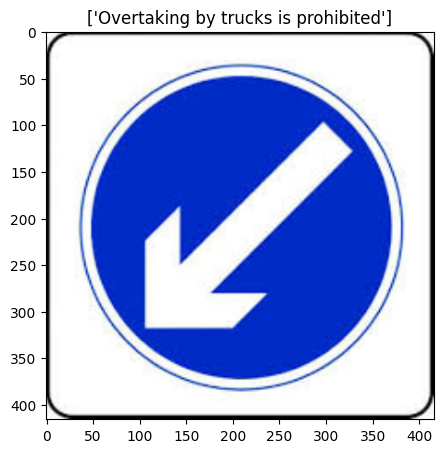

true label:['Keep-Left']


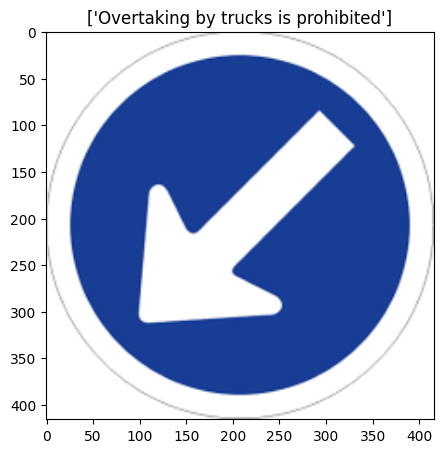

true label:['Keep-Left']


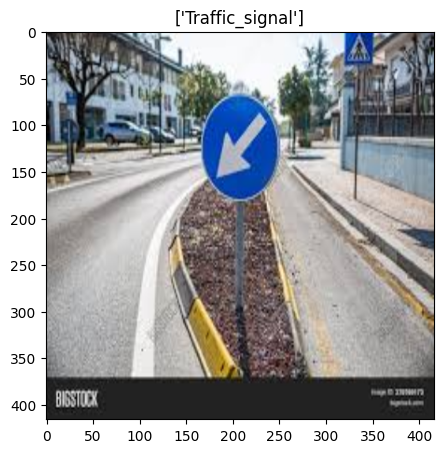

true label:['Keep-Right']


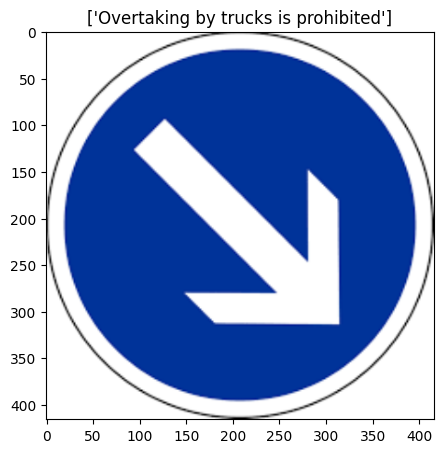

true label:['Keep-Right']


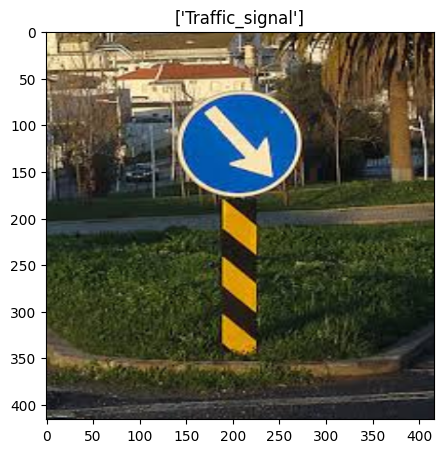

true label:['Keep-Right']


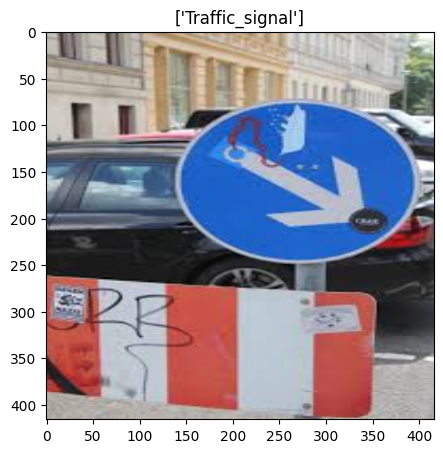

true label:['Keep-Right']


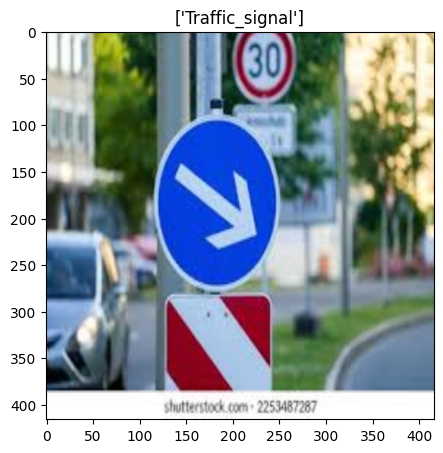

true label:['Keep-Right']


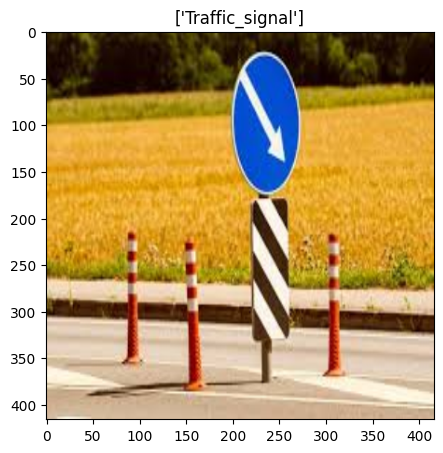

true label:['Left Zig Zag Traffic']


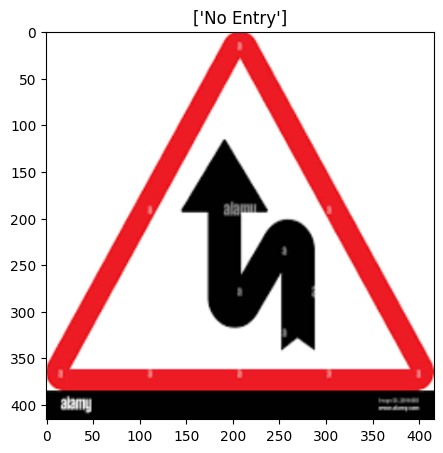

true label:['Left Zig Zag Traffic']


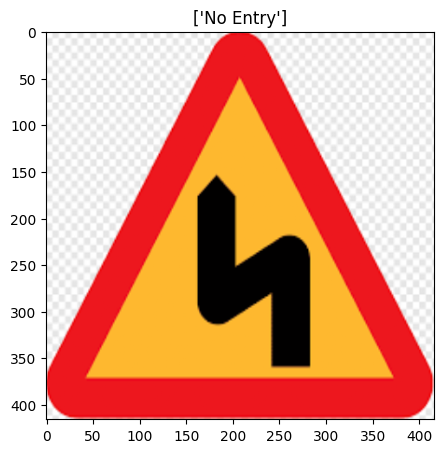

true label:['No Entry']


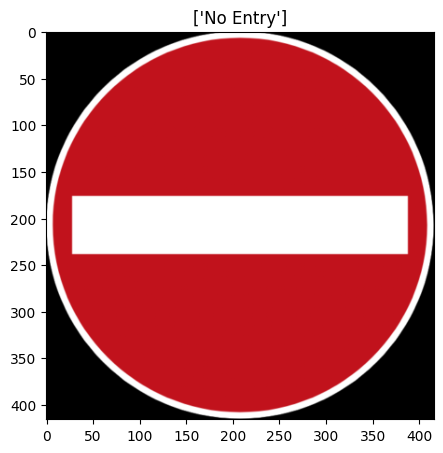

true label:['No Entry']


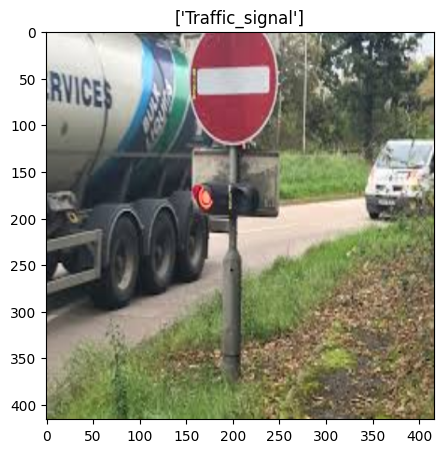

true label:['No Entry']


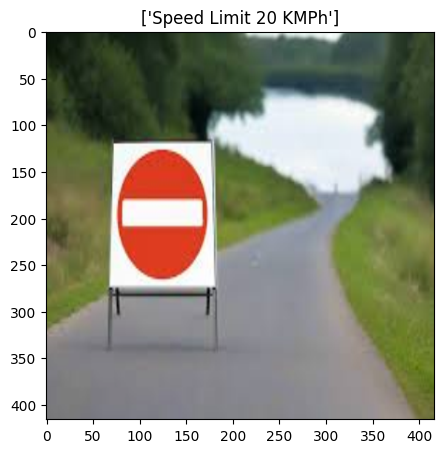

true label:['No Entry']


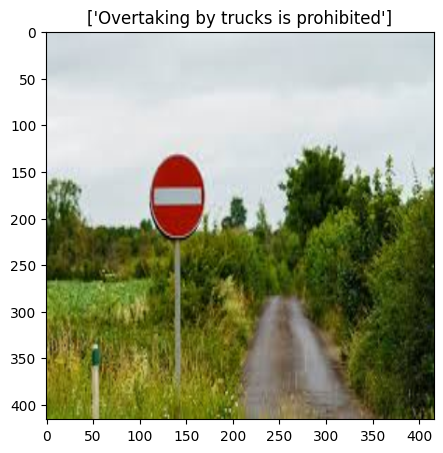

true label:['No Entry']


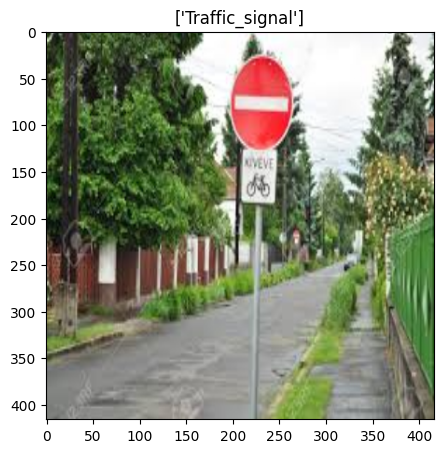

true label:['No Entry']


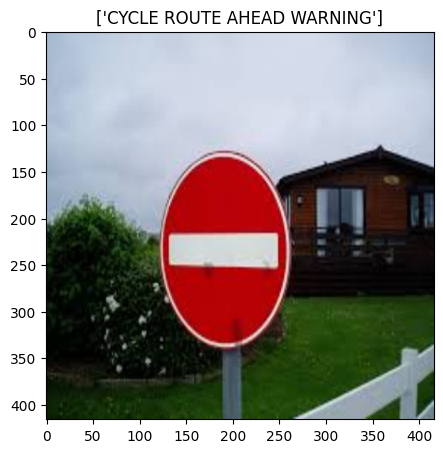

true label:['No Entry']


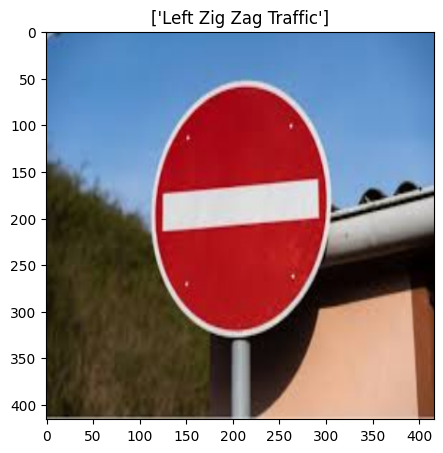

true label:['No_Over_Taking']


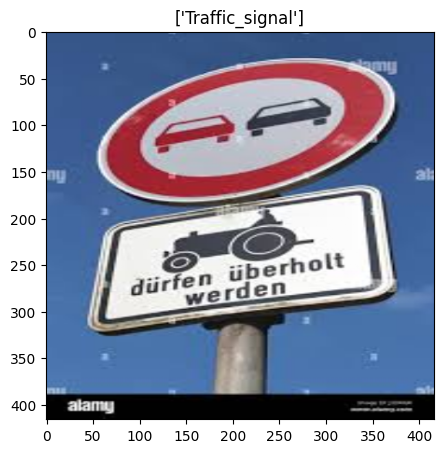

true label:['No_Over_Taking']


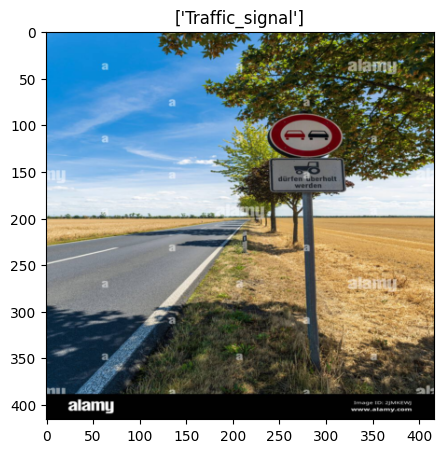

true label:['No_Over_Taking']


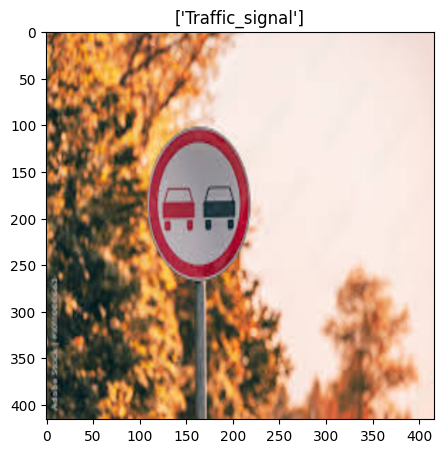

true label:['No_Over_Taking']


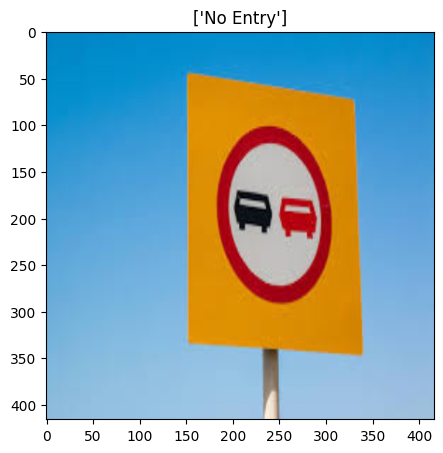

true label:['No_Over_Taking']


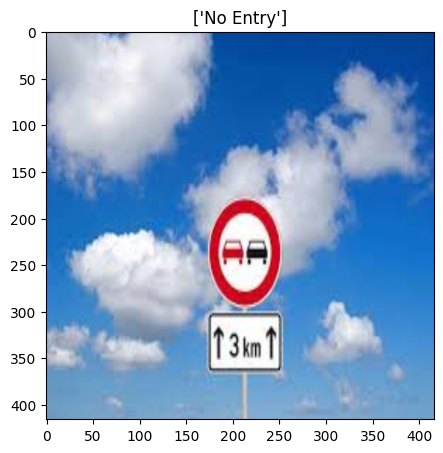

true label:['Overtaking by trucks is prohibited']


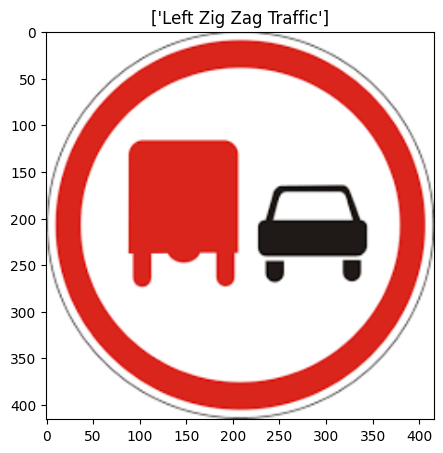

true label:['Overtaking by trucks is prohibited']


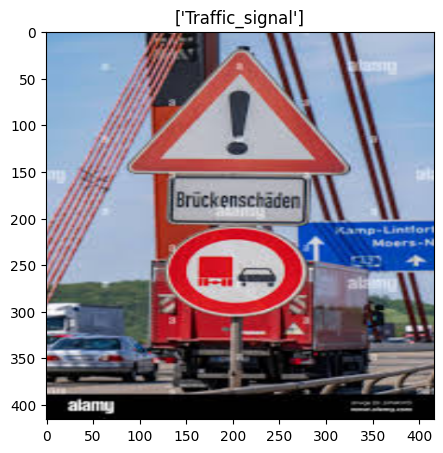

true label:['Pedestrian Crossing']


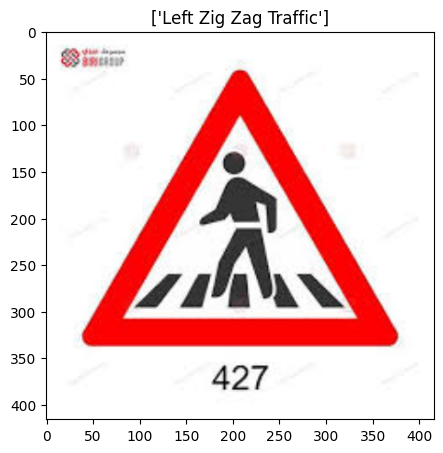

true label:['Pedestrian Crossing']


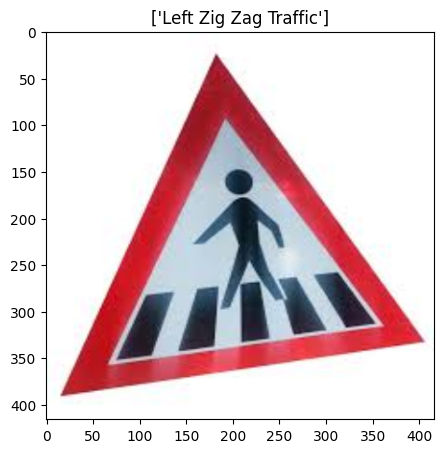

true label:['Pedestrian Crossing']


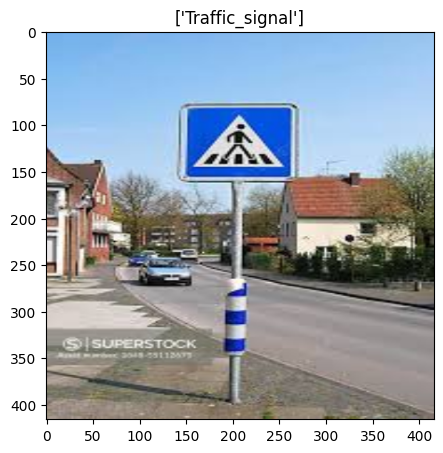

true label:['Pedestrian Crossing']


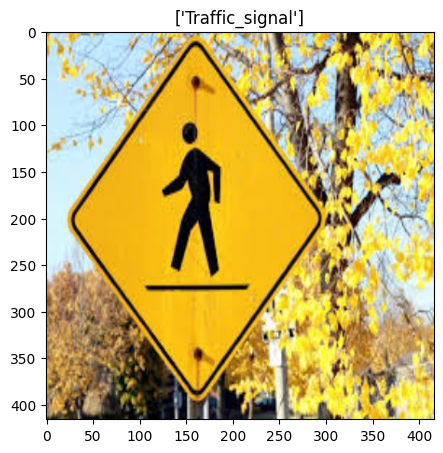

true label:['Pedestrian Crossing']


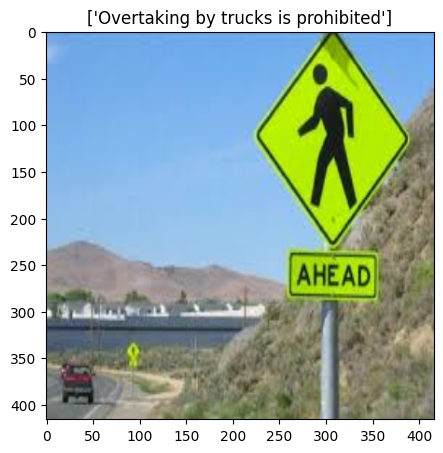

true label:['Round-About']


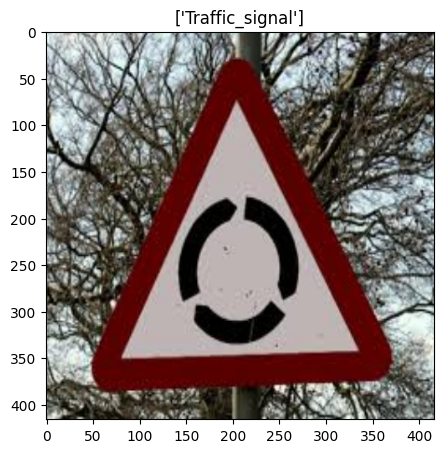

true label:['Round-About']


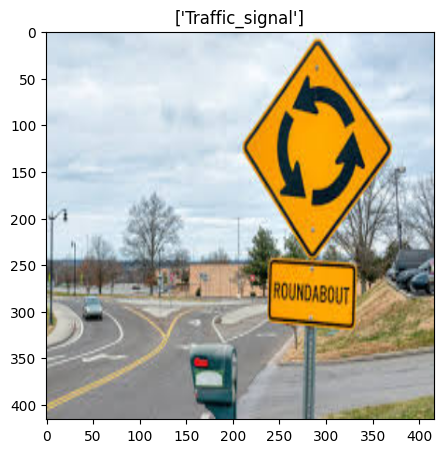

true label:['Round-About']


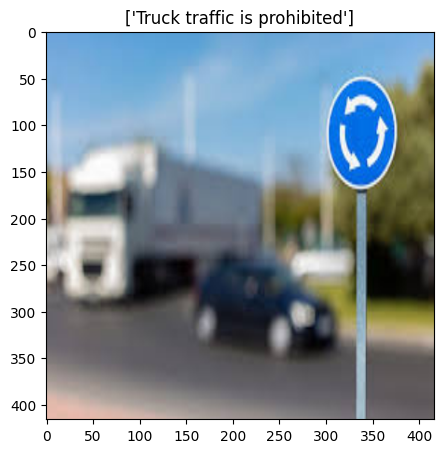

true label:['Round-About']


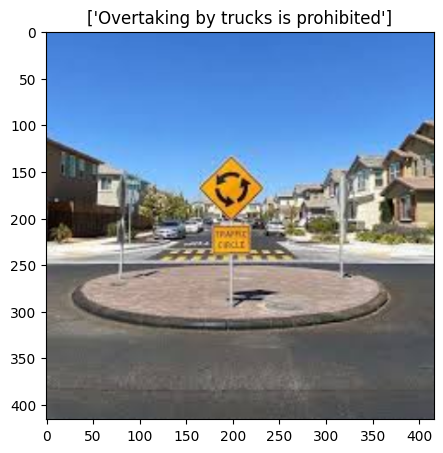

true label:['Round-About']


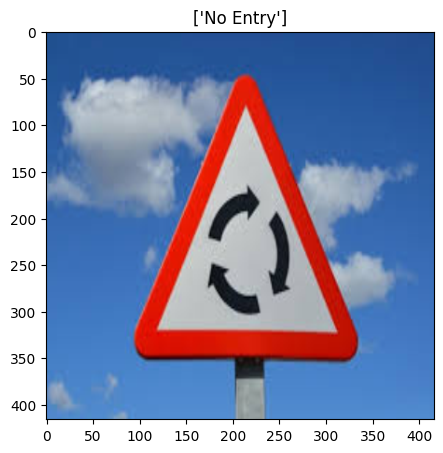

true label:['Round-About']


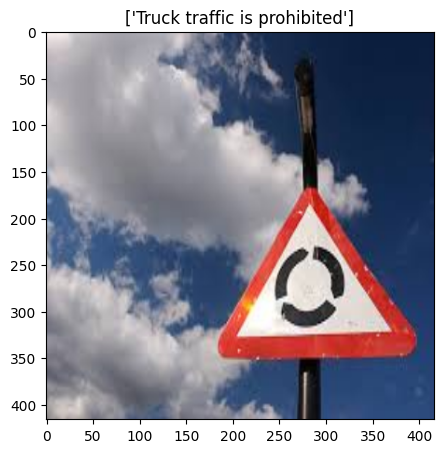

true label:['Round-About']


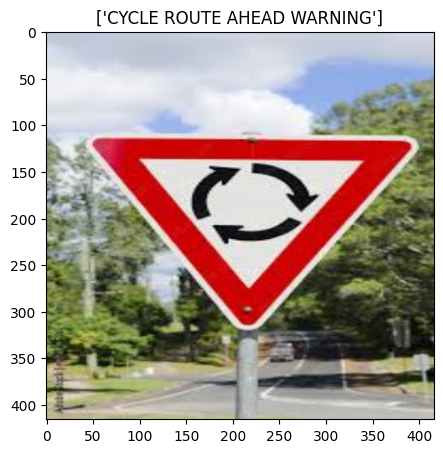

true label:['Slippery Road Ahead']


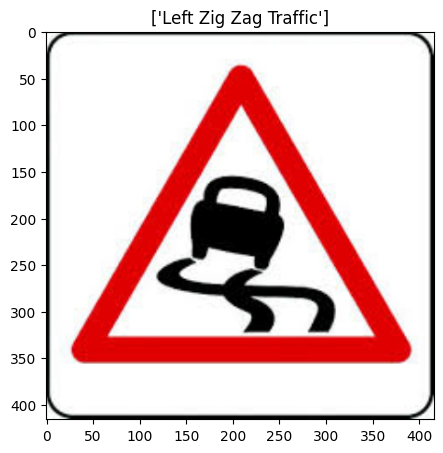

true label:['Slippery Road Ahead']


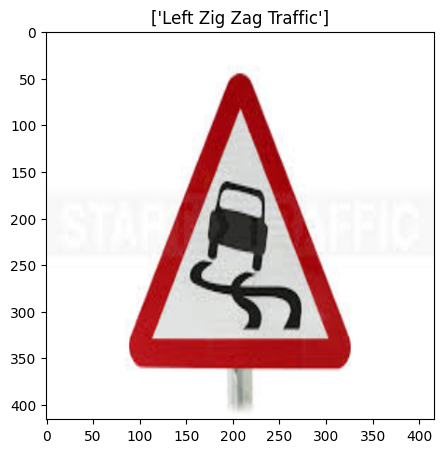

true label:['Slippery Road Ahead']


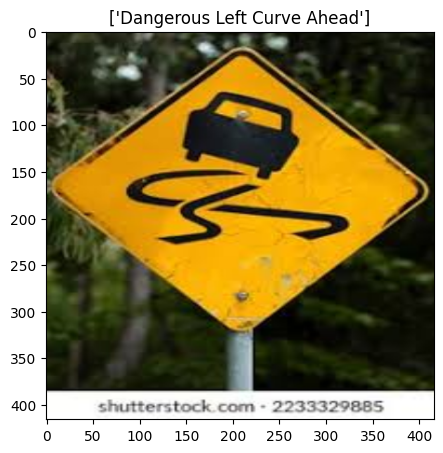

true label:['Slippery Road Ahead']


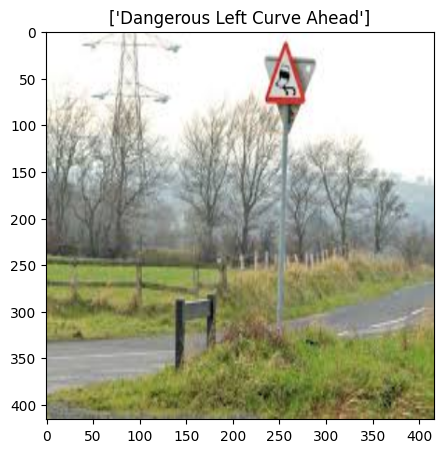

true label:['Slippery Road Ahead']


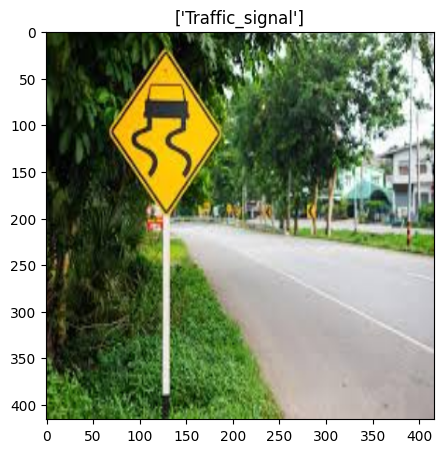

true label:['Slippery Road Ahead']


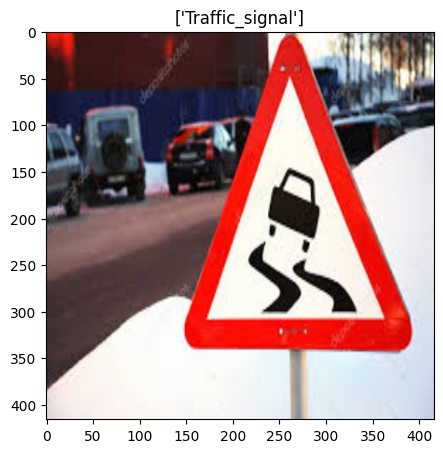

true label:['Slippery Road Ahead']


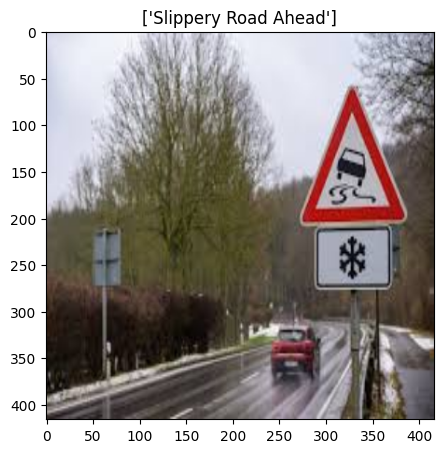

true label:['Speed Limit 20 KMPh']


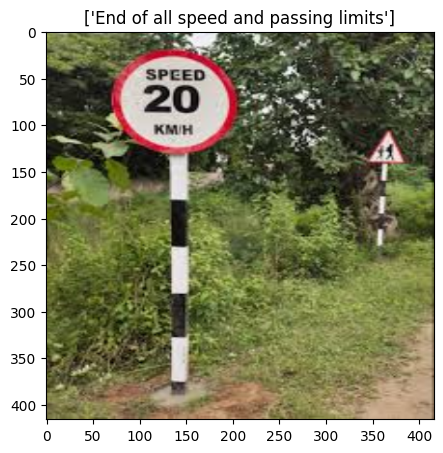

true label:['Speed Limit 20 KMPh']


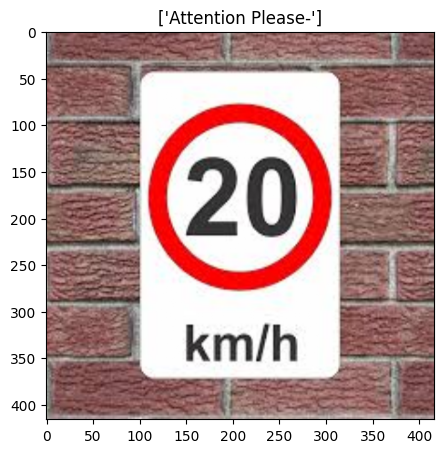

true label:['Speed Limit 20 KMPh']


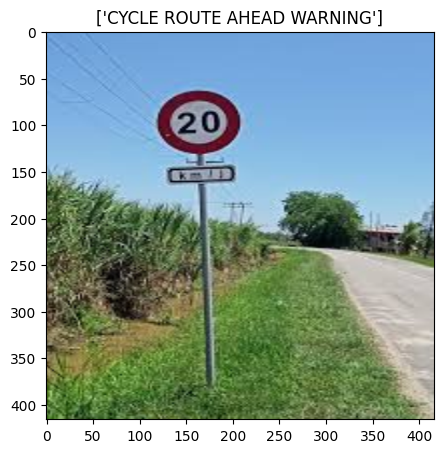

true label:['Speed Limit 20 KMPh']


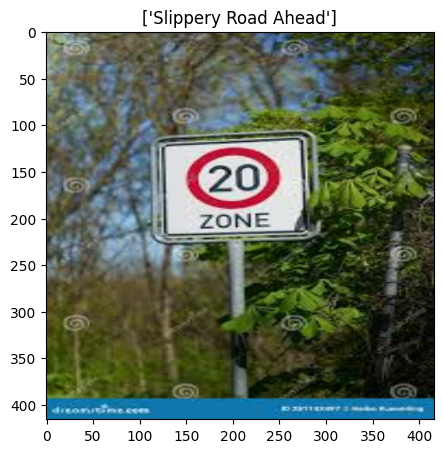

true label:['Speed Limit 20 KMPh']


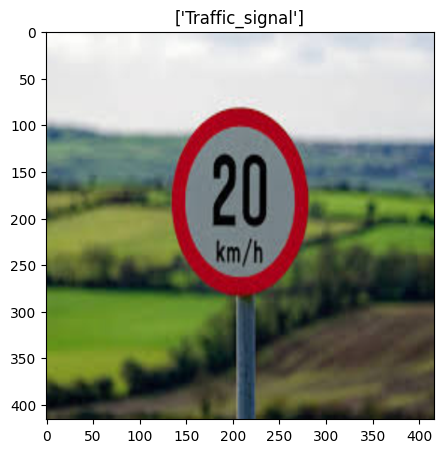

true label:['Speed Limit 20 KMPh']


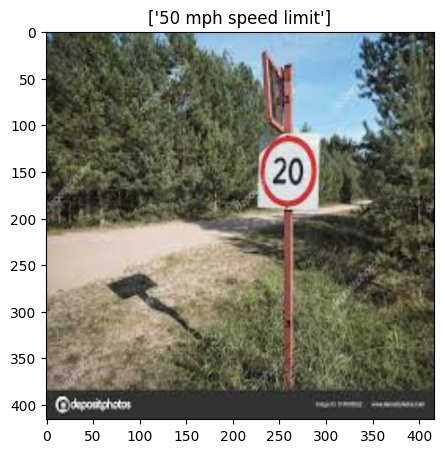

true label:['Speed Limit 20 KMPh']


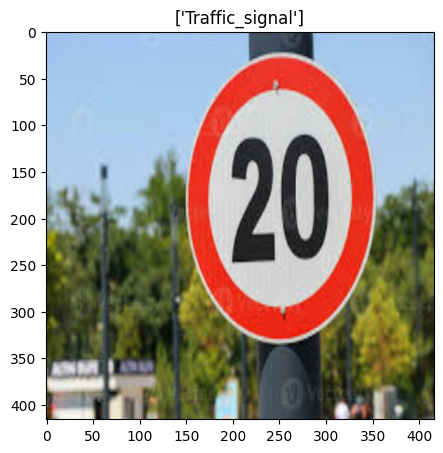

true label:['Speed Limit 30 KMPh']


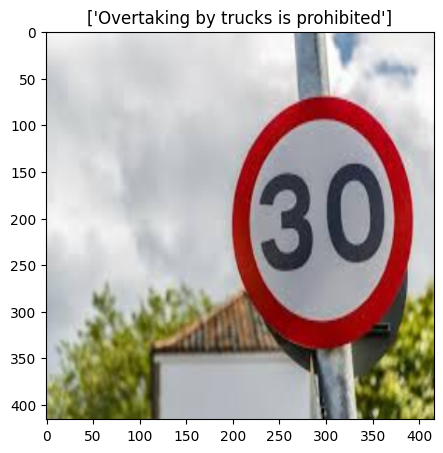

true label:['Speed Limit 30 KMPh']


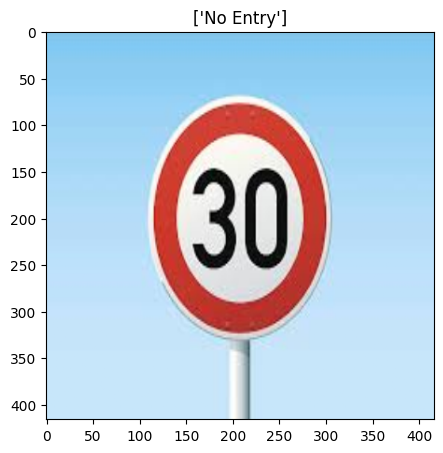

true label:['Speed Limit 30 KMPh']


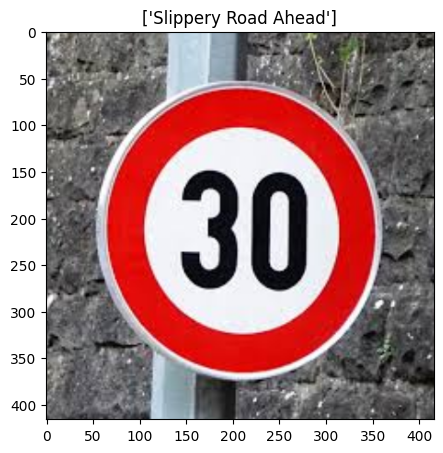

true label:['Speed Limit 30 KMPh']


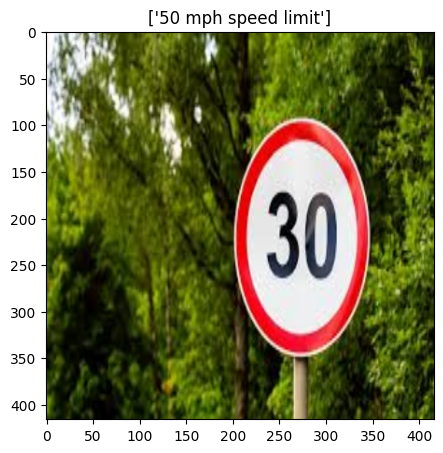

true label:['Stop_Sign']


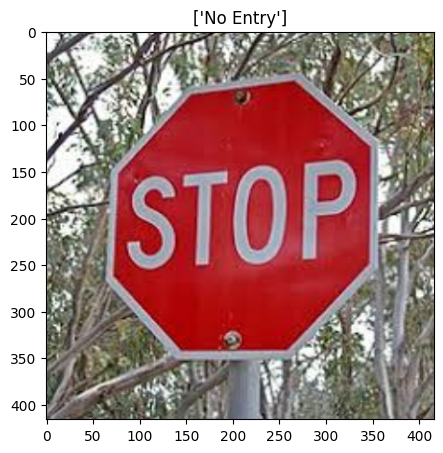

true label:['Stop_Sign']


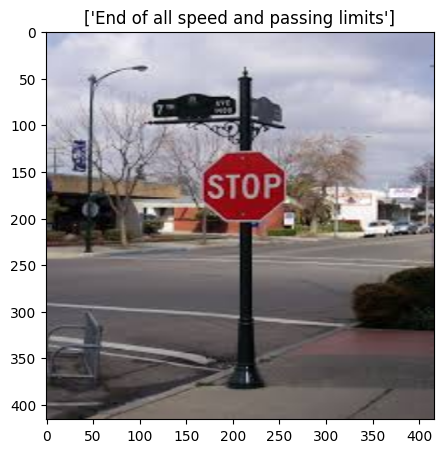

true label:['Stop_Sign']


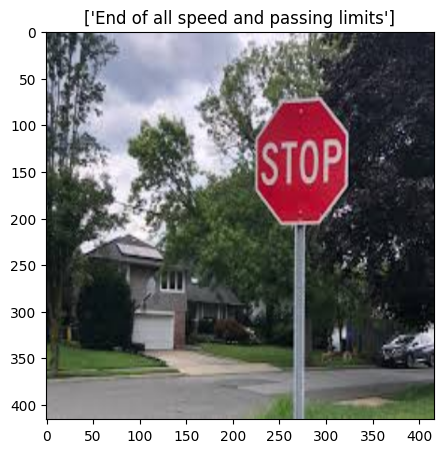

true label:['Stop_Sign']


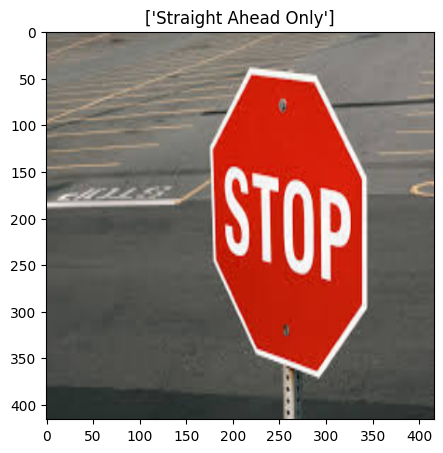

true label:['Stop_Sign']


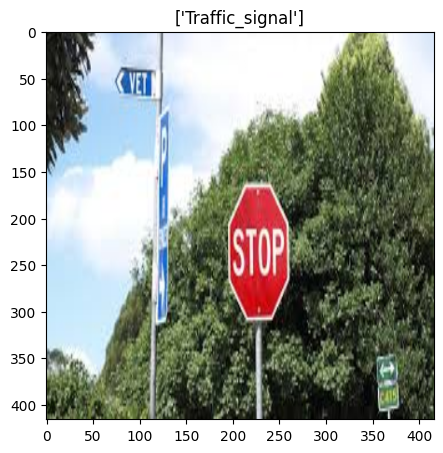

true label:['Stop_Sign']


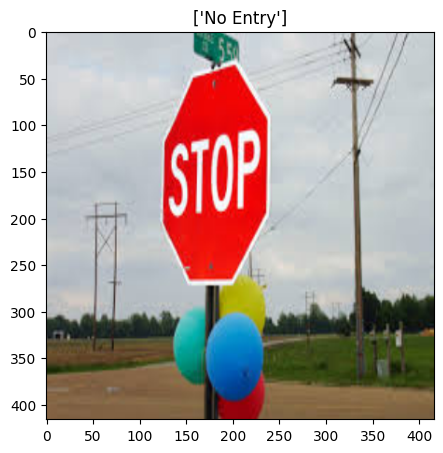

true label:['Straight Ahead Only']


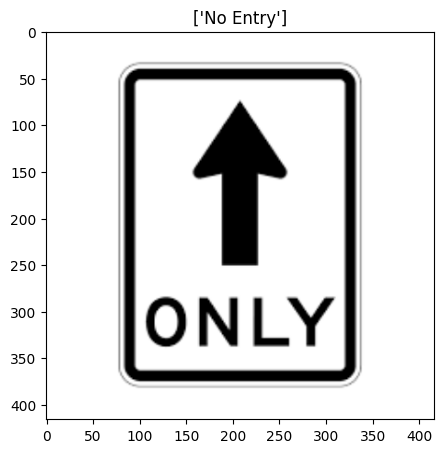

true label:['Straight Ahead Only']


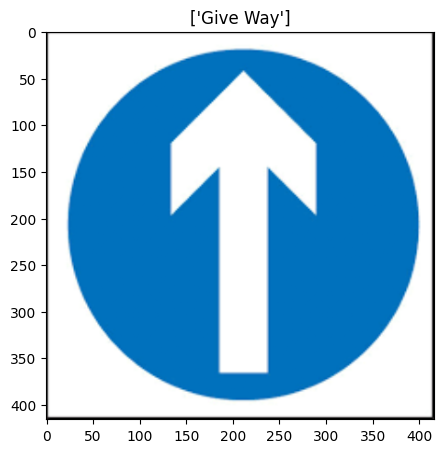

true label:['Straight Ahead Only']


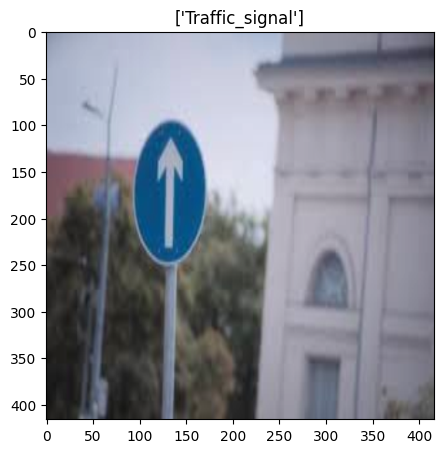

true label:['Traffic_signal']


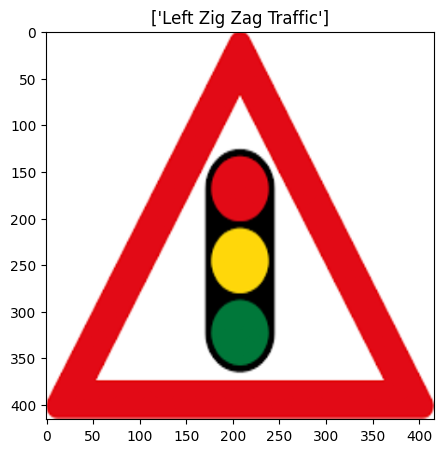

true label:['Traffic_signal']


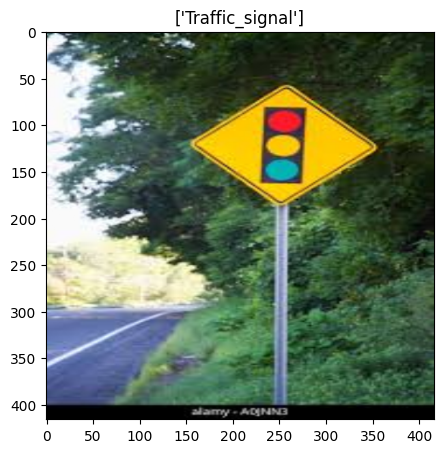

true label:['Traffic_signal']


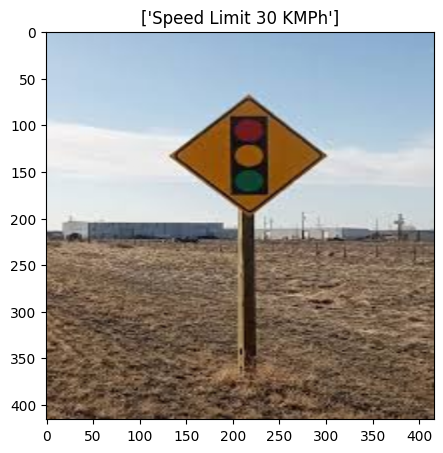

true label:['Truck traffic is prohibited']


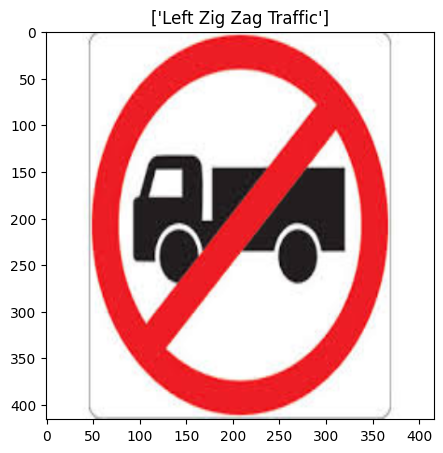

true label:['Truck traffic is prohibited']


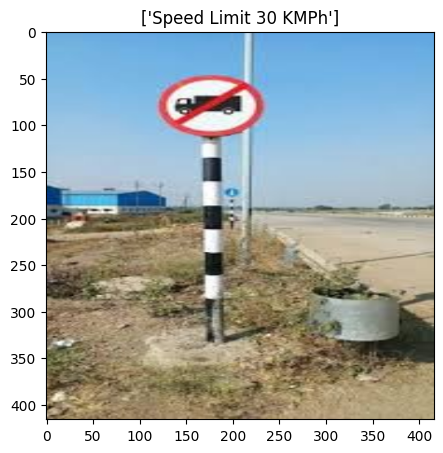

true label:['Truck traffic is prohibited']


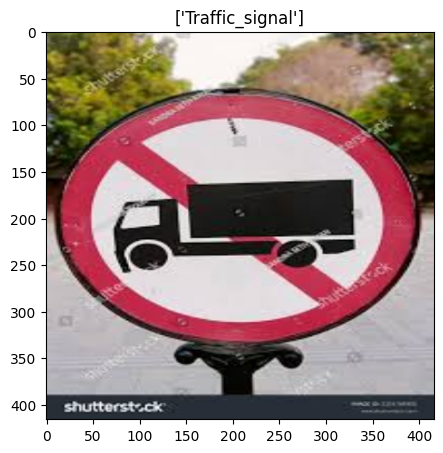

true label:['Turn left ahead']


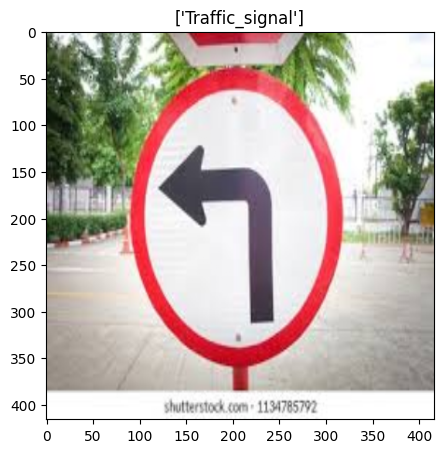

true label:['Turn left ahead']


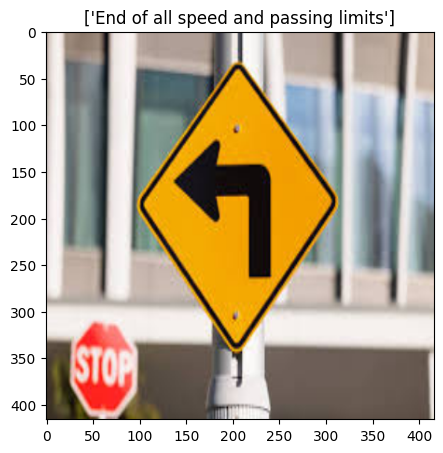

true label:['Turn left ahead']


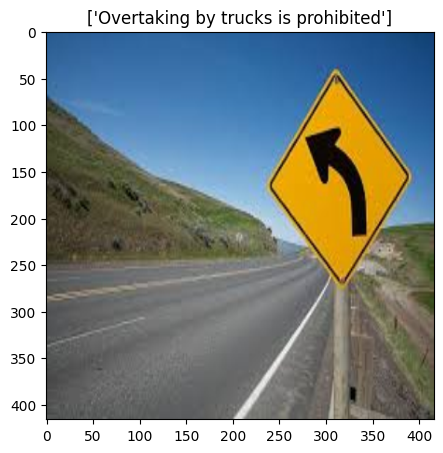

true label:['Turn right ahead']


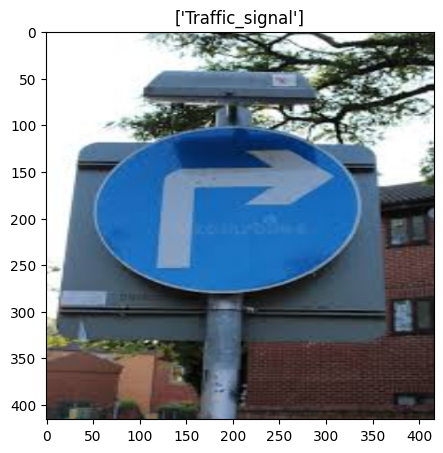

true label:['Turn right ahead']


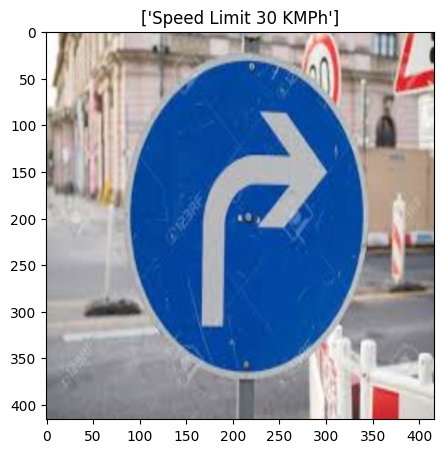

true label:['Turn right ahead']


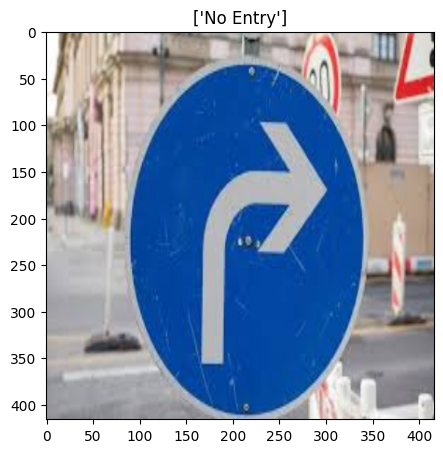

true label:['Uneven Road']


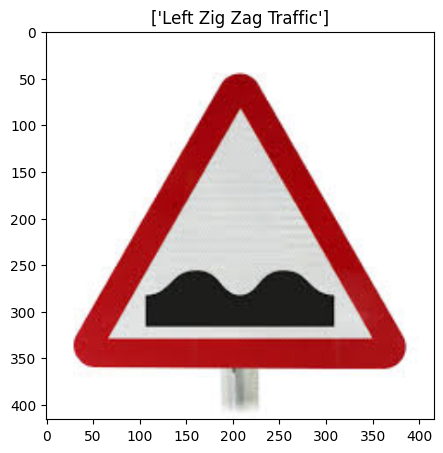

true label:['Uneven Road']


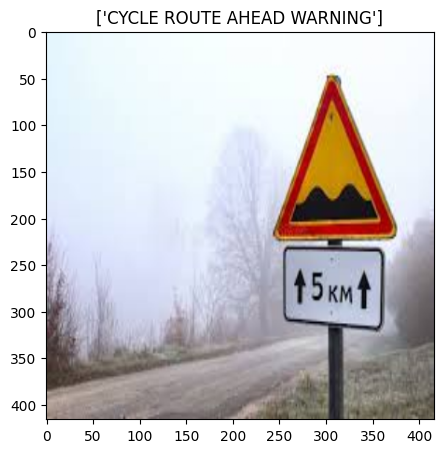

true label:['Uneven Road']


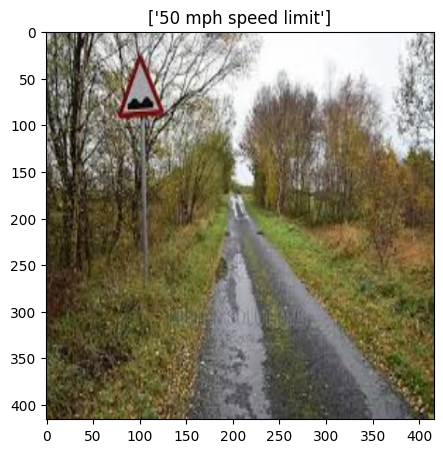

Accuracy of test text: 2.419355 %


In [137]:
print("True Image & Predicted Label")

classify_model.eval()

correct = 0
total = 0

for images, labels in normal_loader:


    outputs = classify_model(images)

    _, pre = torch.max(outputs.data, 1)

    total += 1
    correct += (pre == labels).sum()
    print(f"true label:{[normal_data.classes[i] for i in labels]}")
    #print(f"predicted label:{pre}")

    imshow(torchvision.utils.make_grid(images.cpu().data, normalize=True), [normal_data.classes[i] for i in pre])

print('Accuracy of test text: %f %%' % (100 * float(correct) / total))

Implement Projected Gradient Descent (PGD) here.

In [138]:
import numpy as np
import json

import torch
import torch.nn as nn
import torch.optim as optim
import torch.utils.data as Data

import torchvision.utils
from torchvision import models
import torchvision.datasets as dsets
import torchvision.transforms as transforms

# CW-L2 Attack
# Based on the paper, i.e. not exact same version of the code on https://github.com/carlini/nn_robust_attacks
# (1) Binary search method for c, (2) Optimization on tanh space, (3) Choosing method best l2 adversaries is NOT IN THIS CODE.
def cw_l2_attack(model, images, labels, targeted=False, c=1e-4, kappa=0, max_iter=10, learning_rate=0.01) :



    # Define f-function
    def f(x) :

        outputs = model(x)
        print(labels)
        one_hot_labels = torch.eye(len(outputs[0]))[labels]


        i, _ = torch.max((1-one_hot_labels)*outputs, dim=1)
        j = torch.masked_select(outputs, one_hot_labels.type(torch.bool))

        # If targeted, optimize for making the other class most likely
        if targeted :
            return torch.clamp(i-j, min=-kappa)

        # If untargeted, optimize for making the other class most likely
        else :
            return torch.clamp(j-i, min=-kappa)

    w = torch.zeros_like(images, requires_grad=True)

    optimizer = optim.Adam([w], lr=learning_rate)

    prev = 1e10

    for step in range(max_iter) :

        a = 1/2*(nn.Tanh()(w) + 1)

        loss1 = nn.MSELoss(reduction='sum')(a, images)
        loss2 = torch.sum(c*f(a))

        cost = loss1 + loss2

        optimizer.zero_grad()
        cost.backward()
        optimizer.step()

        # Early Stop when loss does not converge.
        if step % (max_iter//10) == 0 :
            if cost > prev :
                print('Attack Stopped due to CONVERGENCE....')
                return a
            prev = cost

        print('- Learning Progress : %2.2f %%        ' %((step+1)/max_iter*100), end='\r')

    attack_images = 1/2*(nn.Tanh()(w) + 1)

    return attack_images







In [141]:
def get_yolo_output(model, image):
    results = model(image)
    return results[0].boxes.xyxy, results[0].boxes.conf, results[0].boxes.cls


Attack Image & Predicted Label
original prediction

0: 416x416 1 Dangerous Rright Curve Ahead, 251.2ms
Speed: 0.0ms preprocess, 251.2ms inference, 3.7ms postprocess per image at shape (1, 3, 416, 416)
tensor([0])
tensor([0])
tensor([0])
tensor([0])
tensor([0])
tensor([0])
tensor([0])
tensor([0])
tensor([0])
tensor([0])
prediction after attack

0: 416x416 1 -Road narrows on right, 250.8ms
Speed: 0.0ms preprocess, 250.8ms inference, 3.2ms postprocess per image at shape (1, 3, 416, 416)


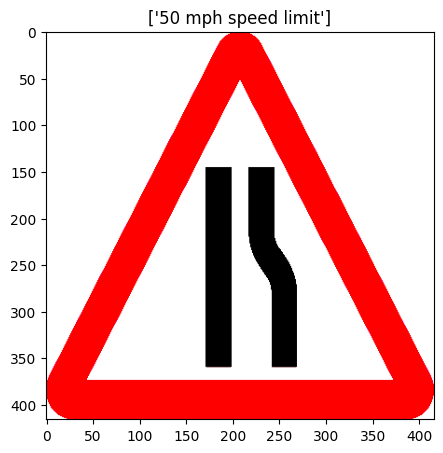

original prediction

0: 416x416 1 -Road narrows on right, 253.9ms
Speed: 0.0ms preprocess, 253.9ms inference, 3.3ms postprocess per image at shape (1, 3, 416, 416)
tensor([0])
tensor([0])
tensor([0])
tensor([0])
tensor([0])
tensor([0])
tensor([0])
tensor([0])
tensor([0])
tensor([0])
prediction after attack

0: 416x416 1 -Road narrows on right, 390.8ms
Speed: 0.0ms preprocess, 390.8ms inference, 4.2ms postprocess per image at shape (1, 3, 416, 416)


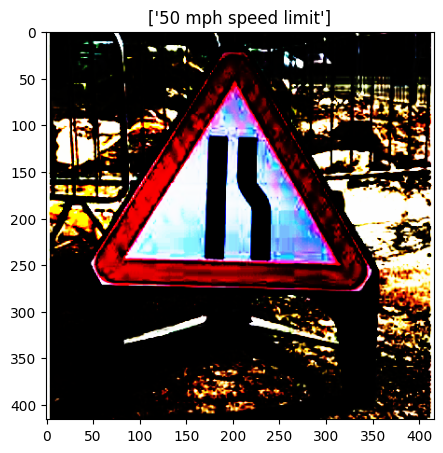

original prediction

0: 416x416 1 -Road narrows on right, 417.0ms
Speed: 0.0ms preprocess, 417.0ms inference, 4.3ms postprocess per image at shape (1, 3, 416, 416)
tensor([0])
tensor([0])
tensor([0])
tensor([0])
tensor([0])
tensor([0])
tensor([0])
tensor([0])
tensor([0])
tensor([0])
prediction after attack

0: 416x416 1 -Road narrows on right, 248.4ms
Speed: 0.0ms preprocess, 248.4ms inference, 3.0ms postprocess per image at shape (1, 3, 416, 416)


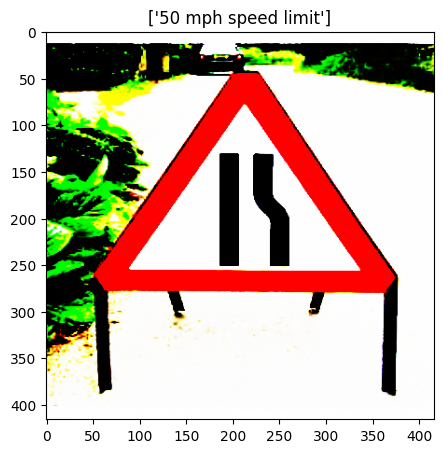

original prediction

0: 416x416 (no detections), 267.6ms
Speed: 0.0ms preprocess, 267.6ms inference, 2.7ms postprocess per image at shape (1, 3, 416, 416)
tensor([0])
tensor([0])
tensor([0])
tensor([0])
tensor([0])
tensor([0])
tensor([0])
tensor([0])
tensor([0])
tensor([0])
prediction after attack

0: 416x416 1 -Road narrows on right, 241.5ms
Speed: 0.0ms preprocess, 241.5ms inference, 3.4ms postprocess per image at shape (1, 3, 416, 416)


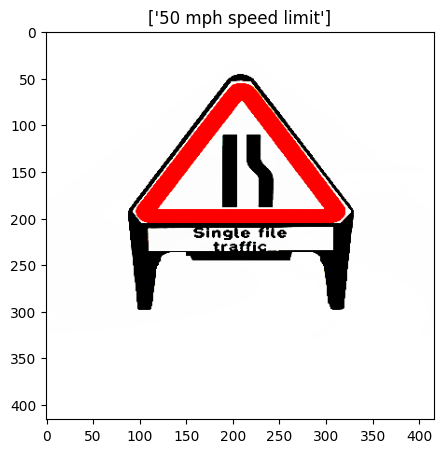

original prediction

0: 416x416 1 Truck traffic is prohibited, 253.0ms
Speed: 0.0ms preprocess, 253.0ms inference, 3.1ms postprocess per image at shape (1, 3, 416, 416)
tensor([1])
tensor([1])
tensor([1])
tensor([1])
tensor([1])
tensor([1])
tensor([1])
tensor([1])
tensor([1])
tensor([1])
prediction after attack

0: 416x416 1 50 mph speed limit, 410.3ms
Speed: 0.0ms preprocess, 410.3ms inference, 4.0ms postprocess per image at shape (1, 3, 416, 416)


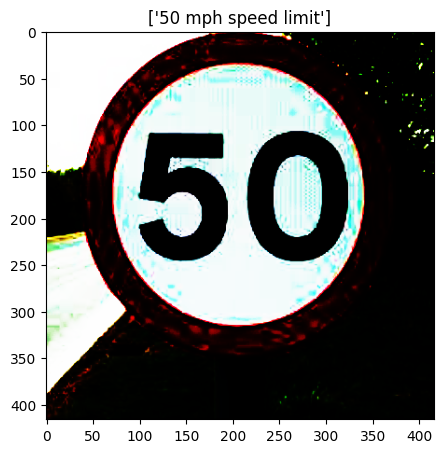

original prediction

0: 416x416 2 Stop_Signs, 3 Traffic_signals, 389.7ms
Speed: 0.0ms preprocess, 389.7ms inference, 4.2ms postprocess per image at shape (1, 3, 416, 416)
tensor([1])
tensor([1])
tensor([1])
tensor([1])
tensor([1])
tensor([1])
tensor([1])
tensor([1])
tensor([1])
tensor([1])
prediction after attack

0: 416x416 1 Traffic_signal, 256.2ms
Speed: 0.0ms preprocess, 256.2ms inference, 3.1ms postprocess per image at shape (1, 3, 416, 416)


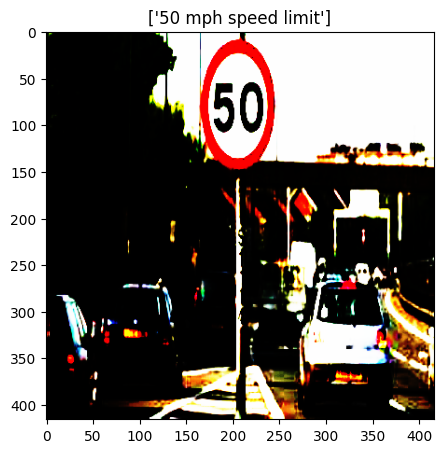

original prediction

0: 416x416 1 Stop_Sign, 249.9ms
Speed: 0.0ms preprocess, 249.9ms inference, 3.1ms postprocess per image at shape (1, 3, 416, 416)
tensor([1])
tensor([1])
tensor([1])
tensor([1])
tensor([1])
tensor([1])
tensor([1])
tensor([1])
tensor([1])
tensor([1])
prediction after attack

0: 416x416 1 50 mph speed limit, 264.6ms
Speed: 0.0ms preprocess, 264.6ms inference, 3.1ms postprocess per image at shape (1, 3, 416, 416)


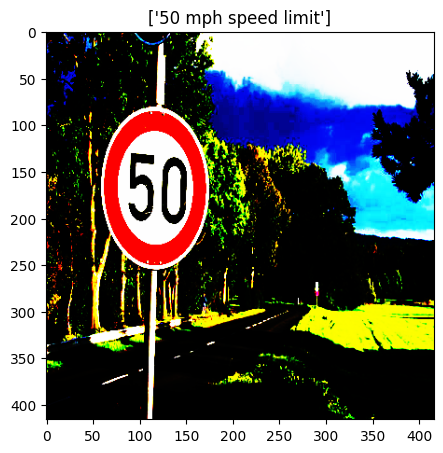

original prediction

0: 416x416 (no detections), 252.9ms
Speed: 0.0ms preprocess, 252.9ms inference, 3.8ms postprocess per image at shape (1, 3, 416, 416)
tensor([1])
tensor([1])
tensor([1])
tensor([1])
tensor([1])
tensor([1])
tensor([1])
tensor([1])
tensor([1])
tensor([1])
prediction after attack

0: 416x416 (no detections), 240.1ms
Speed: 0.0ms preprocess, 240.1ms inference, 2.8ms postprocess per image at shape (1, 3, 416, 416)


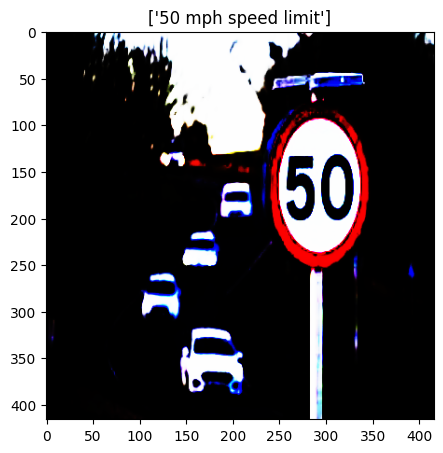

original prediction

0: 416x416 1 Attention Please-, 272.0ms
Speed: 0.0ms preprocess, 272.0ms inference, 3.2ms postprocess per image at shape (1, 3, 416, 416)
tensor([2])
tensor([2])
tensor([2])
tensor([2])
tensor([2])
tensor([2])
tensor([2])
tensor([2])
tensor([2])
tensor([2])
prediction after attack

0: 416x416 1 Attention Please-, 382.3ms
Speed: 0.0ms preprocess, 382.3ms inference, 4.7ms postprocess per image at shape (1, 3, 416, 416)


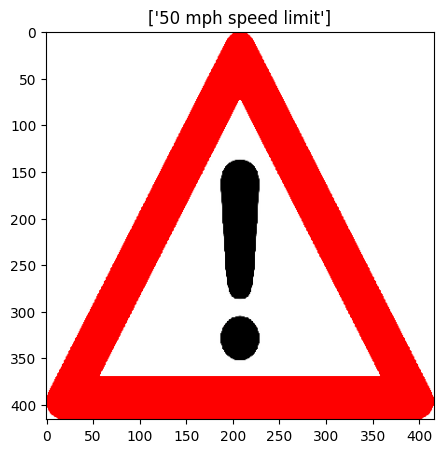

original prediction

0: 416x416 (no detections), 387.2ms
Speed: 0.0ms preprocess, 387.2ms inference, 4.2ms postprocess per image at shape (1, 3, 416, 416)
tensor([2])
tensor([2])
tensor([2])
tensor([2])
tensor([2])
tensor([2])
tensor([2])
tensor([2])
tensor([2])
tensor([2])
prediction after attack

0: 416x416 1 Attention Please-, 251.7ms
Speed: 0.0ms preprocess, 251.7ms inference, 3.0ms postprocess per image at shape (1, 3, 416, 416)


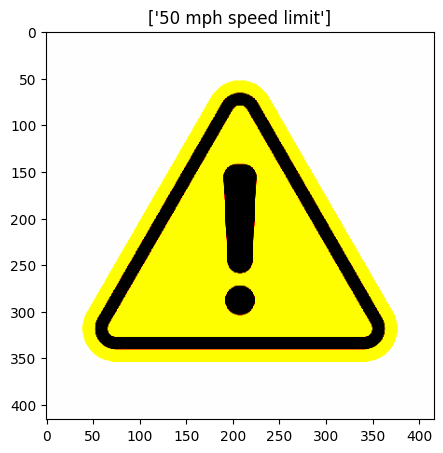

original prediction

0: 416x416 1 Dangerous Rright Curve Ahead, 252.7ms
Speed: 0.0ms preprocess, 252.7ms inference, 3.5ms postprocess per image at shape (1, 3, 416, 416)
tensor([2])
tensor([2])
tensor([2])
tensor([2])
tensor([2])
tensor([2])
tensor([2])
tensor([2])
tensor([2])
tensor([2])
prediction after attack

0: 416x416 1 Attention Please-, 260.3ms
Speed: 0.9ms preprocess, 260.3ms inference, 3.1ms postprocess per image at shape (1, 3, 416, 416)


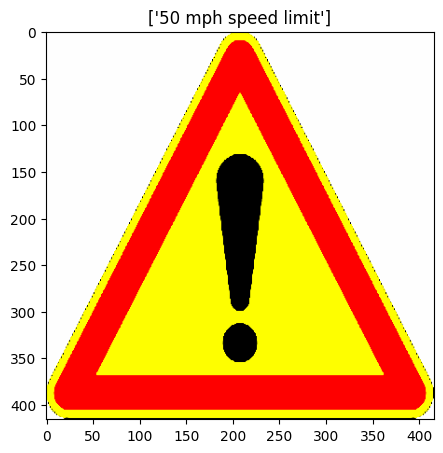

original prediction

0: 416x416 1 Attention Please-, 269.2ms
Speed: 0.0ms preprocess, 269.2ms inference, 3.2ms postprocess per image at shape (1, 3, 416, 416)
tensor([2])
tensor([2])
tensor([2])
tensor([2])
tensor([2])
tensor([2])
tensor([2])
tensor([2])
tensor([2])
tensor([2])
prediction after attack

0: 416x416 1 Attention Please-, 376.9ms
Speed: 0.0ms preprocess, 376.9ms inference, 4.8ms postprocess per image at shape (1, 3, 416, 416)


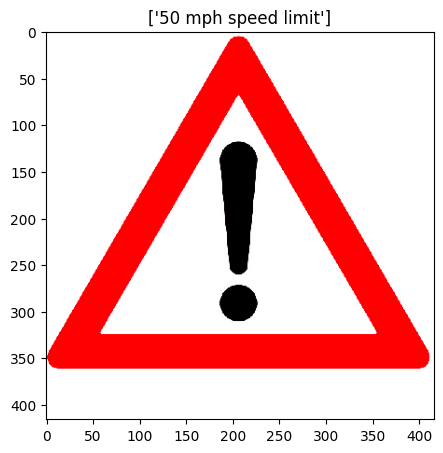

original prediction

0: 416x416 1 Attention Please-, 386.2ms
Speed: 0.0ms preprocess, 386.2ms inference, 4.2ms postprocess per image at shape (1, 3, 416, 416)
tensor([2])
tensor([2])
tensor([2])
tensor([2])
tensor([2])
tensor([2])
tensor([2])
tensor([2])
tensor([2])
tensor([2])
prediction after attack

0: 416x416 1 Attention Please-, 243.1ms
Speed: 0.0ms preprocess, 243.1ms inference, 3.0ms postprocess per image at shape (1, 3, 416, 416)


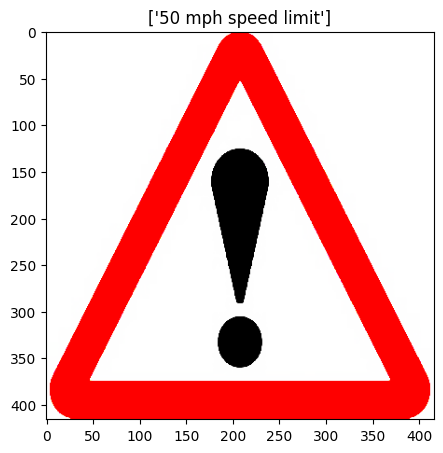

original prediction

0: 416x416 1 Dangerous Rright Curve Ahead, 260.4ms
Speed: 0.0ms preprocess, 260.4ms inference, 3.1ms postprocess per image at shape (1, 3, 416, 416)
tensor([3])
tensor([3])
tensor([3])
tensor([3])
tensor([3])
tensor([3])
tensor([3])
tensor([3])
tensor([3])
tensor([3])
prediction after attack

0: 416x416 1 Beware of children, 1 Pedestrian Crossing, 258.9ms
Speed: 0.0ms preprocess, 258.9ms inference, 3.4ms postprocess per image at shape (1, 3, 416, 416)


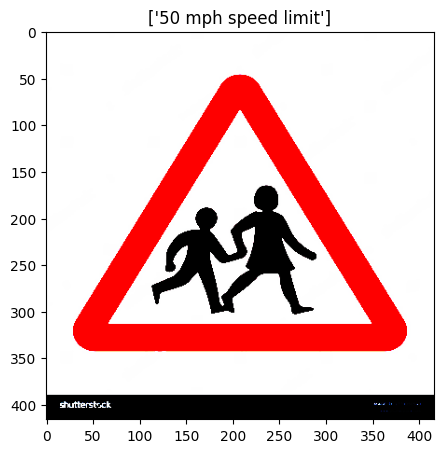

original prediction

0: 416x416 (no detections), 247.3ms
Speed: 0.0ms preprocess, 247.3ms inference, 2.9ms postprocess per image at shape (1, 3, 416, 416)
tensor([3])
tensor([3])
tensor([3])
tensor([3])
tensor([3])
tensor([3])
tensor([3])
tensor([3])
tensor([3])
tensor([3])
prediction after attack

0: 416x416 1 CYCLE ROUTE AHEAD WARNING, 252.9ms
Speed: 0.0ms preprocess, 252.9ms inference, 3.3ms postprocess per image at shape (1, 3, 416, 416)


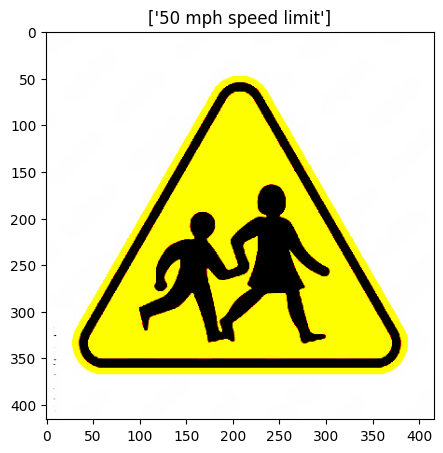

original prediction

0: 416x416 (no detections), 400.5ms
Speed: 0.0ms preprocess, 400.5ms inference, 3.3ms postprocess per image at shape (1, 3, 416, 416)
tensor([3])
tensor([3])
tensor([3])
tensor([3])
tensor([3])
tensor([3])
tensor([3])
tensor([3])
tensor([3])
tensor([3])
prediction after attack

0: 416x416 1 Attention Please-, 300.2ms
Speed: 0.0ms preprocess, 300.2ms inference, 3.2ms postprocess per image at shape (1, 3, 416, 416)


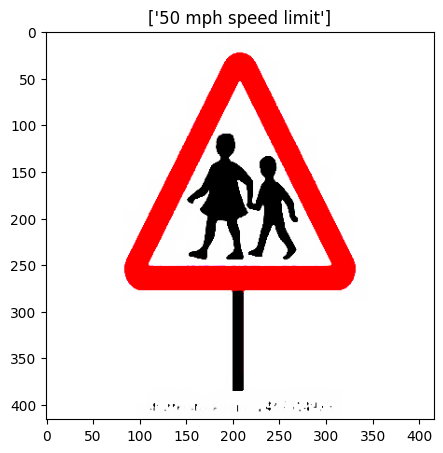

original prediction

0: 416x416 1 Stop_Sign, 256.7ms
Speed: 0.0ms preprocess, 256.7ms inference, 3.2ms postprocess per image at shape (1, 3, 416, 416)
tensor([3])
tensor([3])
tensor([3])
tensor([3])
tensor([3])
tensor([3])
tensor([3])
tensor([3])
tensor([3])
tensor([3])
prediction after attack

0: 416x416 (no detections), 251.1ms
Speed: 0.0ms preprocess, 251.1ms inference, 2.8ms postprocess per image at shape (1, 3, 416, 416)


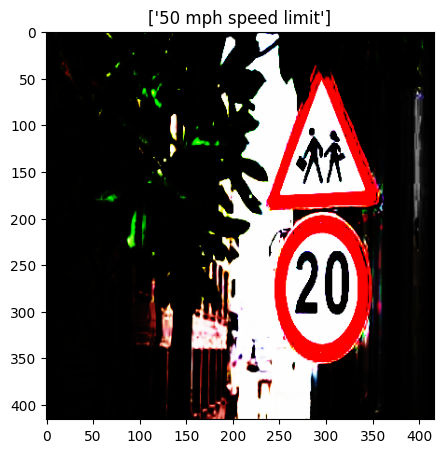

original prediction

0: 416x416 1 Dangerous Rright Curve Ahead, 259.0ms
Speed: 0.0ms preprocess, 259.0ms inference, 3.1ms postprocess per image at shape (1, 3, 416, 416)
tensor([3])
tensor([3])
tensor([3])
tensor([3])
tensor([3])
tensor([3])
tensor([3])
tensor([3])
tensor([3])
tensor([3])
prediction after attack

0: 416x416 1 Beware of children, 250.9ms
Speed: 0.0ms preprocess, 250.9ms inference, 4.6ms postprocess per image at shape (1, 3, 416, 416)


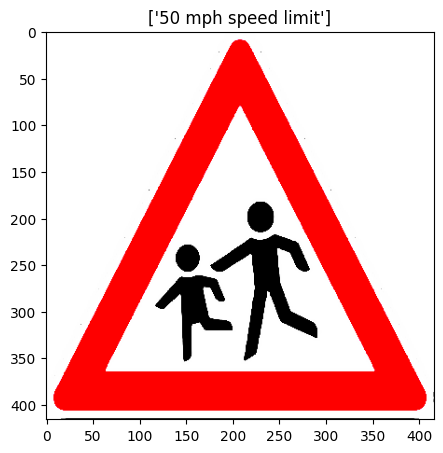

original prediction

0: 416x416 1 Traffic_signal, 258.6ms
Speed: 0.0ms preprocess, 258.6ms inference, 3.1ms postprocess per image at shape (1, 3, 416, 416)
tensor([4])
tensor([4])
tensor([4])
tensor([4])
tensor([4])
tensor([4])
tensor([4])
tensor([4])
tensor([4])
tensor([4])
prediction after attack

0: 416x416 (no detections), 391.9ms
Speed: 0.0ms preprocess, 391.9ms inference, 3.5ms postprocess per image at shape (1, 3, 416, 416)


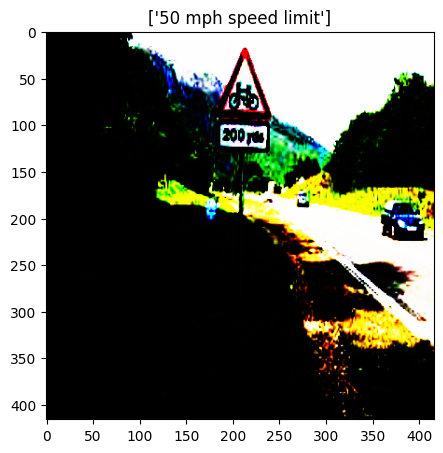

original prediction

0: 416x416 1 Uneven Road, 419.0ms
Speed: 0.0ms preprocess, 419.0ms inference, 6.5ms postprocess per image at shape (1, 3, 416, 416)
tensor([4])
tensor([4])
tensor([4])
tensor([4])
tensor([4])
tensor([4])
tensor([4])
tensor([4])
tensor([4])
tensor([4])
prediction after attack

0: 416x416 1 CYCLE ROUTE AHEAD WARNING, 264.7ms
Speed: 0.0ms preprocess, 264.7ms inference, 3.2ms postprocess per image at shape (1, 3, 416, 416)


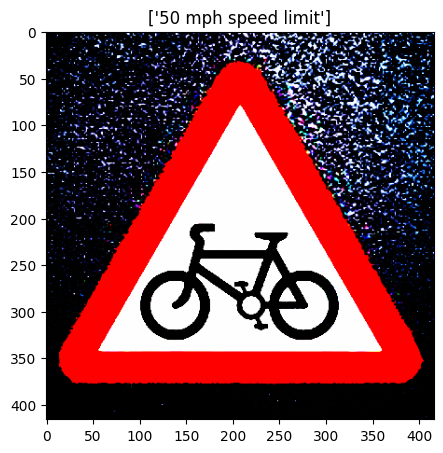

original prediction

0: 416x416 (no detections), 300.7ms
Speed: 0.0ms preprocess, 300.7ms inference, 2.9ms postprocess per image at shape (1, 3, 416, 416)
tensor([4])
tensor([4])
tensor([4])
tensor([4])
tensor([4])
tensor([4])
tensor([4])
tensor([4])
tensor([4])
tensor([4])
prediction after attack

0: 416x416 1 50 mph speed limit, 274.9ms
Speed: 0.0ms preprocess, 274.9ms inference, 3.8ms postprocess per image at shape (1, 3, 416, 416)


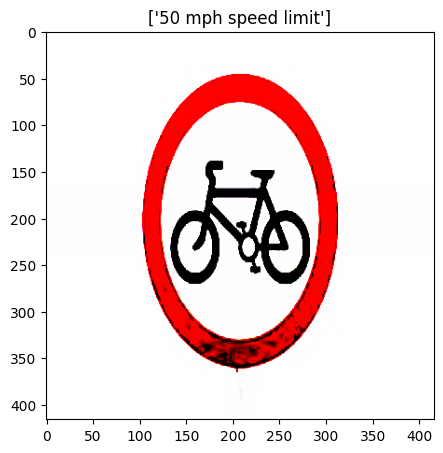

original prediction

0: 416x416 1 Dangerous Left Curve Ahead, 254.5ms
Speed: 0.0ms preprocess, 254.5ms inference, 3.2ms postprocess per image at shape (1, 3, 416, 416)
tensor([5])
tensor([5])
tensor([5])
tensor([5])
tensor([5])
tensor([5])
tensor([5])
tensor([5])
tensor([5])
tensor([5])
prediction after attack

0: 416x416 1 Dangerous Rright Curve Ahead, 385.4ms
Speed: 0.1ms preprocess, 385.4ms inference, 3.9ms postprocess per image at shape (1, 3, 416, 416)


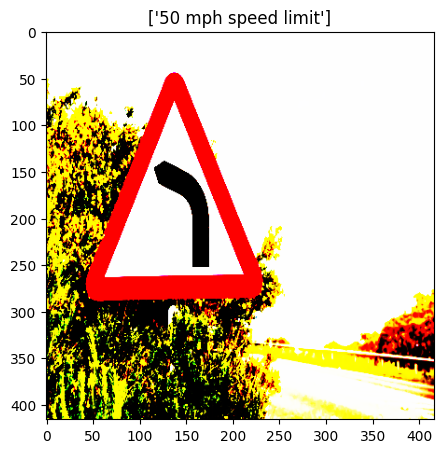

original prediction

0: 416x416 1 Dangerous Left Curve Ahead, 430.4ms
Speed: 0.0ms preprocess, 430.4ms inference, 9.3ms postprocess per image at shape (1, 3, 416, 416)
tensor([5])
tensor([5])
tensor([5])
tensor([5])
tensor([5])
tensor([5])
tensor([5])
tensor([5])
tensor([5])
tensor([5])
prediction after attack

0: 416x416 1 Dangerous Left Curve Ahead, 256.8ms
Speed: 0.0ms preprocess, 256.8ms inference, 3.3ms postprocess per image at shape (1, 3, 416, 416)


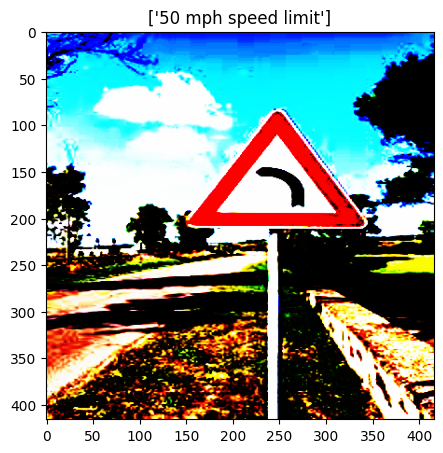

original prediction

0: 416x416 1 Dangerous Left Curve Ahead, 310.1ms
Speed: 0.0ms preprocess, 310.1ms inference, 3.3ms postprocess per image at shape (1, 3, 416, 416)
tensor([5])
tensor([5])
tensor([5])
tensor([5])
tensor([5])
tensor([5])
tensor([5])
tensor([5])
tensor([5])
tensor([5])
prediction after attack

0: 416x416 1 Dangerous Left Curve Ahead, 255.8ms
Speed: 0.0ms preprocess, 255.8ms inference, 3.2ms postprocess per image at shape (1, 3, 416, 416)


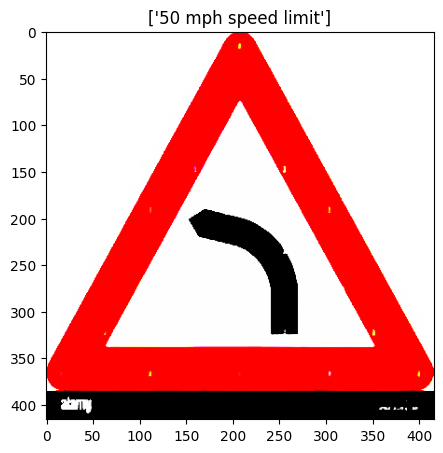

original prediction

0: 416x416 1 Dangerous Rright Curve Ahead, 1 Truck traffic is prohibited, 275.7ms
Speed: 0.0ms preprocess, 275.7ms inference, 3.2ms postprocess per image at shape (1, 3, 416, 416)
tensor([5])
tensor([5])
tensor([5])
tensor([5])
tensor([5])
tensor([5])
tensor([5])
tensor([5])
tensor([5])
tensor([5])
prediction after attack

0: 416x416 1 Dangerous Left Curve Ahead, 256.6ms
Speed: 0.0ms preprocess, 256.6ms inference, 3.7ms postprocess per image at shape (1, 3, 416, 416)


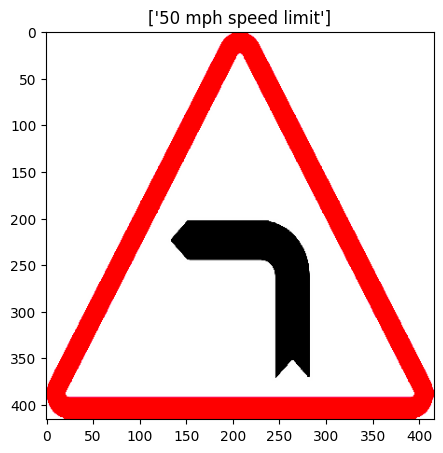

original prediction

0: 416x416 1 Dangerous Rright Curve Ahead, 394.9ms
Speed: 0.0ms preprocess, 394.9ms inference, 3.8ms postprocess per image at shape (1, 3, 416, 416)
tensor([5])
tensor([5])
tensor([5])
tensor([5])
tensor([5])
tensor([5])
tensor([5])
tensor([5])
tensor([5])
tensor([5])
prediction after attack

0: 416x416 1 Dangerous Rright Curve Ahead, 396.0ms
Speed: 0.0ms preprocess, 396.0ms inference, 6.6ms postprocess per image at shape (1, 3, 416, 416)


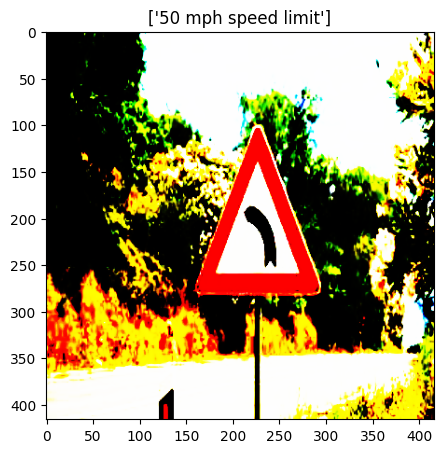

original prediction

0: 416x416 1 Traffic_signal, 301.5ms
Speed: 0.0ms preprocess, 301.5ms inference, 3.4ms postprocess per image at shape (1, 3, 416, 416)
tensor([6])
tensor([6])
tensor([6])
tensor([6])
tensor([6])
tensor([6])
tensor([6])
tensor([6])
tensor([6])
tensor([6])
prediction after attack

0: 416x416 1 Pedestrian Crossing, 266.9ms
Speed: 0.0ms preprocess, 266.9ms inference, 3.1ms postprocess per image at shape (1, 3, 416, 416)


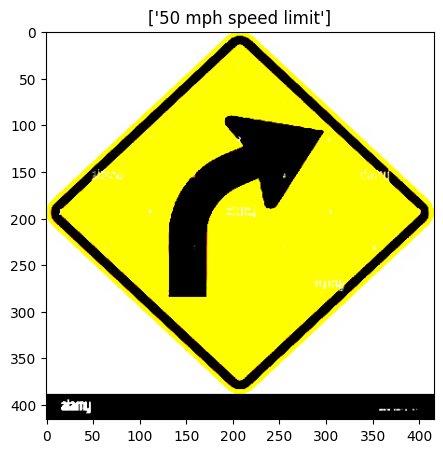

original prediction

0: 416x416 1 Dangerous Left Curve Ahead, 291.2ms
Speed: 0.0ms preprocess, 291.2ms inference, 3.4ms postprocess per image at shape (1, 3, 416, 416)
tensor([6])
tensor([6])
tensor([6])
tensor([6])
tensor([6])
tensor([6])
tensor([6])
tensor([6])
tensor([6])
tensor([6])
prediction after attack

0: 416x416 1 Dangerous Left Curve Ahead, 268.3ms
Speed: 0.0ms preprocess, 268.3ms inference, 3.8ms postprocess per image at shape (1, 3, 416, 416)


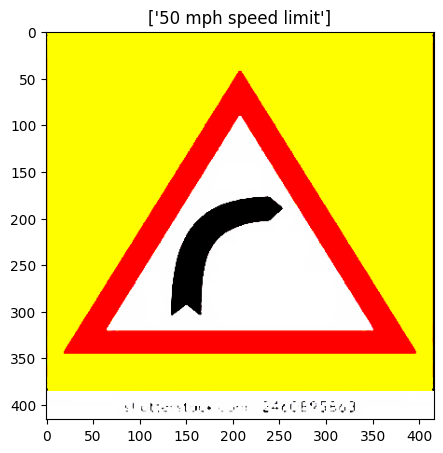

original prediction

0: 416x416 1 Dangerous Left Curve Ahead, 291.3ms
Speed: 0.0ms preprocess, 291.3ms inference, 3.2ms postprocess per image at shape (1, 3, 416, 416)
tensor([6])
tensor([6])
tensor([6])
tensor([6])
tensor([6])
tensor([6])
tensor([6])
tensor([6])
tensor([6])
tensor([6])
prediction after attack

0: 416x416 1 Dangerous Left Curve Ahead, 408.2ms
Speed: 0.0ms preprocess, 408.2ms inference, 3.8ms postprocess per image at shape (1, 3, 416, 416)


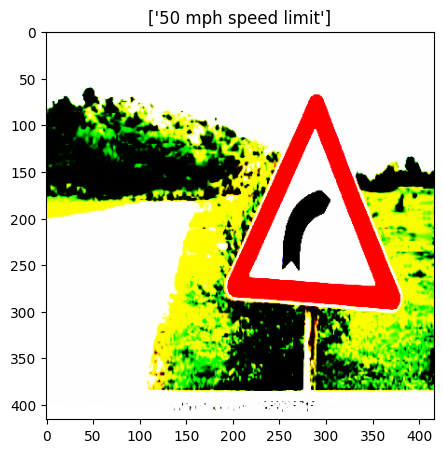

original prediction

0: 416x416 5 Traffic_signals, 425.0ms
Speed: 0.0ms preprocess, 425.0ms inference, 4.6ms postprocess per image at shape (1, 3, 416, 416)
tensor([6])
tensor([6])
tensor([6])
tensor([6])
tensor([6])
tensor([6])
tensor([6])
tensor([6])
tensor([6])
tensor([6])
prediction after attack

0: 416x416 (no detections), 259.0ms
Speed: 0.0ms preprocess, 259.0ms inference, 2.8ms postprocess per image at shape (1, 3, 416, 416)


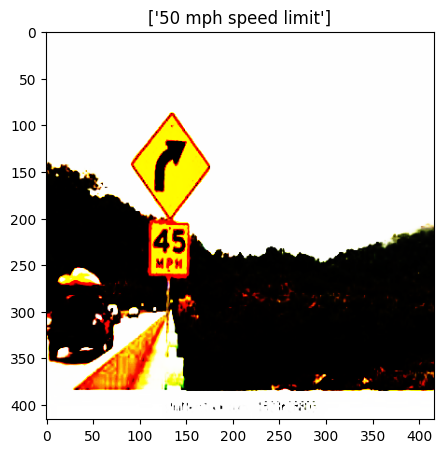

original prediction

0: 416x416 1 End of all speed and passing limits, 285.7ms
Speed: 0.0ms preprocess, 285.7ms inference, 3.0ms postprocess per image at shape (1, 3, 416, 416)
tensor([7])
tensor([7])
tensor([7])
tensor([7])
tensor([7])
tensor([7])
tensor([7])
tensor([7])
tensor([7])
tensor([7])
prediction after attack

0: 416x416 1 End of all speed and passing limits, 263.4ms
Speed: 0.0ms preprocess, 263.4ms inference, 3.1ms postprocess per image at shape (1, 3, 416, 416)


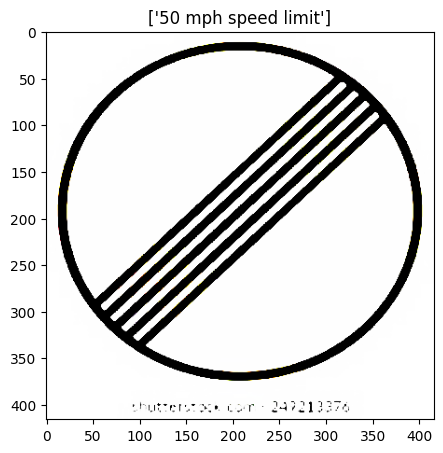

original prediction

0: 416x416 1 Turn left ahead, 305.4ms
Speed: 0.0ms preprocess, 305.4ms inference, 3.3ms postprocess per image at shape (1, 3, 416, 416)
tensor([7])
tensor([7])
tensor([7])
tensor([7])
tensor([7])
tensor([7])
tensor([7])
tensor([7])
tensor([7])
tensor([7])
prediction after attack

0: 416x416 1 End of all speed and passing limits, 393.8ms
Speed: 0.0ms preprocess, 393.8ms inference, 3.9ms postprocess per image at shape (1, 3, 416, 416)


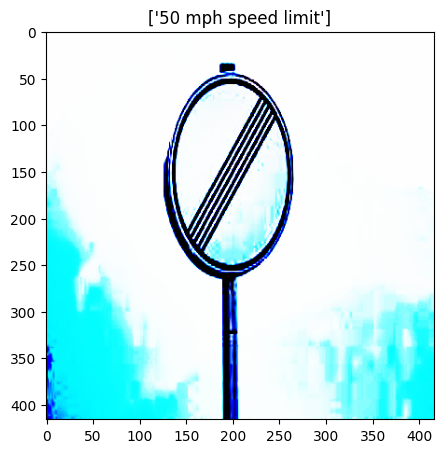

original prediction

0: 416x416 1 Traffic_signal, 400.9ms
Speed: 0.0ms preprocess, 400.9ms inference, 4.0ms postprocess per image at shape (1, 3, 416, 416)
tensor([7])
tensor([7])
tensor([7])
tensor([7])
tensor([7])
tensor([7])
tensor([7])
tensor([7])
tensor([7])
tensor([7])
prediction after attack

0: 416x416 (no detections), 277.2ms
Speed: 0.0ms preprocess, 277.2ms inference, 2.8ms postprocess per image at shape (1, 3, 416, 416)


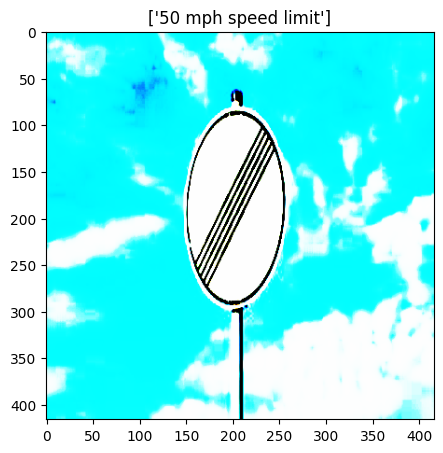

original prediction

0: 416x416 1 Traffic_signal, 287.3ms
Speed: 0.0ms preprocess, 287.3ms inference, 3.0ms postprocess per image at shape (1, 3, 416, 416)
tensor([8])
tensor([8])
tensor([8])
tensor([8])
tensor([8])
tensor([8])
tensor([8])
tensor([8])
tensor([8])
tensor([8])
prediction after attack

0: 416x416 1 Give Way, 259.8ms
Speed: 0.0ms preprocess, 259.8ms inference, 3.1ms postprocess per image at shape (1, 3, 416, 416)


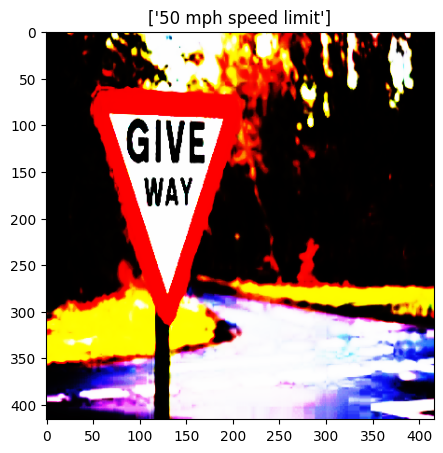

original prediction

0: 416x416 1 Stop_Sign, 305.2ms
Speed: 0.0ms preprocess, 305.2ms inference, 3.1ms postprocess per image at shape (1, 3, 416, 416)
tensor([8])
tensor([8])
tensor([8])
tensor([8])
tensor([8])
tensor([8])
tensor([8])
tensor([8])
tensor([8])
tensor([8])
prediction after attack

0: 416x416 1 Give Way, 264.6ms
Speed: 0.0ms preprocess, 264.6ms inference, 3.1ms postprocess per image at shape (1, 3, 416, 416)


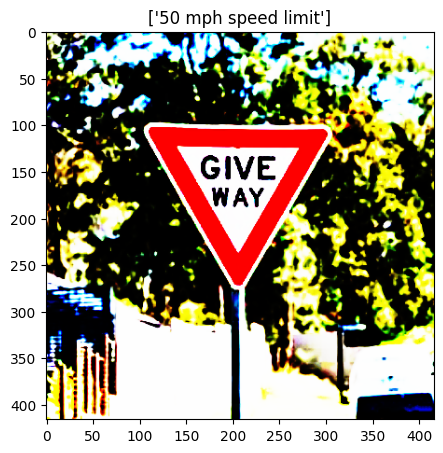

original prediction

0: 416x416 1 Stop_Sign, 401.8ms
Speed: 0.0ms preprocess, 401.8ms inference, 4.0ms postprocess per image at shape (1, 3, 416, 416)
tensor([8])
tensor([8])
tensor([8])
tensor([8])
tensor([8])
tensor([8])
tensor([8])
tensor([8])
tensor([8])
tensor([8])
prediction after attack

0: 416x416 (no detections), 431.7ms
Speed: 0.0ms preprocess, 431.7ms inference, 3.5ms postprocess per image at shape (1, 3, 416, 416)


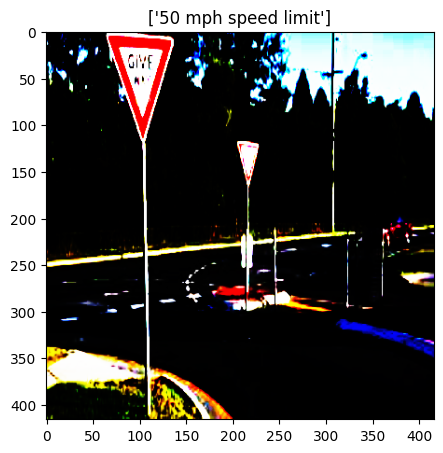

original prediction

0: 416x416 (no detections), 301.5ms
Speed: 0.0ms preprocess, 301.5ms inference, 2.8ms postprocess per image at shape (1, 3, 416, 416)
tensor([8])
tensor([8])
tensor([8])
tensor([8])
tensor([8])
tensor([8])
tensor([8])
tensor([8])
tensor([8])
tensor([8])
prediction after attack

0: 416x416 1 Give Way, 268.5ms
Speed: 0.0ms preprocess, 268.5ms inference, 3.3ms postprocess per image at shape (1, 3, 416, 416)


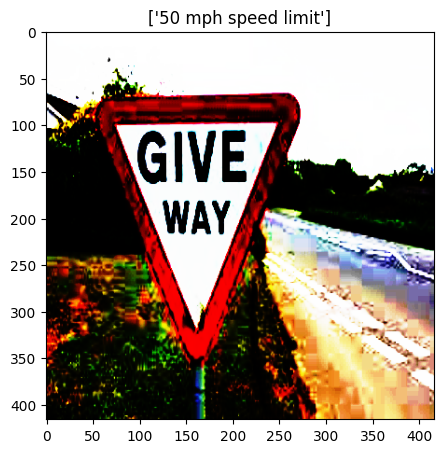

original prediction

0: 416x416 (no detections), 303.8ms
Speed: 0.0ms preprocess, 303.8ms inference, 3.0ms postprocess per image at shape (1, 3, 416, 416)
tensor([8])
tensor([8])
tensor([8])
tensor([8])
tensor([8])
tensor([8])
tensor([8])
tensor([8])
tensor([8])
tensor([8])
prediction after attack

0: 416x416 (no detections), 268.4ms
Speed: 0.0ms preprocess, 268.4ms inference, 2.8ms postprocess per image at shape (1, 3, 416, 416)


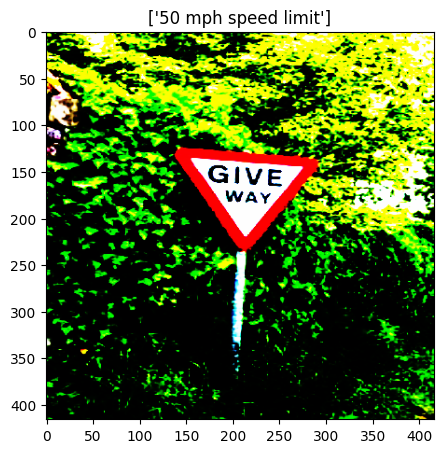

original prediction

0: 416x416 1 Dangerous Left Curve Ahead, 322.6ms
Speed: 0.0ms preprocess, 322.6ms inference, 4.1ms postprocess per image at shape (1, 3, 416, 416)
tensor([8])
tensor([8])
tensor([8])
tensor([8])
tensor([8])
tensor([8])
tensor([8])
tensor([8])
tensor([8])
tensor([8])
prediction after attack

0: 416x416 (no detections), 381.8ms
Speed: 0.0ms preprocess, 381.8ms inference, 3.5ms postprocess per image at shape (1, 3, 416, 416)


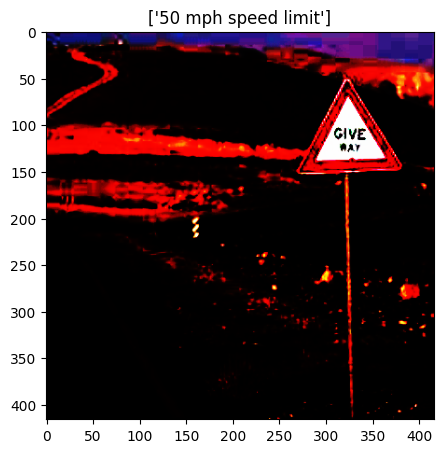

original prediction

0: 416x416 1 Stop_Sign, 428.6ms
Speed: 0.0ms preprocess, 428.6ms inference, 3.8ms postprocess per image at shape (1, 3, 416, 416)
tensor([9])
tensor([9])
tensor([9])
tensor([9])
tensor([9])
tensor([9])
tensor([9])
tensor([9])
tensor([9])
tensor([9])
prediction after attack

0: 416x416 1 Speed Limit 20 KMPh, 270.7ms
Speed: 0.0ms preprocess, 270.7ms inference, 3.2ms postprocess per image at shape (1, 3, 416, 416)


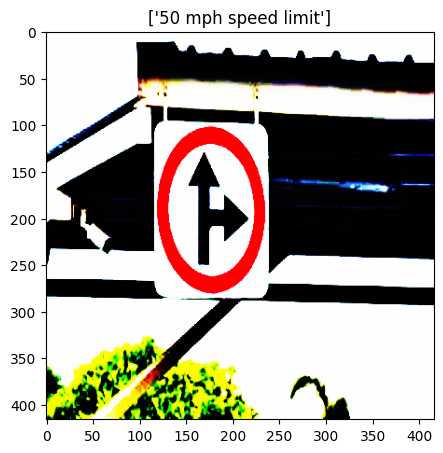

original prediction

0: 416x416 1 50 mph speed limit, 1 Speed Limit 20 KMPh, 302.4ms
Speed: 0.0ms preprocess, 302.4ms inference, 3.1ms postprocess per image at shape (1, 3, 416, 416)
tensor([9])
tensor([9])
tensor([9])
tensor([9])
tensor([9])
tensor([9])
tensor([9])
tensor([9])
tensor([9])
tensor([9])
prediction after attack

0: 416x416 1 50 mph speed limit, 269.3ms
Speed: 0.0ms preprocess, 269.3ms inference, 4.0ms postprocess per image at shape (1, 3, 416, 416)


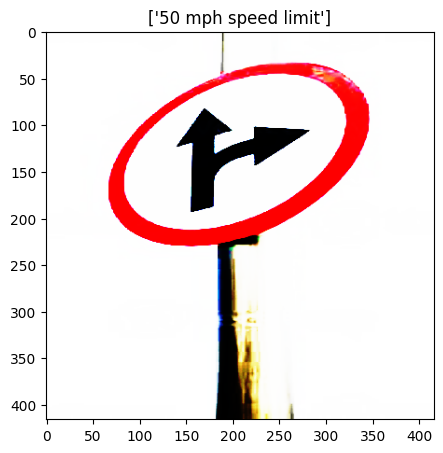

original prediction

0: 416x416 1 Traffic_signal, 315.1ms
Speed: 0.0ms preprocess, 315.1ms inference, 4.3ms postprocess per image at shape (1, 3, 416, 416)
tensor([9])
tensor([9])
tensor([9])
tensor([9])
tensor([9])
tensor([9])
tensor([9])
tensor([9])
tensor([9])
tensor([9])
prediction after attack

0: 416x416 (no detections), 390.7ms
Speed: 0.0ms preprocess, 390.7ms inference, 3.4ms postprocess per image at shape (1, 3, 416, 416)


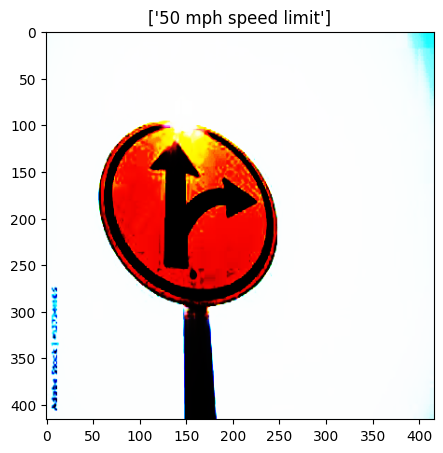

original prediction

0: 416x416 1 Go Straight or Turn Right, 1 Go straight or turn left, 413.5ms
Speed: 0.0ms preprocess, 413.5ms inference, 4.2ms postprocess per image at shape (1, 3, 416, 416)
tensor([9])
tensor([9])
tensor([9])
tensor([9])
tensor([9])
tensor([9])
tensor([9])
tensor([9])
tensor([9])
tensor([9])
prediction after attack

0: 416x416 1 Go straight or turn left, 287.0ms
Speed: 0.0ms preprocess, 287.0ms inference, 3.5ms postprocess per image at shape (1, 3, 416, 416)


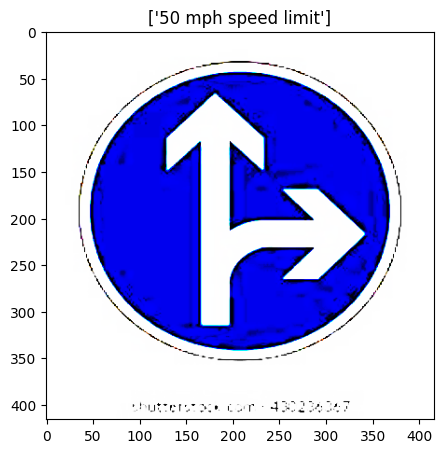

original prediction

0: 416x416 (no detections), 299.0ms
Speed: 0.0ms preprocess, 299.0ms inference, 3.0ms postprocess per image at shape (1, 3, 416, 416)
tensor([10])
tensor([10])
tensor([10])
tensor([10])
tensor([10])
tensor([10])
tensor([10])
tensor([10])
tensor([10])
tensor([10])
prediction after attack

0: 416x416 1 50 mph speed limit, 275.7ms
Speed: 0.0ms preprocess, 275.7ms inference, 3.2ms postprocess per image at shape (1, 3, 416, 416)


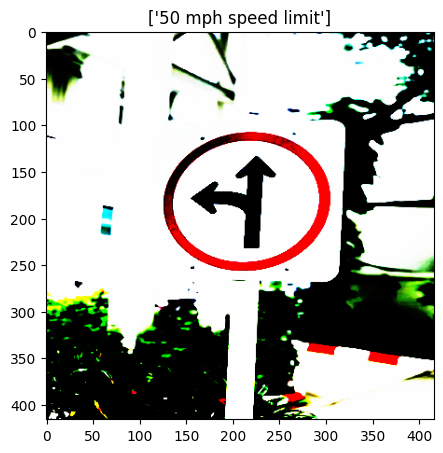

original prediction

0: 416x416 1 Truck traffic is prohibited, 305.6ms
Speed: 0.0ms preprocess, 305.6ms inference, 3.1ms postprocess per image at shape (1, 3, 416, 416)
tensor([10])
tensor([10])
tensor([10])
tensor([10])
tensor([10])
tensor([10])
tensor([10])
tensor([10])
tensor([10])
tensor([10])
prediction after attack

0: 416x416 (no detections), 272.4ms
Speed: 0.0ms preprocess, 272.4ms inference, 2.8ms postprocess per image at shape (1, 3, 416, 416)


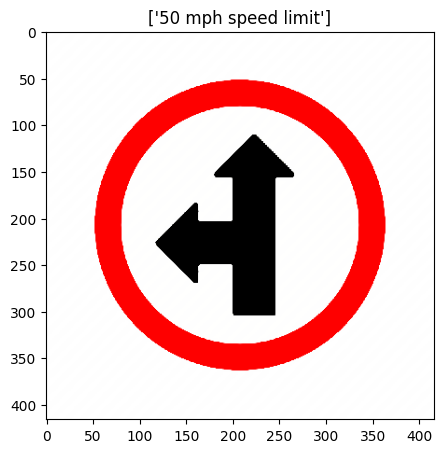

original prediction

0: 416x416 1 Go straight or turn left, 301.4ms
Speed: 0.0ms preprocess, 301.4ms inference, 3.1ms postprocess per image at shape (1, 3, 416, 416)
tensor([10])
tensor([10])
tensor([10])
tensor([10])
tensor([10])
tensor([10])
tensor([10])
tensor([10])
tensor([10])
tensor([10])
prediction after attack

0: 416x416 1 Go straight or turn left, 388.1ms
Speed: 0.0ms preprocess, 388.1ms inference, 4.5ms postprocess per image at shape (1, 3, 416, 416)


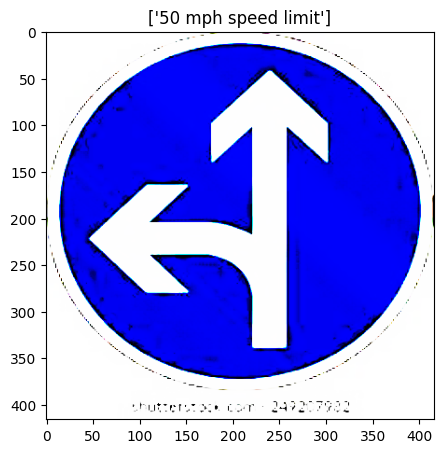

original prediction

0: 416x416 1 Keep-Left, 424.4ms
Speed: 0.0ms preprocess, 424.4ms inference, 4.3ms postprocess per image at shape (1, 3, 416, 416)
tensor([11])
tensor([11])
tensor([11])
tensor([11])
tensor([11])
tensor([11])
tensor([11])
tensor([11])
tensor([11])
tensor([11])
prediction after attack

0: 416x416 1 Keep-Right, 295.6ms
Speed: 0.0ms preprocess, 295.6ms inference, 3.4ms postprocess per image at shape (1, 3, 416, 416)


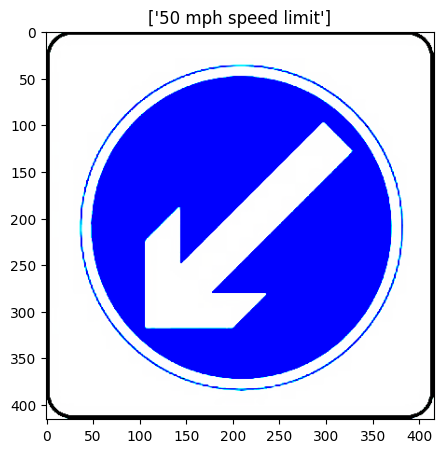

original prediction

0: 416x416 1 Keep-Left, 299.0ms
Speed: 0.0ms preprocess, 299.0ms inference, 3.1ms postprocess per image at shape (1, 3, 416, 416)
tensor([11])
tensor([11])
tensor([11])
tensor([11])
tensor([11])
tensor([11])
tensor([11])
tensor([11])
tensor([11])
tensor([11])
prediction after attack

0: 416x416 1 Keep-Right, 285.2ms
Speed: 0.0ms preprocess, 285.2ms inference, 3.4ms postprocess per image at shape (1, 3, 416, 416)


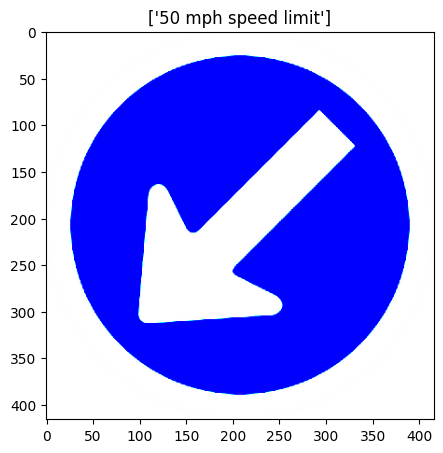

original prediction

0: 416x416 1 Keep-Left, 326.6ms
Speed: 0.0ms preprocess, 326.6ms inference, 3.1ms postprocess per image at shape (1, 3, 416, 416)
tensor([11])
tensor([11])
tensor([11])
tensor([11])
tensor([11])
tensor([11])
tensor([11])
tensor([11])
tensor([11])
tensor([11])
prediction after attack

0: 416x416 (no detections), 370.4ms
Speed: 0.0ms preprocess, 370.4ms inference, 3.5ms postprocess per image at shape (1, 3, 416, 416)


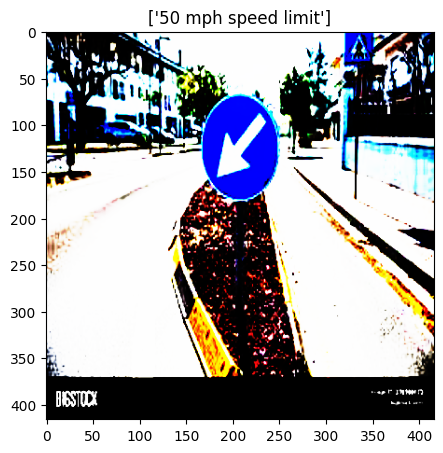

original prediction

0: 416x416 1 Keep-Left, 414.6ms
Speed: 0.0ms preprocess, 414.6ms inference, 4.1ms postprocess per image at shape (1, 3, 416, 416)
tensor([12])
tensor([12])
tensor([12])
tensor([12])
tensor([12])
tensor([12])
tensor([12])
tensor([12])
tensor([12])
tensor([12])
prediction after attack

0: 416x416 1 Keep-Right, 299.3ms
Speed: 0.0ms preprocess, 299.3ms inference, 3.1ms postprocess per image at shape (1, 3, 416, 416)


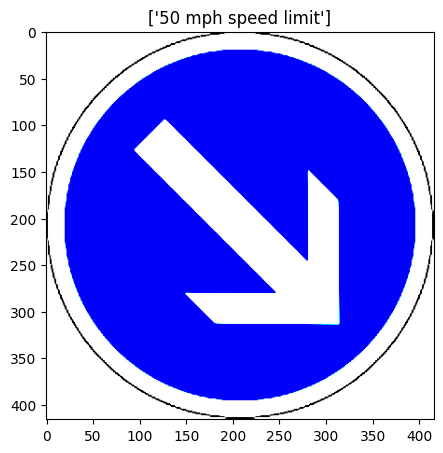

original prediction

0: 416x416 1 Keep-Left, 2 Traffic_signals, 316.3ms
Speed: 0.0ms preprocess, 316.3ms inference, 3.1ms postprocess per image at shape (1, 3, 416, 416)
tensor([12])
tensor([12])
tensor([12])
tensor([12])
tensor([12])
tensor([12])
tensor([12])
tensor([12])
tensor([12])
tensor([12])
prediction after attack

0: 416x416 1 Keep-Right, 273.9ms
Speed: 0.0ms preprocess, 273.9ms inference, 3.0ms postprocess per image at shape (1, 3, 416, 416)


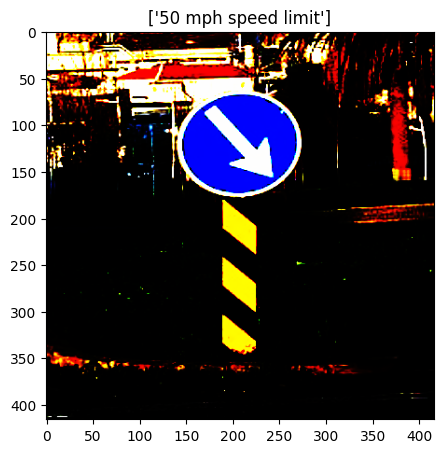

original prediction

0: 416x416 1 Keep-Left, 2 Stop_Signs, 311.4ms
Speed: 0.0ms preprocess, 311.4ms inference, 3.3ms postprocess per image at shape (1, 3, 416, 416)
tensor([12])
tensor([12])
tensor([12])
tensor([12])
tensor([12])
tensor([12])
tensor([12])
tensor([12])
tensor([12])
tensor([12])
prediction after attack

0: 416x416 1 Keep-Right, 280.0ms
Speed: 0.0ms preprocess, 280.0ms inference, 3.3ms postprocess per image at shape (1, 3, 416, 416)


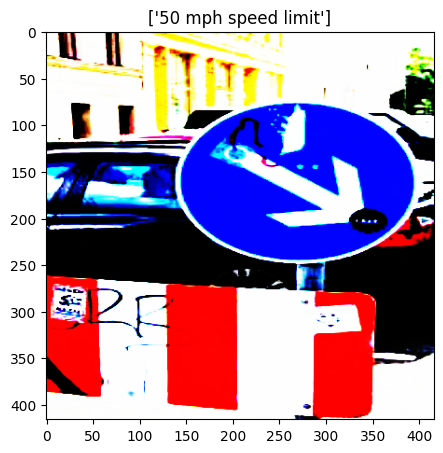

original prediction

0: 416x416 1 Keep-Left, 1 Keep-Right, 1 Stop_Sign, 311.9ms
Speed: 0.0ms preprocess, 311.9ms inference, 3.1ms postprocess per image at shape (1, 3, 416, 416)
tensor([12])
tensor([12])
tensor([12])
tensor([12])
tensor([12])
tensor([12])
tensor([12])
tensor([12])
tensor([12])
tensor([12])
prediction after attack

0: 416x416 1 Keep-Right, 423.2ms
Speed: 1.4ms preprocess, 423.2ms inference, 4.0ms postprocess per image at shape (1, 3, 416, 416)


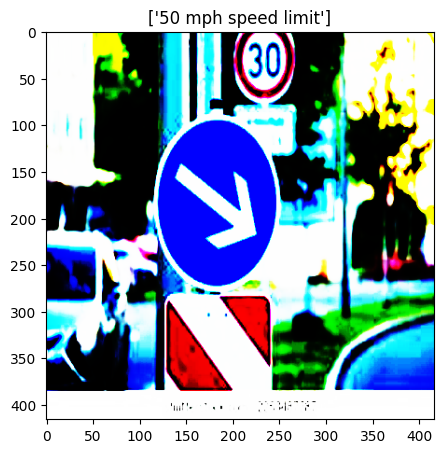

original prediction

0: 416x416 (no detections), 436.0ms
Speed: 0.0ms preprocess, 436.0ms inference, 3.9ms postprocess per image at shape (1, 3, 416, 416)
tensor([12])
tensor([12])
tensor([12])
tensor([12])
tensor([12])
tensor([12])
tensor([12])
tensor([12])
tensor([12])
tensor([12])
prediction after attack

0: 416x416 (no detections), 299.5ms
Speed: 0.0ms preprocess, 299.5ms inference, 3.4ms postprocess per image at shape (1, 3, 416, 416)


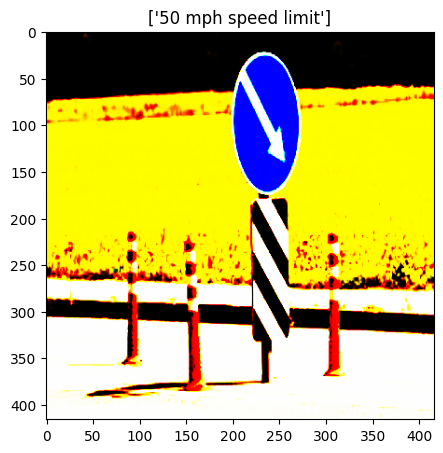

original prediction

0: 416x416 (no detections), 313.8ms
Speed: 0.0ms preprocess, 313.8ms inference, 2.8ms postprocess per image at shape (1, 3, 416, 416)
tensor([13])
tensor([13])
tensor([13])
tensor([13])
tensor([13])
tensor([13])
tensor([13])
tensor([13])
tensor([13])
tensor([13])
prediction after attack

0: 416x416 1 Pedestrian Crossing, 282.2ms
Speed: 0.0ms preprocess, 282.2ms inference, 3.1ms postprocess per image at shape (1, 3, 416, 416)


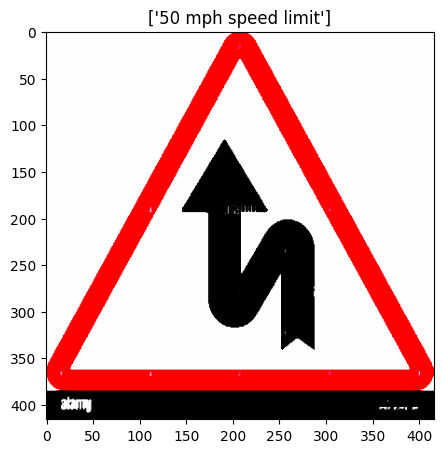

original prediction

0: 416x416 1 Left Zig Zag Traffic, 319.8ms
Speed: 0.0ms preprocess, 319.8ms inference, 3.1ms postprocess per image at shape (1, 3, 416, 416)
tensor([13])
tensor([13])
tensor([13])
tensor([13])
tensor([13])
tensor([13])
tensor([13])
tensor([13])
tensor([13])
tensor([13])
prediction after attack

0: 416x416 1 CYCLE ROUTE AHEAD WARNING, 383.1ms
Speed: 0.0ms preprocess, 383.1ms inference, 3.9ms postprocess per image at shape (1, 3, 416, 416)


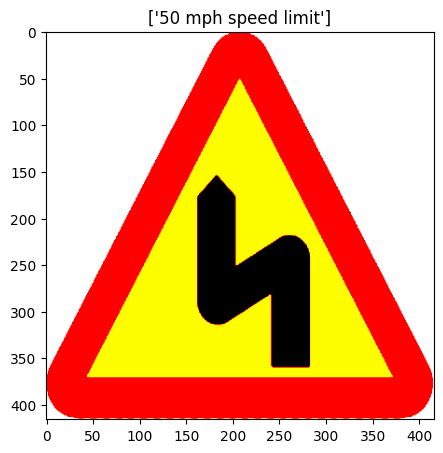

original prediction

0: 416x416 1 No Entry, 447.9ms
Speed: 0.0ms preprocess, 447.9ms inference, 4.3ms postprocess per image at shape (1, 3, 416, 416)
tensor([14])
tensor([14])
tensor([14])
tensor([14])
tensor([14])
tensor([14])
tensor([14])
tensor([14])
tensor([14])
tensor([14])
prediction after attack

0: 416x416 1 No Entry, 331.0ms
Speed: 0.0ms preprocess, 331.0ms inference, 3.1ms postprocess per image at shape (1, 3, 416, 416)


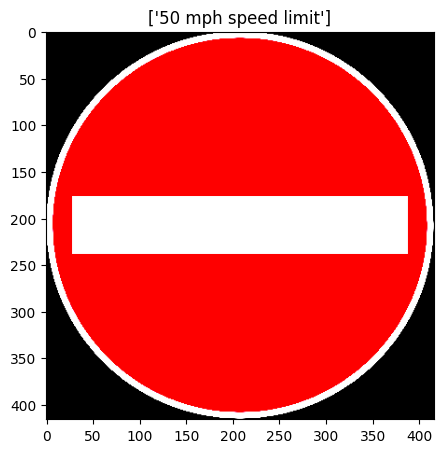

original prediction

0: 416x416 1 No Entry, 322.5ms
Speed: 0.0ms preprocess, 322.5ms inference, 3.1ms postprocess per image at shape (1, 3, 416, 416)
tensor([14])
tensor([14])
tensor([14])
tensor([14])
tensor([14])
tensor([14])
tensor([14])
tensor([14])
tensor([14])
tensor([14])
prediction after attack

0: 416x416 1 No Entry, 284.0ms
Speed: 0.0ms preprocess, 284.0ms inference, 3.1ms postprocess per image at shape (1, 3, 416, 416)


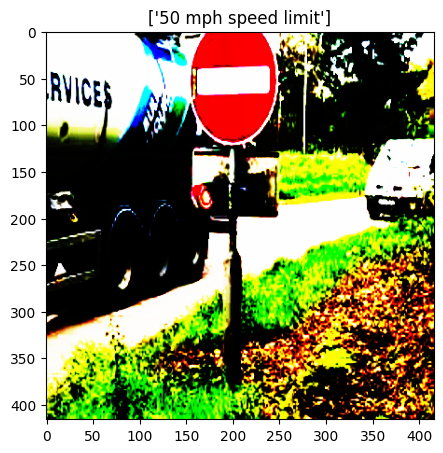

original prediction

0: 416x416 1 No Entry, 1 Stop_Sign, 333.4ms
Speed: 0.0ms preprocess, 333.4ms inference, 3.3ms postprocess per image at shape (1, 3, 416, 416)
tensor([14])
tensor([14])
tensor([14])
tensor([14])
tensor([14])
tensor([14])
tensor([14])
tensor([14])
tensor([14])
tensor([14])
prediction after attack

0: 416x416 (no detections), 301.7ms
Speed: 0.0ms preprocess, 301.7ms inference, 2.8ms postprocess per image at shape (1, 3, 416, 416)


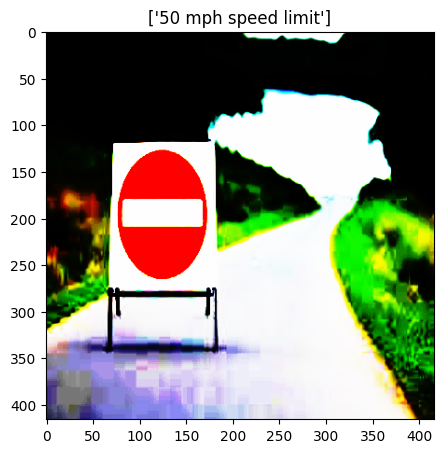

original prediction

0: 416x416 1 Stop_Sign, 321.7ms
Speed: 0.0ms preprocess, 321.7ms inference, 3.1ms postprocess per image at shape (1, 3, 416, 416)
tensor([14])
tensor([14])
tensor([14])
tensor([14])
tensor([14])
tensor([14])
tensor([14])
tensor([14])
tensor([14])
tensor([14])
prediction after attack

0: 416x416 1 Stop_Sign, 397.7ms
Speed: 0.0ms preprocess, 397.7ms inference, 3.9ms postprocess per image at shape (1, 3, 416, 416)


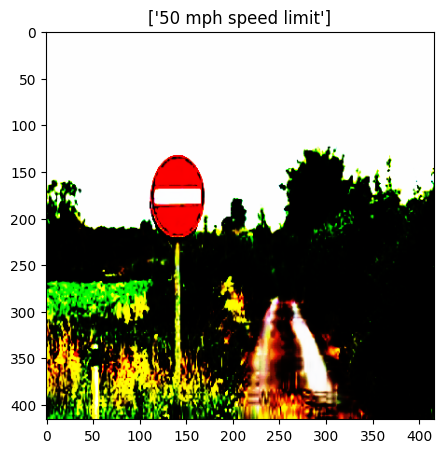

original prediction

0: 416x416 1 Stop_Sign, 398.1ms
Speed: 0.0ms preprocess, 398.1ms inference, 4.3ms postprocess per image at shape (1, 3, 416, 416)
tensor([14])
tensor([14])
tensor([14])
tensor([14])
tensor([14])
tensor([14])
tensor([14])
tensor([14])
tensor([14])
tensor([14])
prediction after attack

0: 416x416 1 Stop_Sign, 294.1ms
Speed: 0.0ms preprocess, 294.1ms inference, 3.1ms postprocess per image at shape (1, 3, 416, 416)


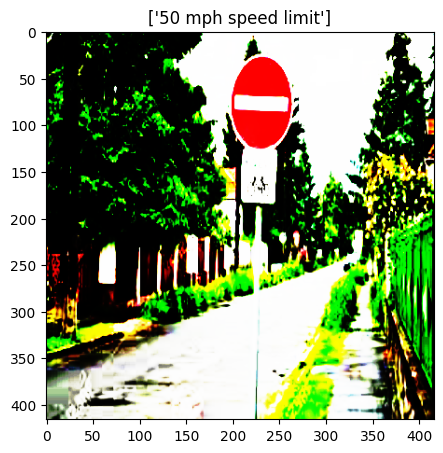

original prediction

0: 416x416 1 No Entry, 342.6ms
Speed: 0.0ms preprocess, 342.6ms inference, 3.2ms postprocess per image at shape (1, 3, 416, 416)
tensor([14])
tensor([14])
tensor([14])
tensor([14])
tensor([14])
tensor([14])
tensor([14])
tensor([14])
tensor([14])
tensor([14])
prediction after attack

0: 416x416 1 No Entry, 290.4ms
Speed: 0.0ms preprocess, 290.4ms inference, 4.3ms postprocess per image at shape (1, 3, 416, 416)


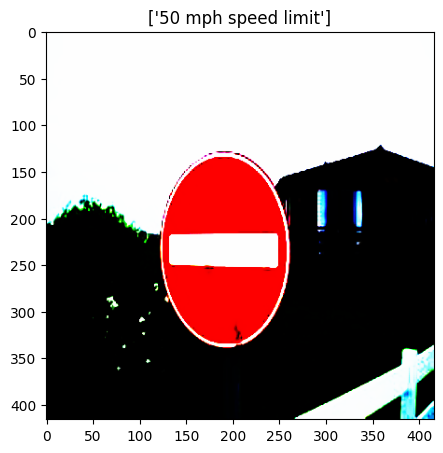

original prediction

0: 416x416 1 No Entry, 334.4ms
Speed: 0.0ms preprocess, 334.4ms inference, 3.2ms postprocess per image at shape (1, 3, 416, 416)
tensor([14])
tensor([14])
tensor([14])
tensor([14])
tensor([14])
tensor([14])
tensor([14])
tensor([14])
tensor([14])
tensor([14])
prediction after attack

0: 416x416 1 No Entry, 382.5ms
Speed: 0.0ms preprocess, 382.5ms inference, 4.2ms postprocess per image at shape (1, 3, 416, 416)


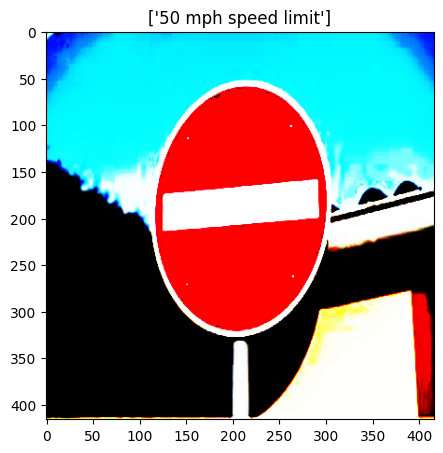

original prediction

0: 416x416 1 Truck traffic is prohibited, 375.2ms
Speed: 0.0ms preprocess, 375.2ms inference, 3.7ms postprocess per image at shape (1, 3, 416, 416)
tensor([15])
tensor([15])
tensor([15])
tensor([15])
tensor([15])
tensor([15])
tensor([15])
tensor([15])
tensor([15])
tensor([15])
prediction after attack

0: 416x416 1 Truck traffic is prohibited, 441.8ms
Speed: 0.0ms preprocess, 441.8ms inference, 4.0ms postprocess per image at shape (1, 3, 416, 416)


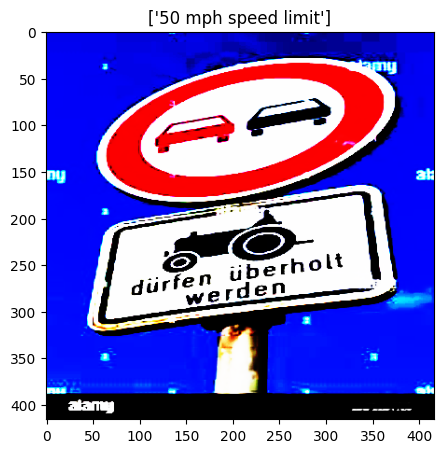

original prediction

0: 416x416 1 Stop_Sign, 456.2ms
Speed: 0.0ms preprocess, 456.2ms inference, 4.0ms postprocess per image at shape (1, 3, 416, 416)
tensor([15])
tensor([15])
tensor([15])
tensor([15])
tensor([15])
tensor([15])
tensor([15])
tensor([15])
tensor([15])
tensor([15])
prediction after attack

0: 416x416 (no detections), 294.1ms
Speed: 0.0ms preprocess, 294.1ms inference, 2.7ms postprocess per image at shape (1, 3, 416, 416)


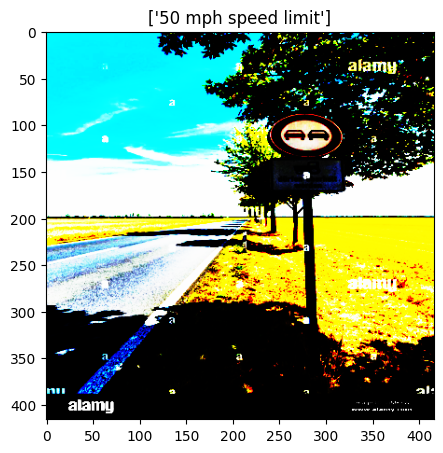

original prediction

0: 416x416 (no detections), 355.9ms
Speed: 0.0ms preprocess, 355.9ms inference, 2.8ms postprocess per image at shape (1, 3, 416, 416)
tensor([15])
tensor([15])
tensor([15])
tensor([15])
tensor([15])
tensor([15])
tensor([15])
tensor([15])
tensor([15])
tensor([15])
prediction after attack

0: 416x416 (no detections), 301.5ms
Speed: 0.0ms preprocess, 301.5ms inference, 2.9ms postprocess per image at shape (1, 3, 416, 416)


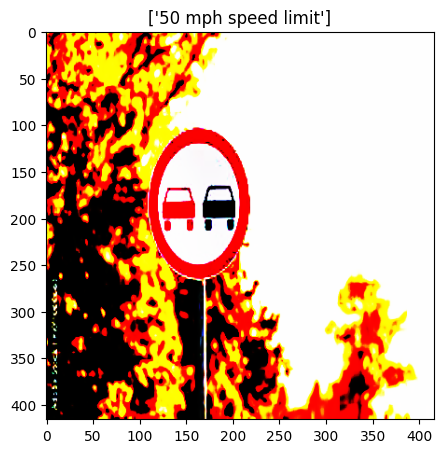

original prediction

0: 416x416 1 Truck traffic is prohibited, 350.2ms
Speed: 0.0ms preprocess, 350.2ms inference, 4.3ms postprocess per image at shape (1, 3, 416, 416)
tensor([15])
tensor([15])
tensor([15])
tensor([15])
tensor([15])
tensor([15])
tensor([15])
tensor([15])
tensor([15])
tensor([15])
prediction after attack

0: 416x416 1 Truck traffic is prohibited, 412.4ms
Speed: 0.0ms preprocess, 412.4ms inference, 3.8ms postprocess per image at shape (1, 3, 416, 416)


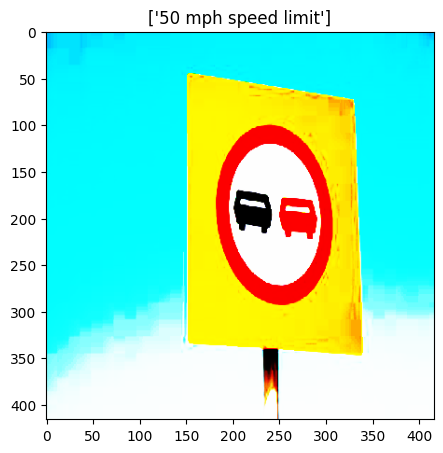

original prediction

0: 416x416 1 Stop_Sign, 1 Traffic_signal, 383.9ms
Speed: 0.0ms preprocess, 383.9ms inference, 4.2ms postprocess per image at shape (1, 3, 416, 416)
tensor([15])
tensor([15])
tensor([15])
tensor([15])
tensor([15])
tensor([15])
tensor([15])
tensor([15])
tensor([15])
tensor([15])
prediction after attack

0: 416x416 1 Traffic_signal, 317.0ms
Speed: 0.0ms preprocess, 317.0ms inference, 3.1ms postprocess per image at shape (1, 3, 416, 416)


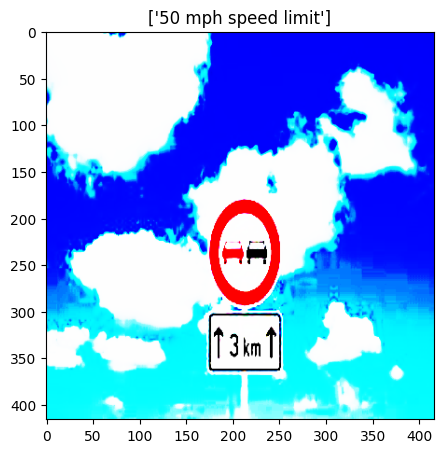

original prediction

0: 416x416 1 Stop_Sign, 1 Truck traffic is prohibited, 346.1ms
Speed: 0.0ms preprocess, 346.1ms inference, 3.2ms postprocess per image at shape (1, 3, 416, 416)
tensor([16])
tensor([16])
tensor([16])
tensor([16])
tensor([16])
tensor([16])
tensor([16])
tensor([16])
tensor([16])
tensor([16])
prediction after attack

0: 416x416 1 Truck traffic is prohibited, 302.3ms
Speed: 0.0ms preprocess, 302.3ms inference, 3.5ms postprocess per image at shape (1, 3, 416, 416)


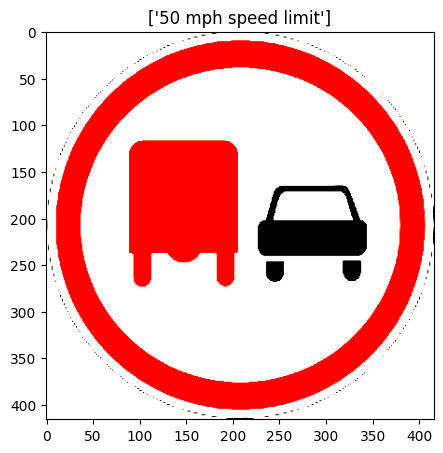

original prediction

0: 416x416 1 Attention Please-, 1 Stop_Sign, 342.1ms
Speed: 0.0ms preprocess, 342.1ms inference, 3.3ms postprocess per image at shape (1, 3, 416, 416)
tensor([16])
tensor([16])
tensor([16])
tensor([16])
tensor([16])
tensor([16])
tensor([16])
tensor([16])
tensor([16])
tensor([16])
prediction after attack

0: 416x416 1 50 mph speed limit, 1 Attention Please-, 400.5ms
Speed: 0.0ms preprocess, 400.5ms inference, 4.2ms postprocess per image at shape (1, 3, 416, 416)


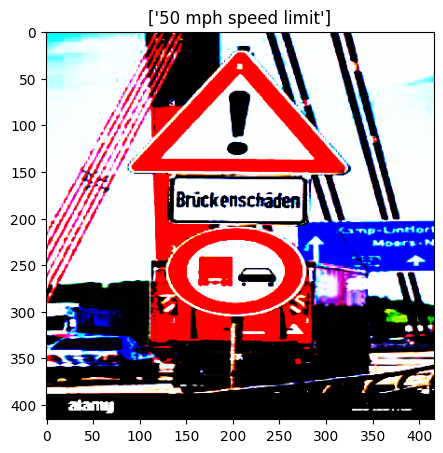

original prediction

0: 416x416 1 Attention Please-, 417.2ms
Speed: 0.0ms preprocess, 417.2ms inference, 4.1ms postprocess per image at shape (1, 3, 416, 416)
tensor([17])
tensor([17])
tensor([17])
tensor([17])
tensor([17])
tensor([17])
tensor([17])
tensor([17])
tensor([17])
tensor([17])
prediction after attack

0: 416x416 1 Pedestrian Crossing, 408.3ms
Speed: 0.0ms preprocess, 408.3ms inference, 4.1ms postprocess per image at shape (1, 3, 416, 416)


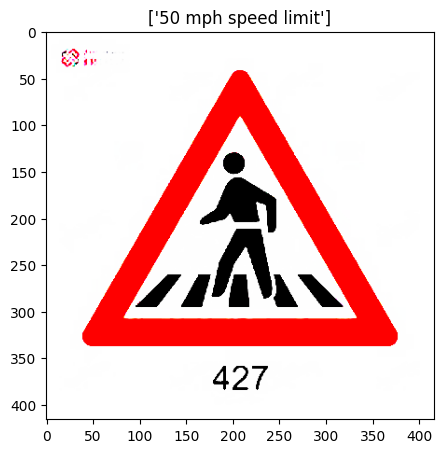

original prediction

0: 416x416 1 -Road narrows on right, 1 Beware of children, 1 Pedestrian Crossing, 409.3ms
Speed: 0.0ms preprocess, 409.3ms inference, 3.8ms postprocess per image at shape (1, 3, 416, 416)
tensor([17])
tensor([17])
tensor([17])
tensor([17])
tensor([17])
tensor([17])
tensor([17])
tensor([17])
tensor([17])
tensor([17])
prediction after attack

0: 416x416 1 Pedestrian Crossing, 289.9ms
Speed: 0.0ms preprocess, 289.9ms inference, 3.4ms postprocess per image at shape (1, 3, 416, 416)


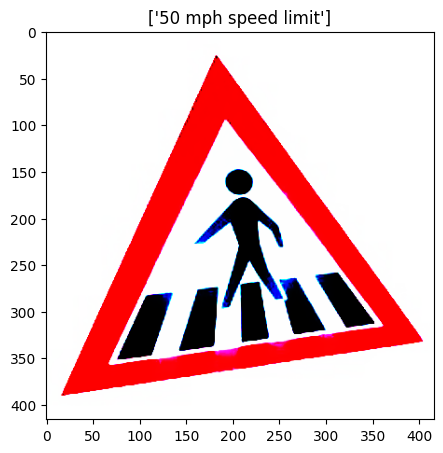

original prediction

0: 416x416 2 Traffic_signals, 351.3ms
Speed: 0.0ms preprocess, 351.3ms inference, 3.2ms postprocess per image at shape (1, 3, 416, 416)
tensor([17])
tensor([17])
tensor([17])
tensor([17])
tensor([17])
tensor([17])
tensor([17])
tensor([17])
tensor([17])
tensor([17])
prediction after attack

0: 416x416 (no detections), 306.2ms
Speed: 0.0ms preprocess, 306.2ms inference, 2.8ms postprocess per image at shape (1, 3, 416, 416)


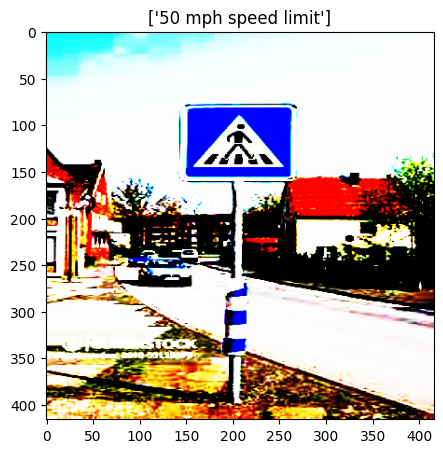

original prediction

0: 416x416 5 Traffic_signals, 352.6ms
Speed: 0.0ms preprocess, 352.6ms inference, 3.6ms postprocess per image at shape (1, 3, 416, 416)
tensor([17])
tensor([17])
tensor([17])
tensor([17])
tensor([17])
tensor([17])
tensor([17])
tensor([17])
tensor([17])
tensor([17])
prediction after attack

0: 416x416 (no detections), 422.0ms
Speed: 0.0ms preprocess, 422.0ms inference, 3.4ms postprocess per image at shape (1, 3, 416, 416)


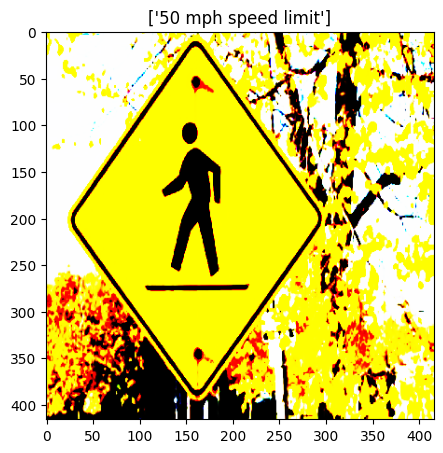

original prediction

0: 416x416 1 Traffic_signal, 397.6ms
Speed: 0.0ms preprocess, 397.6ms inference, 4.1ms postprocess per image at shape (1, 3, 416, 416)
tensor([17])
tensor([17])
tensor([17])
tensor([17])
tensor([17])
tensor([17])
tensor([17])
tensor([17])
tensor([17])
tensor([17])
prediction after attack

0: 416x416 (no detections), 371.1ms
Speed: 0.0ms preprocess, 371.1ms inference, 3.4ms postprocess per image at shape (1, 3, 416, 416)


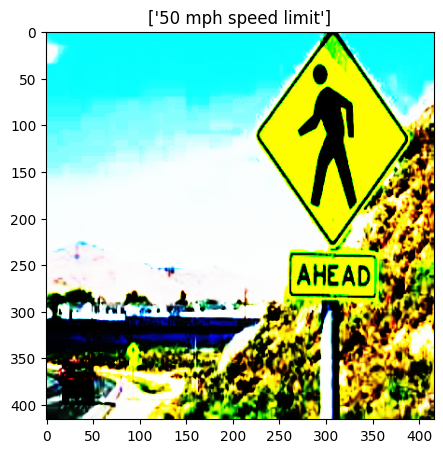

original prediction

0: 416x416 (no detections), 386.8ms
Speed: 0.0ms preprocess, 386.8ms inference, 2.8ms postprocess per image at shape (1, 3, 416, 416)
tensor([18])
tensor([18])
tensor([18])
tensor([18])
tensor([18])
tensor([18])
tensor([18])
tensor([18])
tensor([18])
tensor([18])
prediction after attack

0: 416x416 1 Go straight or turn left, 306.1ms
Speed: 0.0ms preprocess, 306.1ms inference, 3.2ms postprocess per image at shape (1, 3, 416, 416)


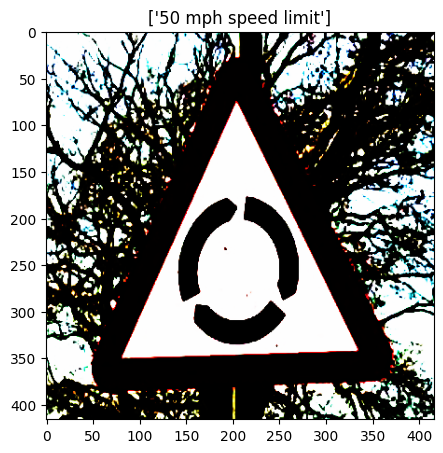

original prediction

0: 416x416 4 Traffic_signals, 359.1ms
Speed: 0.0ms preprocess, 359.1ms inference, 3.2ms postprocess per image at shape (1, 3, 416, 416)
tensor([18])
tensor([18])
tensor([18])
tensor([18])
tensor([18])
tensor([18])
tensor([18])
tensor([18])
tensor([18])
tensor([18])
prediction after attack

0: 416x416 1 Traffic_signal, 387.5ms
Speed: 0.0ms preprocess, 387.5ms inference, 4.1ms postprocess per image at shape (1, 3, 416, 416)


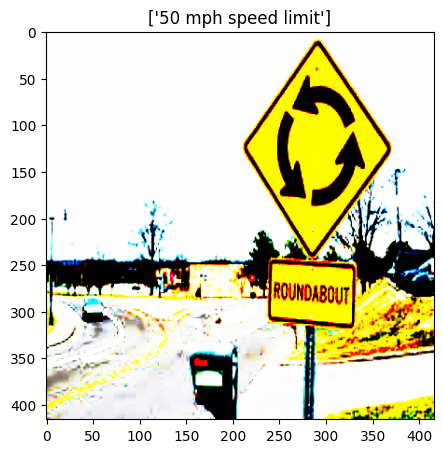

original prediction

0: 416x416 1 Stop_Sign, 390.2ms
Speed: 0.0ms preprocess, 390.2ms inference, 4.3ms postprocess per image at shape (1, 3, 416, 416)
tensor([18])
tensor([18])
tensor([18])
tensor([18])
tensor([18])
tensor([18])
tensor([18])
tensor([18])
tensor([18])
tensor([18])
prediction after attack

0: 416x416 (no detections), 470.7ms
Speed: 0.0ms preprocess, 470.7ms inference, 5.4ms postprocess per image at shape (1, 3, 416, 416)


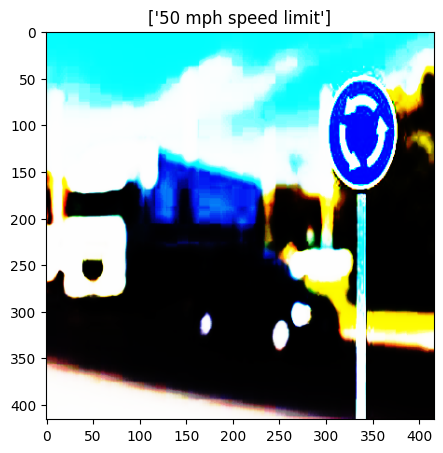

original prediction

0: 416x416 6 Traffic_signals, 413.2ms
Speed: 0.0ms preprocess, 413.2ms inference, 4.6ms postprocess per image at shape (1, 3, 416, 416)
tensor([18])
tensor([18])
tensor([18])
tensor([18])
tensor([18])
tensor([18])
tensor([18])
tensor([18])
tensor([18])
tensor([18])
prediction after attack

0: 416x416 1 Give Way, 377.7ms
Speed: 0.0ms preprocess, 377.7ms inference, 3.8ms postprocess per image at shape (1, 3, 416, 416)


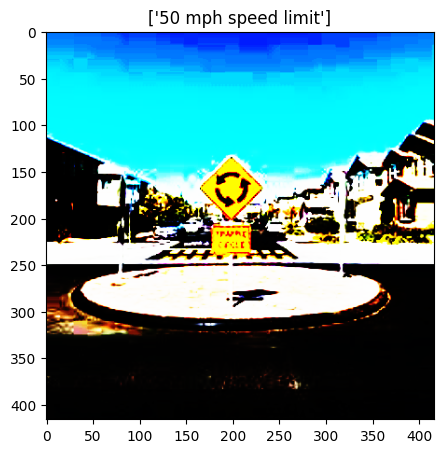

original prediction

0: 416x416 (no detections), 399.0ms
Speed: 0.0ms preprocess, 399.0ms inference, 3.6ms postprocess per image at shape (1, 3, 416, 416)
tensor([18])
tensor([18])
tensor([18])
tensor([18])
tensor([18])
tensor([18])
tensor([18])
tensor([18])
tensor([18])
tensor([18])
prediction after attack

0: 416x416 1 CYCLE ROUTE AHEAD WARNING, 1 Dangerous Rright Curve Ahead, 325.6ms
Speed: 0.0ms preprocess, 325.6ms inference, 3.0ms postprocess per image at shape (1, 3, 416, 416)


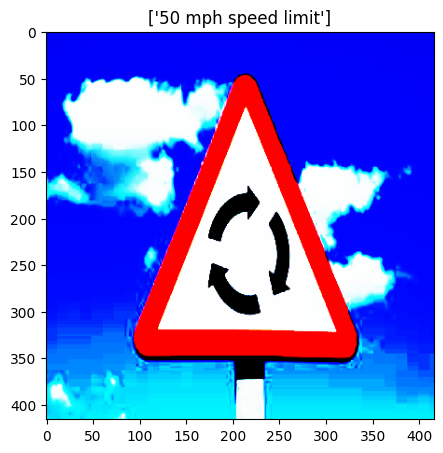

original prediction

0: 416x416 1 Dangerous Rright Curve Ahead, 362.1ms
Speed: 0.0ms preprocess, 362.1ms inference, 3.0ms postprocess per image at shape (1, 3, 416, 416)
tensor([18])
tensor([18])
tensor([18])
tensor([18])
tensor([18])
tensor([18])
tensor([18])
tensor([18])
tensor([18])
tensor([18])
prediction after attack

0: 416x416 1 Dangerous Rright Curve Ahead, 366.2ms
Speed: 0.0ms preprocess, 366.2ms inference, 4.1ms postprocess per image at shape (1, 3, 416, 416)


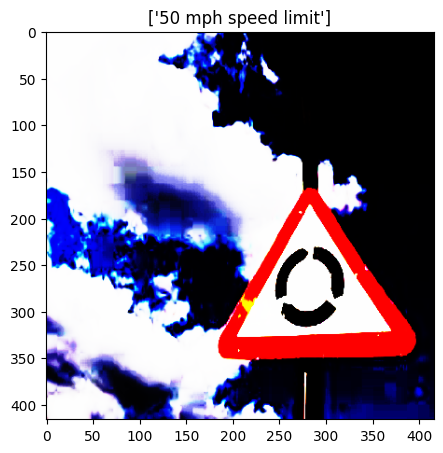

original prediction

0: 416x416 (no detections), 392.5ms
Speed: 0.0ms preprocess, 392.5ms inference, 3.4ms postprocess per image at shape (1, 3, 416, 416)
tensor([18])
tensor([18])
tensor([18])
tensor([18])
tensor([18])
tensor([18])
tensor([18])
tensor([18])
tensor([18])
tensor([18])
prediction after attack

0: 416x416 1 Give Way, 381.8ms
Speed: 0.0ms preprocess, 381.8ms inference, 3.8ms postprocess per image at shape (1, 3, 416, 416)


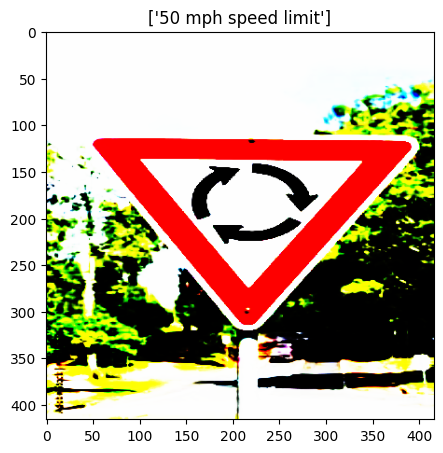

original prediction

0: 416x416 2 Dangerous Rright Curve Aheads, 1 Traffic_signal, 391.0ms
Speed: 0.0ms preprocess, 391.0ms inference, 3.8ms postprocess per image at shape (1, 3, 416, 416)
tensor([19])
tensor([19])
tensor([19])
tensor([19])
tensor([19])
tensor([19])
tensor([19])
tensor([19])
tensor([19])
tensor([19])
prediction after attack

0: 416x416 1 Slippery Road Ahead, 377.6ms
Speed: 0.0ms preprocess, 377.6ms inference, 4.1ms postprocess per image at shape (1, 3, 416, 416)


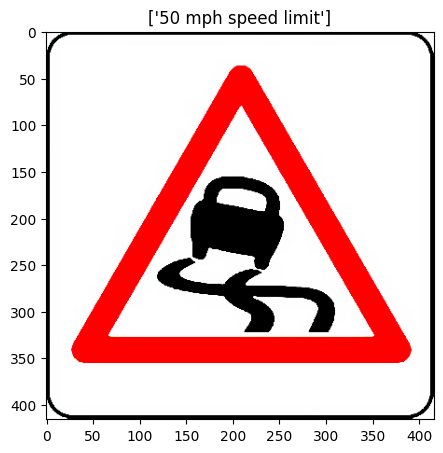

original prediction

0: 416x416 1 Dangerous Left Curve Ahead, 1 Dangerous Rright Curve Ahead, 365.2ms
Speed: 0.0ms preprocess, 365.2ms inference, 3.7ms postprocess per image at shape (1, 3, 416, 416)
tensor([19])
tensor([19])
tensor([19])
tensor([19])
tensor([19])
tensor([19])
tensor([19])
tensor([19])
tensor([19])
tensor([19])
prediction after attack

0: 416x416 1 Slippery Road Ahead, 443.8ms
Speed: 0.0ms preprocess, 443.8ms inference, 3.8ms postprocess per image at shape (1, 3, 416, 416)


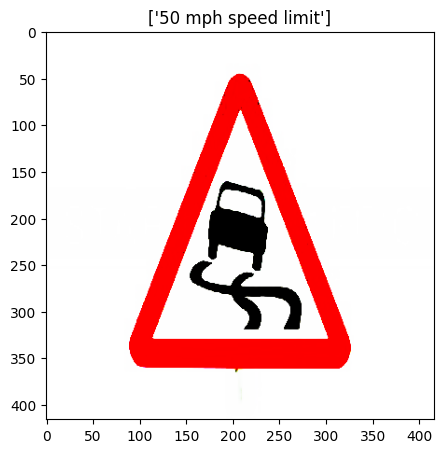

original prediction

0: 416x416 2 Traffic_signals, 401.9ms
Speed: 0.0ms preprocess, 401.9ms inference, 4.0ms postprocess per image at shape (1, 3, 416, 416)
tensor([19])
tensor([19])
tensor([19])
tensor([19])
tensor([19])
tensor([19])
tensor([19])
tensor([19])
tensor([19])
tensor([19])
prediction after attack

0: 416x416 (no detections), 474.1ms
Speed: 0.0ms preprocess, 474.1ms inference, 3.3ms postprocess per image at shape (1, 3, 416, 416)


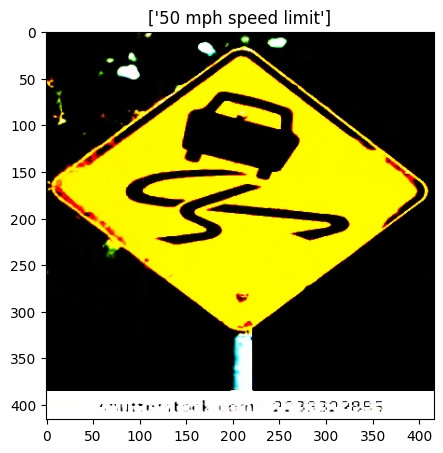

original prediction

0: 416x416 4 Traffic_signals, 367.5ms
Speed: 0.0ms preprocess, 367.5ms inference, 3.7ms postprocess per image at shape (1, 3, 416, 416)
tensor([19])
tensor([19])
tensor([19])
tensor([19])
tensor([19])
tensor([19])
tensor([19])
tensor([19])
tensor([19])
tensor([19])
prediction after attack

0: 416x416 (no detections), 382.3ms
Speed: 0.0ms preprocess, 382.3ms inference, 7.7ms postprocess per image at shape (1, 3, 416, 416)


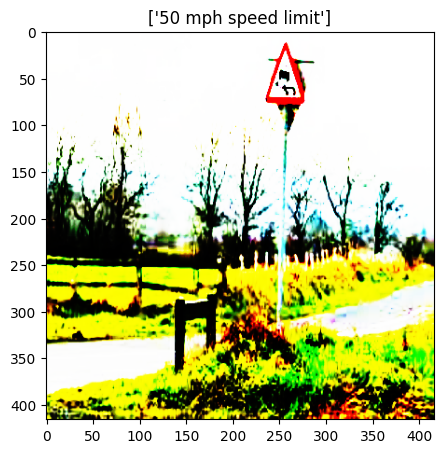

original prediction

0: 416x416 (no detections), 371.5ms
Speed: 0.0ms preprocess, 371.5ms inference, 3.5ms postprocess per image at shape (1, 3, 416, 416)
tensor([19])
tensor([19])
tensor([19])
tensor([19])
tensor([19])
tensor([19])
tensor([19])
tensor([19])
tensor([19])
tensor([19])
prediction after attack

0: 416x416 (no detections), 376.8ms
Speed: 0.0ms preprocess, 376.8ms inference, 3.6ms postprocess per image at shape (1, 3, 416, 416)


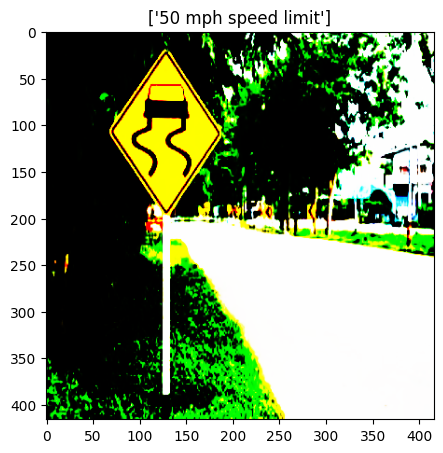

original prediction

0: 416x416 (no detections), 372.5ms
Speed: 0.0ms preprocess, 372.5ms inference, 3.3ms postprocess per image at shape (1, 3, 416, 416)
tensor([19])
tensor([19])
tensor([19])
tensor([19])
tensor([19])
tensor([19])
tensor([19])
tensor([19])
tensor([19])
tensor([19])
prediction after attack

0: 416x416 1 Slippery Road Ahead, 459.1ms
Speed: 0.0ms preprocess, 459.1ms inference, 3.8ms postprocess per image at shape (1, 3, 416, 416)


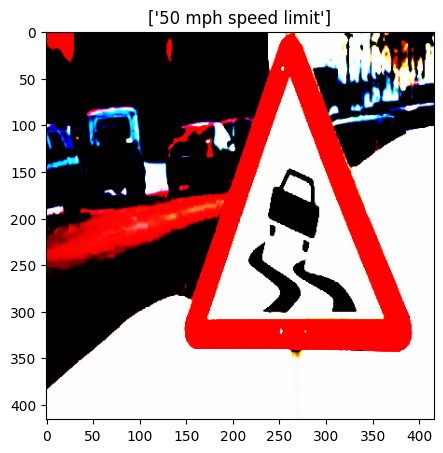

original prediction

0: 416x416 1 Slippery Road Ahead, 477.4ms
Speed: 0.0ms preprocess, 477.4ms inference, 4.3ms postprocess per image at shape (1, 3, 416, 416)
tensor([19])
tensor([19])
tensor([19])
tensor([19])
tensor([19])
tensor([19])
tensor([19])
tensor([19])
tensor([19])
tensor([19])
prediction after attack

0: 416x416 (no detections), 365.3ms
Speed: 0.0ms preprocess, 365.3ms inference, 3.3ms postprocess per image at shape (1, 3, 416, 416)


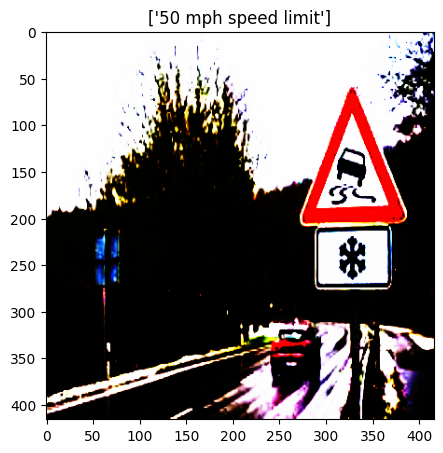

original prediction

0: 416x416 (no detections), 384.7ms
Speed: 0.0ms preprocess, 384.7ms inference, 3.5ms postprocess per image at shape (1, 3, 416, 416)
tensor([20])
tensor([20])
tensor([20])
tensor([20])
tensor([20])
tensor([20])
tensor([20])
tensor([20])
tensor([20])
tensor([20])
prediction after attack

0: 416x416 (no detections), 426.6ms
Speed: 0.0ms preprocess, 426.6ms inference, 6.4ms postprocess per image at shape (1, 3, 416, 416)


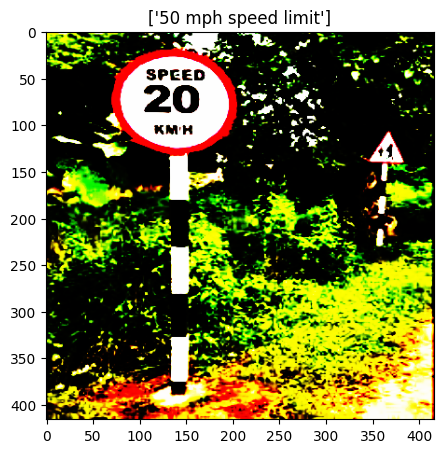

original prediction

0: 416x416 1 Speed Limit 20 KMPh, 405.5ms
Speed: 0.0ms preprocess, 405.5ms inference, 3.8ms postprocess per image at shape (1, 3, 416, 416)
tensor([20])
tensor([20])
tensor([20])
tensor([20])
tensor([20])
tensor([20])
tensor([20])
tensor([20])
tensor([20])
tensor([20])
prediction after attack

0: 416x416 1 Speed Limit 20 KMPh, 411.7ms
Speed: 0.0ms preprocess, 411.7ms inference, 4.0ms postprocess per image at shape (1, 3, 416, 416)


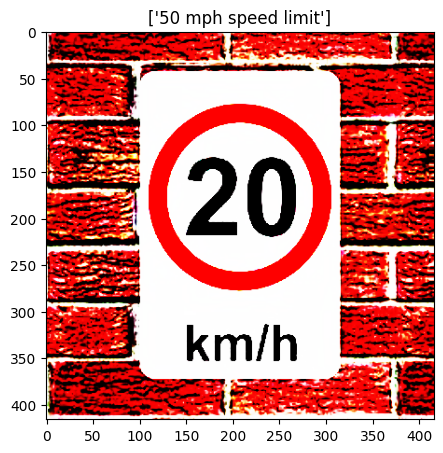

original prediction

0: 416x416 1 Stop_Sign, 414.1ms
Speed: 0.0ms preprocess, 414.1ms inference, 3.8ms postprocess per image at shape (1, 3, 416, 416)
tensor([20])
tensor([20])
tensor([20])
tensor([20])
tensor([20])
tensor([20])
tensor([20])
tensor([20])
tensor([20])
tensor([20])
prediction after attack

0: 416x416 1 Stop_Sign, 1 Traffic_signal, 377.7ms
Speed: 0.0ms preprocess, 377.7ms inference, 3.9ms postprocess per image at shape (1, 3, 416, 416)


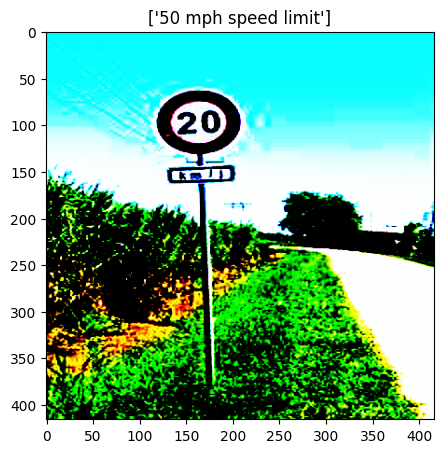

original prediction

0: 416x416 1 Traffic_signal, 399.7ms
Speed: 0.0ms preprocess, 399.7ms inference, 3.9ms postprocess per image at shape (1, 3, 416, 416)
tensor([20])
tensor([20])
tensor([20])
tensor([20])
tensor([20])
tensor([20])
tensor([20])
tensor([20])
tensor([20])
tensor([20])
prediction after attack

0: 416x416 1 Stop_Sign, 374.8ms
Speed: 0.0ms preprocess, 374.8ms inference, 4.1ms postprocess per image at shape (1, 3, 416, 416)


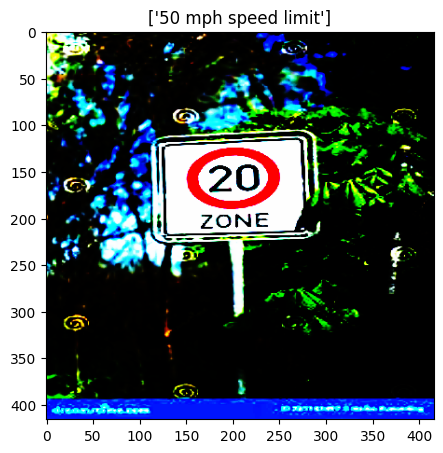

original prediction

0: 416x416 1 Stop_Sign, 386.3ms
Speed: 0.0ms preprocess, 386.3ms inference, 3.8ms postprocess per image at shape (1, 3, 416, 416)
tensor([20])
tensor([20])
tensor([20])
tensor([20])
tensor([20])
tensor([20])
tensor([20])
tensor([20])
tensor([20])
tensor([20])
prediction after attack

0: 416x416 1 50 mph speed limit, 404.3ms
Speed: 0.0ms preprocess, 404.3ms inference, 3.9ms postprocess per image at shape (1, 3, 416, 416)


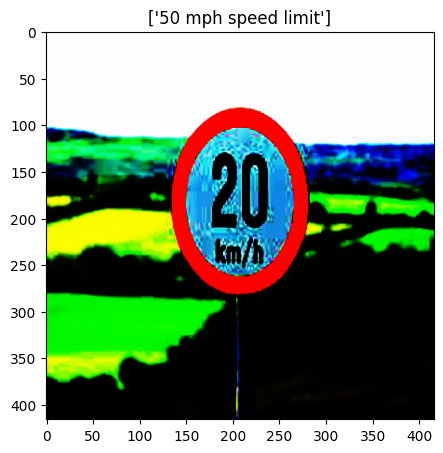

original prediction

0: 416x416 1 Stop_Sign, 385.8ms
Speed: 0.0ms preprocess, 385.8ms inference, 3.8ms postprocess per image at shape (1, 3, 416, 416)
tensor([20])
tensor([20])
tensor([20])
tensor([20])
tensor([20])
tensor([20])
tensor([20])
tensor([20])
tensor([20])
tensor([20])
prediction after attack

0: 416x416 1 Stop_Sign, 389.4ms
Speed: 0.0ms preprocess, 389.4ms inference, 4.5ms postprocess per image at shape (1, 3, 416, 416)


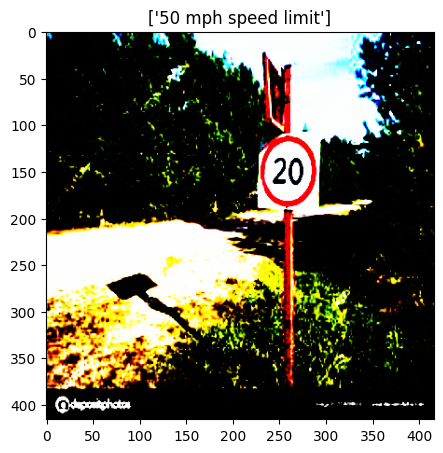

original prediction

0: 416x416 1 Truck traffic is prohibited, 371.4ms
Speed: 0.0ms preprocess, 371.4ms inference, 3.8ms postprocess per image at shape (1, 3, 416, 416)
tensor([20])
tensor([20])
tensor([20])
tensor([20])
tensor([20])
tensor([20])
tensor([20])
tensor([20])
tensor([20])
tensor([20])
prediction after attack

0: 416x416 1 50 mph speed limit, 1 Speed Limit 20 KMPh, 371.4ms
Speed: 0.0ms preprocess, 371.4ms inference, 4.5ms postprocess per image at shape (1, 3, 416, 416)


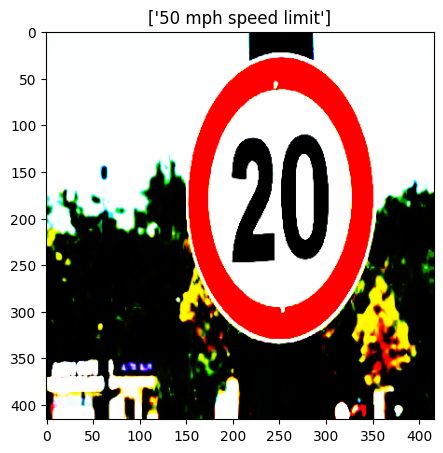

original prediction

0: 416x416 1 50 mph speed limit, 394.0ms
Speed: 0.0ms preprocess, 394.0ms inference, 3.9ms postprocess per image at shape (1, 3, 416, 416)
tensor([21])
tensor([21])
tensor([21])
tensor([21])
tensor([21])
tensor([21])
tensor([21])
tensor([21])
tensor([21])
tensor([21])
prediction after attack

0: 416x416 1 50 mph speed limit, 423.6ms
Speed: 0.0ms preprocess, 423.6ms inference, 6.7ms postprocess per image at shape (1, 3, 416, 416)


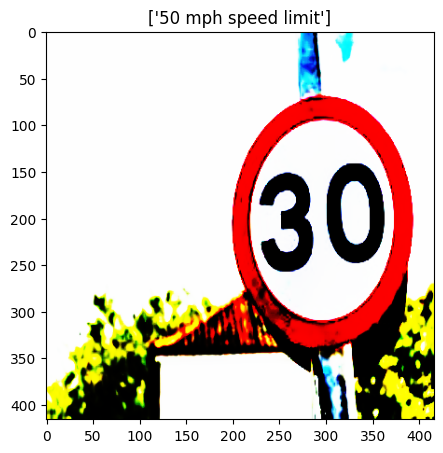

original prediction

0: 416x416 (no detections), 371.6ms
Speed: 0.0ms preprocess, 371.6ms inference, 3.6ms postprocess per image at shape (1, 3, 416, 416)
tensor([21])
tensor([21])
tensor([21])
tensor([21])
tensor([21])
tensor([21])
tensor([21])
tensor([21])
tensor([21])
tensor([21])
prediction after attack

0: 416x416 1 50 mph speed limit, 379.4ms
Speed: 0.0ms preprocess, 379.4ms inference, 3.8ms postprocess per image at shape (1, 3, 416, 416)


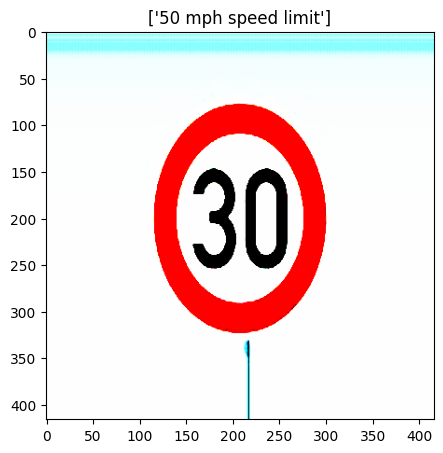

original prediction

0: 416x416 1 Truck traffic is prohibited, 378.0ms
Speed: 0.0ms preprocess, 378.0ms inference, 3.9ms postprocess per image at shape (1, 3, 416, 416)
tensor([21])
tensor([21])
tensor([21])
tensor([21])
tensor([21])
tensor([21])
tensor([21])
tensor([21])
tensor([21])
tensor([21])
prediction after attack

0: 416x416 1 50 mph speed limit, 380.4ms
Speed: 0.0ms preprocess, 380.4ms inference, 4.2ms postprocess per image at shape (1, 3, 416, 416)


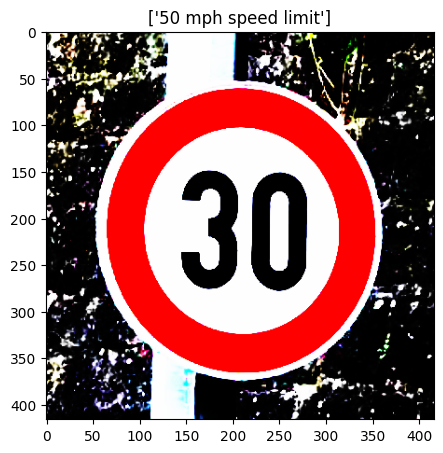

original prediction

0: 416x416 1 Stop_Sign, 366.8ms
Speed: 0.0ms preprocess, 366.8ms inference, 3.8ms postprocess per image at shape (1, 3, 416, 416)
tensor([21])
tensor([21])
tensor([21])
tensor([21])
tensor([21])
tensor([21])
tensor([21])
tensor([21])
tensor([21])
tensor([21])
prediction after attack

0: 416x416 1 50 mph speed limit, 367.3ms
Speed: 0.0ms preprocess, 367.3ms inference, 4.1ms postprocess per image at shape (1, 3, 416, 416)


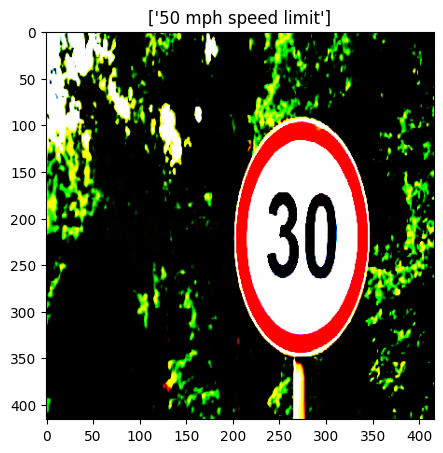

original prediction

0: 416x416 1 Stop_Sign, 472.0ms
Speed: 0.1ms preprocess, 472.0ms inference, 4.0ms postprocess per image at shape (1, 3, 416, 416)
tensor([22])
tensor([22])
tensor([22])
tensor([22])
tensor([22])
tensor([22])
tensor([22])
tensor([22])
tensor([22])
tensor([22])
prediction after attack

0: 416x416 1 Stop_Sign, 387.4ms
Speed: 0.0ms preprocess, 387.4ms inference, 3.9ms postprocess per image at shape (1, 3, 416, 416)


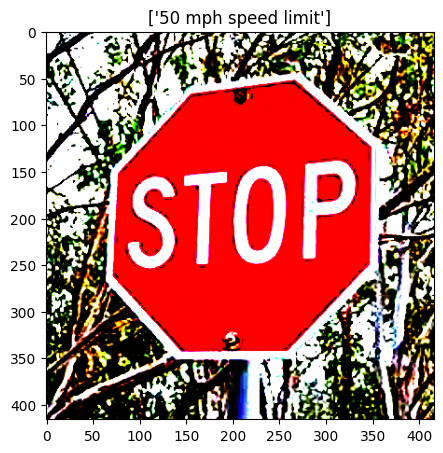

original prediction

0: 416x416 1 Stop_Sign, 417.9ms
Speed: 0.0ms preprocess, 417.9ms inference, 4.3ms postprocess per image at shape (1, 3, 416, 416)
tensor([22])
tensor([22])
tensor([22])
tensor([22])
tensor([22])
tensor([22])
tensor([22])
tensor([22])
tensor([22])
tensor([22])
prediction after attack

0: 416x416 1 Stop_Sign, 369.5ms
Speed: 0.0ms preprocess, 369.5ms inference, 3.8ms postprocess per image at shape (1, 3, 416, 416)


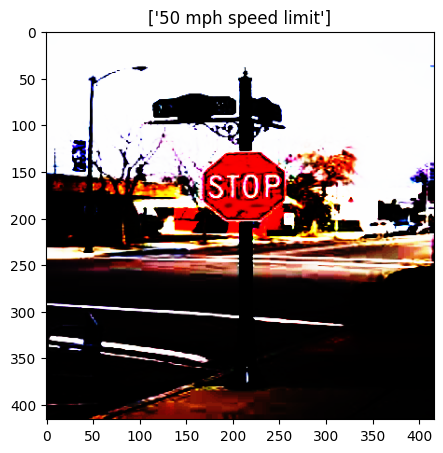

original prediction

0: 416x416 1 Stop_Sign, 370.3ms
Speed: 0.0ms preprocess, 370.3ms inference, 4.1ms postprocess per image at shape (1, 3, 416, 416)
tensor([22])
tensor([22])
tensor([22])
tensor([22])
tensor([22])
tensor([22])
tensor([22])
tensor([22])
tensor([22])
tensor([22])
prediction after attack

0: 416x416 1 Stop_Sign, 430.5ms
Speed: 0.0ms preprocess, 430.5ms inference, 4.0ms postprocess per image at shape (1, 3, 416, 416)


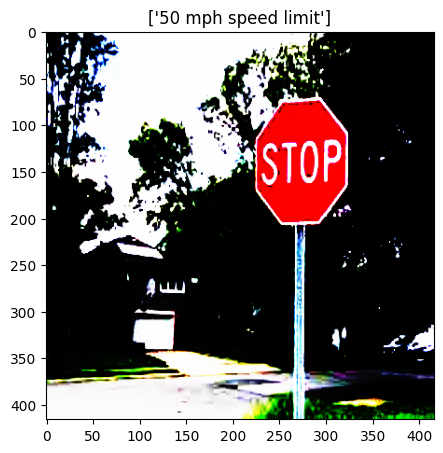

original prediction

0: 416x416 1 Stop_Sign, 406.0ms
Speed: 0.0ms preprocess, 406.0ms inference, 4.8ms postprocess per image at shape (1, 3, 416, 416)
tensor([22])
tensor([22])
tensor([22])
tensor([22])
tensor([22])
tensor([22])
tensor([22])
tensor([22])
tensor([22])
tensor([22])
prediction after attack

0: 416x416 1 Stop_Sign, 407.0ms
Speed: 0.0ms preprocess, 407.0ms inference, 6.2ms postprocess per image at shape (1, 3, 416, 416)


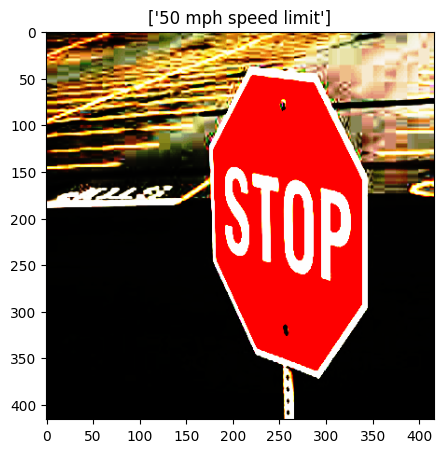

original prediction

0: 416x416 1 Stop_Sign, 472.9ms
Speed: 0.0ms preprocess, 472.9ms inference, 4.1ms postprocess per image at shape (1, 3, 416, 416)
tensor([22])
tensor([22])
tensor([22])
tensor([22])
tensor([22])
tensor([22])
tensor([22])
tensor([22])
tensor([22])
tensor([22])
prediction after attack

0: 416x416 1 Stop_Sign, 382.9ms
Speed: 0.0ms preprocess, 382.9ms inference, 3.9ms postprocess per image at shape (1, 3, 416, 416)


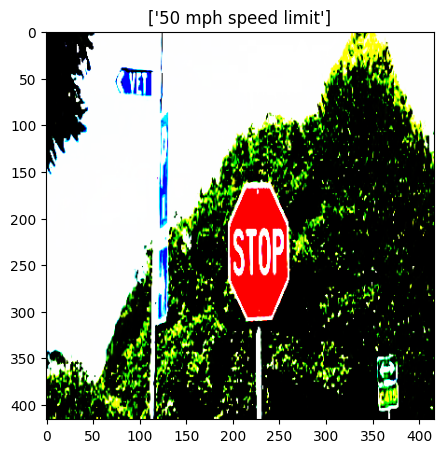

original prediction

0: 416x416 2 Stop_Signs, 388.6ms
Speed: 0.0ms preprocess, 388.6ms inference, 5.3ms postprocess per image at shape (1, 3, 416, 416)
tensor([22])
tensor([22])
tensor([22])
tensor([22])
tensor([22])
tensor([22])
tensor([22])
tensor([22])
tensor([22])
tensor([22])
prediction after attack

0: 416x416 1 Stop_Sign, 406.3ms
Speed: 0.0ms preprocess, 406.3ms inference, 7.0ms postprocess per image at shape (1, 3, 416, 416)


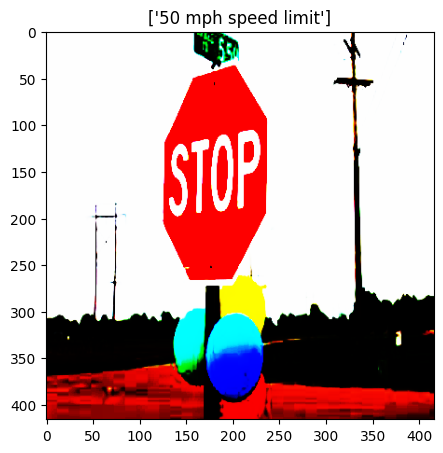

original prediction

0: 416x416 2 Traffic_signals, 407.3ms
Speed: 0.0ms preprocess, 407.3ms inference, 3.8ms postprocess per image at shape (1, 3, 416, 416)
tensor([23])
tensor([23])
tensor([23])
tensor([23])
tensor([23])
tensor([23])
tensor([23])
tensor([23])
tensor([23])
tensor([23])
prediction after attack

0: 416x416 (no detections), 459.2ms
Speed: 0.0ms preprocess, 459.2ms inference, 3.9ms postprocess per image at shape (1, 3, 416, 416)


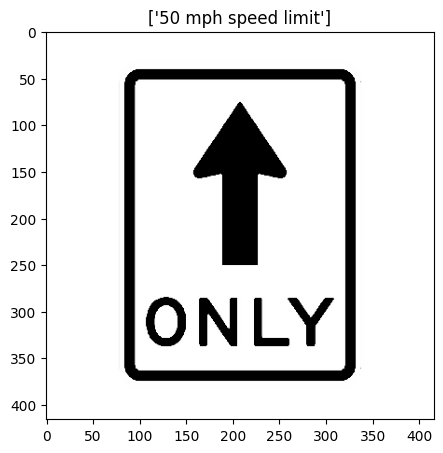

original prediction

0: 416x416 1 Straight Ahead Only, 451.8ms
Speed: 0.0ms preprocess, 451.8ms inference, 3.9ms postprocess per image at shape (1, 3, 416, 416)
tensor([23])
tensor([23])
tensor([23])
tensor([23])
tensor([23])
tensor([23])
tensor([23])
tensor([23])
tensor([23])
tensor([23])
prediction after attack

0: 416x416 1 Straight Ahead Only, 368.7ms
Speed: 0.0ms preprocess, 368.7ms inference, 3.8ms postprocess per image at shape (1, 3, 416, 416)


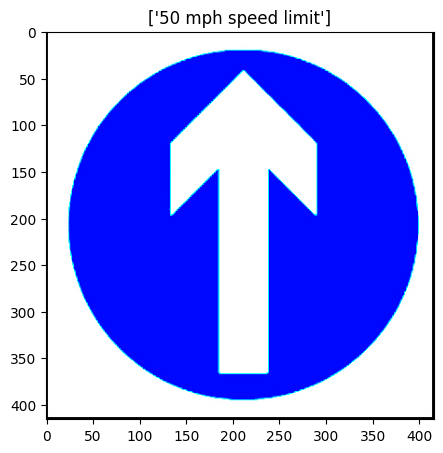

original prediction

0: 416x416 (no detections), 360.3ms
Speed: 0.0ms preprocess, 360.3ms inference, 3.5ms postprocess per image at shape (1, 3, 416, 416)
tensor([23])
tensor([23])
tensor([23])
tensor([23])
tensor([23])
tensor([23])
tensor([23])
tensor([23])
tensor([23])
tensor([23])
prediction after attack

0: 416x416 (no detections), 369.3ms
Speed: 0.0ms preprocess, 369.3ms inference, 3.3ms postprocess per image at shape (1, 3, 416, 416)


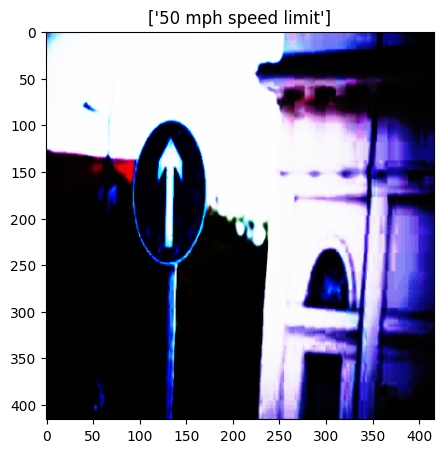

original prediction

0: 416x416 1 Dangerous Rright Curve Ahead, 1 Traffic_signal, 368.1ms
Speed: 0.0ms preprocess, 368.1ms inference, 3.8ms postprocess per image at shape (1, 3, 416, 416)
tensor([24])
tensor([24])
tensor([24])
tensor([24])
tensor([24])
tensor([24])
tensor([24])
tensor([24])
tensor([24])
tensor([24])
prediction after attack

0: 416x416 1 Pedestrian Crossing, 370.8ms
Speed: 0.0ms preprocess, 370.8ms inference, 3.8ms postprocess per image at shape (1, 3, 416, 416)


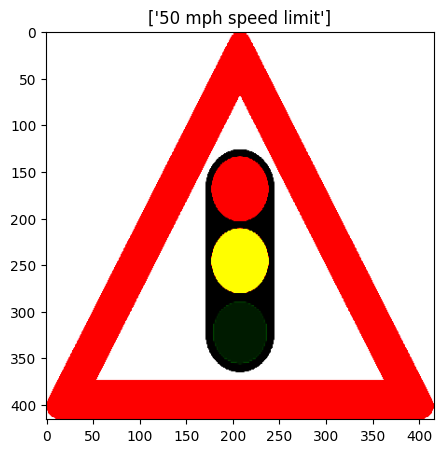

original prediction

0: 416x416 2 Traffic_signals, 437.7ms
Speed: 0.0ms preprocess, 437.7ms inference, 3.6ms postprocess per image at shape (1, 3, 416, 416)
tensor([24])
tensor([24])
tensor([24])
tensor([24])
tensor([24])
tensor([24])
tensor([24])
tensor([24])
tensor([24])
tensor([24])
prediction after attack

0: 416x416 1 Traffic_signal, 392.7ms
Speed: 0.0ms preprocess, 392.7ms inference, 4.1ms postprocess per image at shape (1, 3, 416, 416)


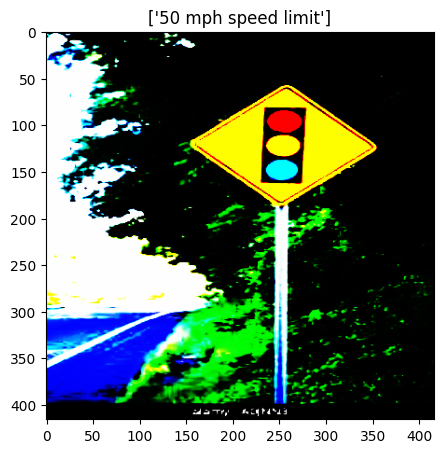

original prediction

0: 416x416 1 Traffic_signal, 375.0ms
Speed: 0.0ms preprocess, 375.0ms inference, 3.8ms postprocess per image at shape (1, 3, 416, 416)
tensor([24])
tensor([24])
tensor([24])
tensor([24])
tensor([24])
tensor([24])
tensor([24])
tensor([24])
tensor([24])
tensor([24])
prediction after attack

0: 416x416 (no detections), 376.9ms
Speed: 0.0ms preprocess, 376.9ms inference, 3.3ms postprocess per image at shape (1, 3, 416, 416)


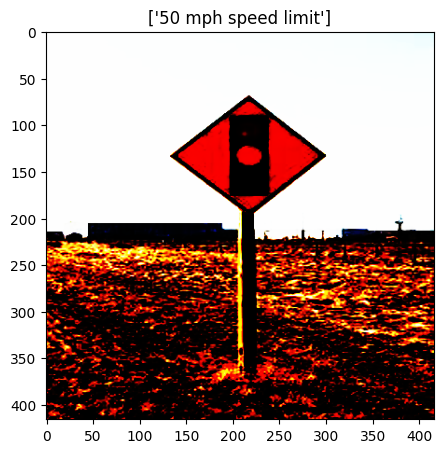

original prediction

0: 416x416 1 Truck traffic is prohibited, 396.1ms
Speed: 0.0ms preprocess, 396.1ms inference, 4.1ms postprocess per image at shape (1, 3, 416, 416)
tensor([25])
tensor([25])
tensor([25])
tensor([25])
tensor([25])
tensor([25])
tensor([25])
tensor([25])
tensor([25])
tensor([25])
prediction after attack

0: 416x416 1 Truck traffic is prohibited, 369.6ms
Speed: 0.0ms preprocess, 369.6ms inference, 4.2ms postprocess per image at shape (1, 3, 416, 416)


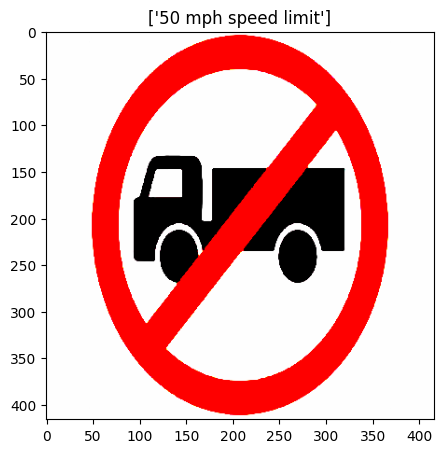

original prediction

0: 416x416 1 Traffic_signal, 427.4ms
Speed: 0.0ms preprocess, 427.4ms inference, 4.0ms postprocess per image at shape (1, 3, 416, 416)
tensor([25])
tensor([25])
tensor([25])
tensor([25])
tensor([25])
tensor([25])
tensor([25])
tensor([25])
tensor([25])
tensor([25])
prediction after attack

0: 416x416 1 Traffic_signal, 452.1ms
Speed: 0.0ms preprocess, 452.1ms inference, 4.1ms postprocess per image at shape (1, 3, 416, 416)


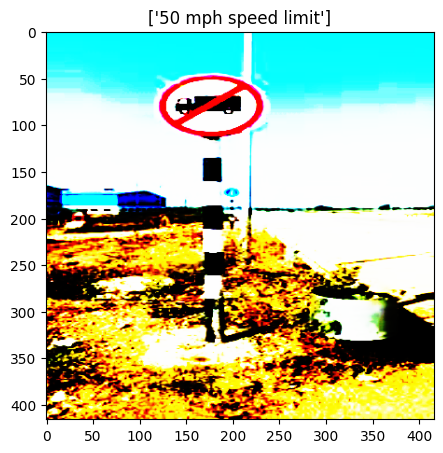

original prediction

0: 416x416 1 Truck traffic is prohibited, 369.9ms
Speed: 0.0ms preprocess, 369.9ms inference, 3.8ms postprocess per image at shape (1, 3, 416, 416)
tensor([25])
tensor([25])
tensor([25])
tensor([25])
tensor([25])
tensor([25])
tensor([25])
tensor([25])
tensor([25])
tensor([25])
prediction after attack

0: 416x416 1 Truck traffic is prohibited, 363.1ms
Speed: 0.0ms preprocess, 363.1ms inference, 3.8ms postprocess per image at shape (1, 3, 416, 416)


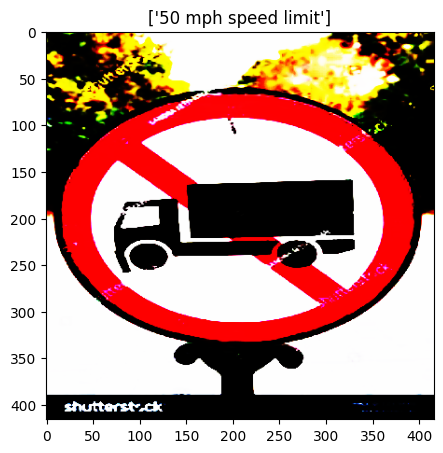

original prediction

0: 416x416 1 Truck traffic is prohibited, 365.8ms
Speed: 0.0ms preprocess, 365.8ms inference, 3.8ms postprocess per image at shape (1, 3, 416, 416)
tensor([26])
tensor([26])
tensor([26])
tensor([26])
tensor([26])
tensor([26])
tensor([26])
tensor([26])
tensor([26])
tensor([26])
prediction after attack

0: 416x416 1 50 mph speed limit, 424.5ms
Speed: 0.0ms preprocess, 424.5ms inference, 4.0ms postprocess per image at shape (1, 3, 416, 416)


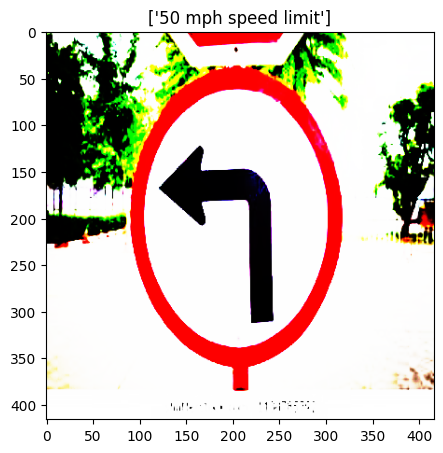

original prediction

0: 416x416 1 Stop_Sign, 461.6ms
Speed: 0.1ms preprocess, 461.6ms inference, 3.8ms postprocess per image at shape (1, 3, 416, 416)
tensor([26])
tensor([26])
tensor([26])
tensor([26])
tensor([26])
tensor([26])
tensor([26])
tensor([26])
tensor([26])
tensor([26])
prediction after attack

0: 416x416 1 Stop_Sign, 435.3ms
Speed: 0.0ms preprocess, 435.3ms inference, 4.9ms postprocess per image at shape (1, 3, 416, 416)


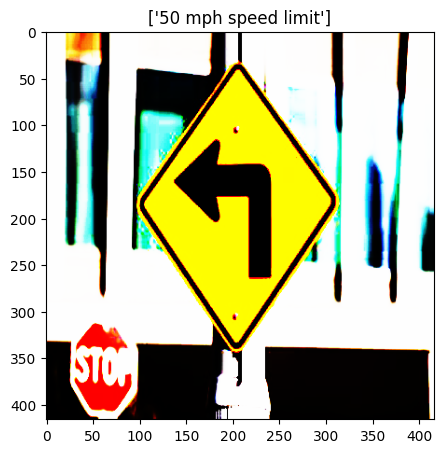

original prediction

0: 416x416 1 Traffic_signal, 376.8ms
Speed: 0.0ms preprocess, 376.8ms inference, 4.0ms postprocess per image at shape (1, 3, 416, 416)
tensor([26])
tensor([26])
tensor([26])
tensor([26])
tensor([26])
tensor([26])
tensor([26])
tensor([26])
tensor([26])
tensor([26])
prediction after attack

0: 416x416 (no detections), 388.8ms
Speed: 0.0ms preprocess, 388.8ms inference, 3.6ms postprocess per image at shape (1, 3, 416, 416)


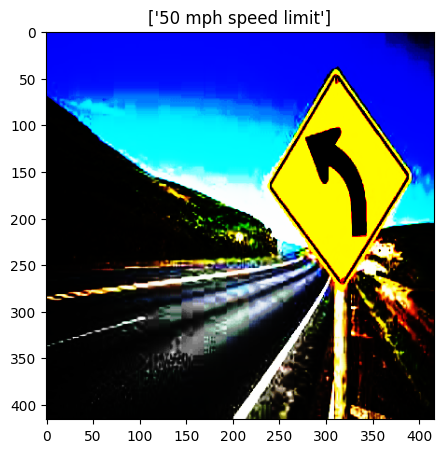

original prediction

0: 416x416 1 Turn left ahead, 394.3ms
Speed: 0.0ms preprocess, 394.3ms inference, 3.8ms postprocess per image at shape (1, 3, 416, 416)
tensor([27])
tensor([27])
tensor([27])
tensor([27])
tensor([27])
tensor([27])
tensor([27])
tensor([27])
tensor([27])
tensor([27])
prediction after attack

0: 416x416 1 Turn right ahead, 368.0ms
Speed: 0.0ms preprocess, 368.0ms inference, 3.8ms postprocess per image at shape (1, 3, 416, 416)


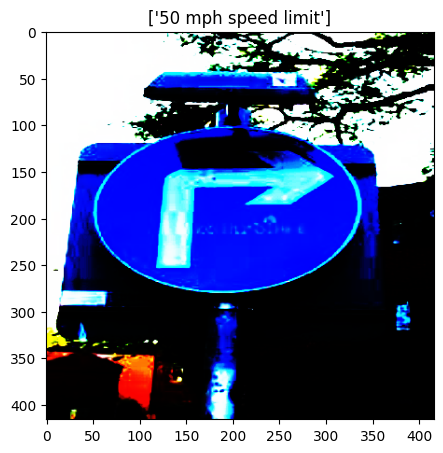

original prediction

0: 416x416 1 Turn left ahead, 1 Turn right ahead, 400.4ms
Speed: 0.0ms preprocess, 400.4ms inference, 3.8ms postprocess per image at shape (1, 3, 416, 416)
tensor([27])
tensor([27])
tensor([27])
tensor([27])
tensor([27])
tensor([27])
tensor([27])
tensor([27])
tensor([27])
tensor([27])
prediction after attack

0: 416x416 1 Turn left ahead, 403.7ms
Speed: 0.0ms preprocess, 403.7ms inference, 3.8ms postprocess per image at shape (1, 3, 416, 416)


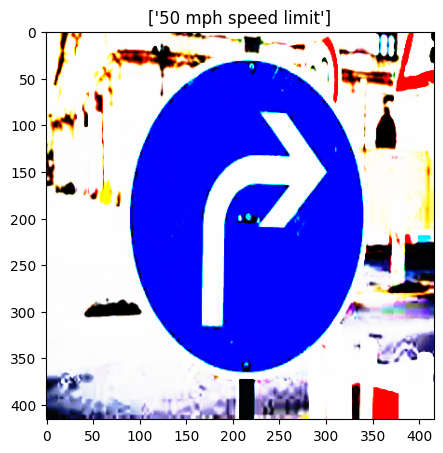

original prediction

0: 416x416 1 Turn left ahead, 442.3ms
Speed: 0.0ms preprocess, 442.3ms inference, 4.5ms postprocess per image at shape (1, 3, 416, 416)
tensor([27])
tensor([27])
tensor([27])
tensor([27])
tensor([27])
tensor([27])
tensor([27])
tensor([27])
tensor([27])
tensor([27])
prediction after attack

0: 416x416 1 Turn left ahead, 369.2ms
Speed: 0.0ms preprocess, 369.2ms inference, 3.7ms postprocess per image at shape (1, 3, 416, 416)


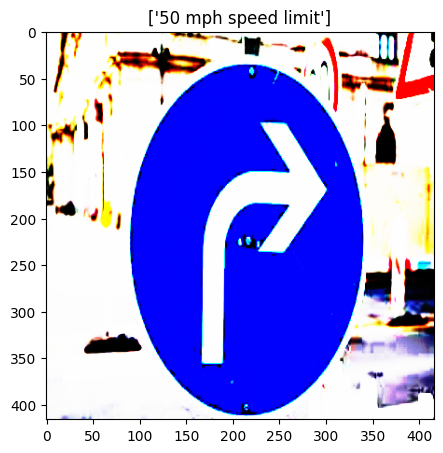

original prediction

0: 416x416 1 Uneven Road, 366.7ms
Speed: 0.0ms preprocess, 366.7ms inference, 4.1ms postprocess per image at shape (1, 3, 416, 416)
tensor([28])
tensor([28])
tensor([28])
tensor([28])
tensor([28])
tensor([28])
tensor([28])
tensor([28])
tensor([28])
tensor([28])
prediction after attack

0: 416x416 1 Uneven Road, 394.6ms
Speed: 0.0ms preprocess, 394.6ms inference, 4.2ms postprocess per image at shape (1, 3, 416, 416)


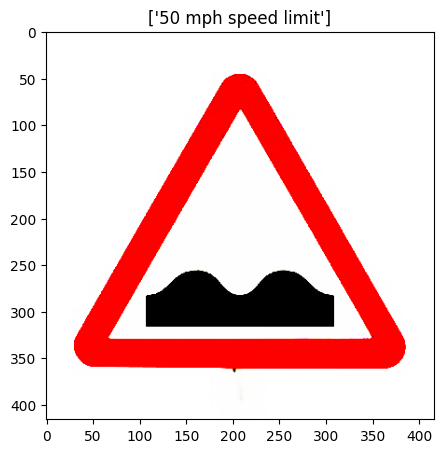

original prediction

0: 416x416 1 Traffic_signal, 371.7ms
Speed: 0.0ms preprocess, 371.7ms inference, 3.8ms postprocess per image at shape (1, 3, 416, 416)
tensor([28])
tensor([28])
tensor([28])
tensor([28])
tensor([28])
tensor([28])
tensor([28])
tensor([28])
tensor([28])
tensor([28])
prediction after attack

0: 416x416 1 CYCLE ROUTE AHEAD WARNING, 387.3ms
Speed: 0.0ms preprocess, 387.3ms inference, 4.8ms postprocess per image at shape (1, 3, 416, 416)


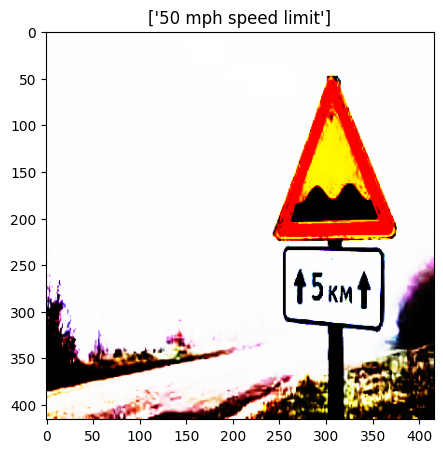

original prediction

0: 416x416 (no detections), 399.2ms
Speed: 0.0ms preprocess, 399.2ms inference, 3.8ms postprocess per image at shape (1, 3, 416, 416)
tensor([28])
tensor([28])
tensor([28])
tensor([28])
tensor([28])
tensor([28])
tensor([28])
tensor([28])
tensor([28])
tensor([28])
prediction after attack

0: 416x416 1 Attention Please-, 385.1ms
Speed: 0.0ms preprocess, 385.1ms inference, 3.8ms postprocess per image at shape (1, 3, 416, 416)


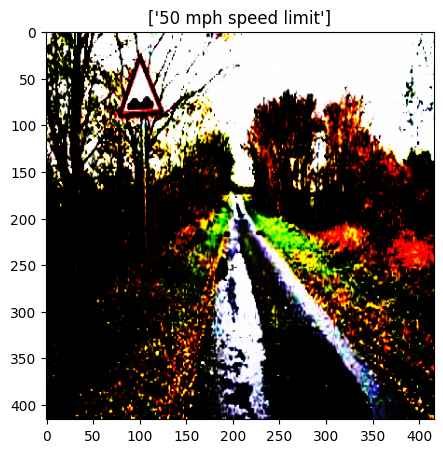

Accuracy of test text: 3.225806 %


In [145]:
print("Attack Image & Predicted Label")

classify_model.eval()

correct = 0
total = 0

for images, labels in normal_loader:
    print("original prediction")
    boxes, scores, labels_yolo = get_yolo_output(Model, images)


    images_changed = cw_l2_attack(classify_model, images, labels, targeted=False, c=0.1)



    _, pre = torch.max(outputs.data, 1)

    total += 1
    correct += (pre == labels).sum()

    #yolo
    print("prediction after attack")
    perturbed_boxes, perturbed_scores, perturbed_labels = get_yolo_output(Model, images_changed)

    imshow(torchvision.utils.make_grid(images_changed.cpu().data, normalize=True), [normal_data.classes[i] for i in pre])

print('Accuracy of test text: %f %%' % (100 * float(correct) / total))

In [ ]:
Model.names #Go Straight or Turn Right

{0: '-Road narrows on right',
 1: '50 mph speed limit',
 2: 'Attention Please-',
 3: 'Beware of children',
 4: 'CYCLE ROUTE AHEAD WARNING',
 5: 'Dangerous Left Curve Ahead',
 6: 'Dangerous Rright Curve Ahead',
 7: 'End of all speed and passing limits',
 8: 'Give Way',
 9: 'Go Straight or Turn Right',
 10: 'Go straight or turn left',
 11: 'Keep-Left',
 12: 'Keep-Right',
 13: 'Left Zig Zag Traffic',
 14: 'No Entry',
 15: 'No_Over_Taking',
 16: 'Overtaking by trucks is prohibited',
 17: 'Pedestrian Crossing',
 18: 'Round-About',
 19: 'Slippery Road Ahead',
 20: 'Speed Limit 20 KMPh',
 21: 'Speed Limit 30 KMPh',
 22: 'Stop_Sign',
 23: 'Straight Ahead Only',
 24: 'Traffic_signal',
 25: 'Truck traffic is prohibited',
 26: 'Turn left ahead',
 27: 'Turn right ahead',
 28: 'Uneven Road'}

In [117]:
#Go Straight or Turn Right

labels_new=[['Speed Limit 20 KMPh']*7,['Speed Limit 30 KMPh']*4 , ['50 mph speed limit']*4,['Attention Please-']*5,['Beware of children']*5,['CYCLE ROUTE AHEAD WARNING']*3,['Dangerous Left Curve Ahead']*5,['Dangerous Rright Curve Ahead']*4,['End of all speed and passing limits']*3,['Give Way']*6,['Go straight or turn left']*3,['Go Straight or Turn Right']*4,['Keep-Left']*3,['Keep-Right']*5,['Left Zig Zag Traffic']*2,['No Entry']*7,['No_Over_Taking']*5,['Overtaking by trucks is prohibited']*2,['Pedestrian Crossing']*5,['-Road narrows on right']*4,['Round-About']*7,['Slippery Road Ahead']*7,['Stop_Sign']*6,['Straight Ahead Only']*3,['Traffic_signal']*3,['Truck traffic is prohibited']*3,[ 'Turn left ahead']*3,['Turn right ahead']*3,['Uneven Road']*3]
sorted_labels_new=sorted(labels_new)
sorted_labels_new



[['-Road narrows on right',
  '-Road narrows on right',
  '-Road narrows on right',
  '-Road narrows on right'],
 ['50 mph speed limit',
  '50 mph speed limit',
  '50 mph speed limit',
  '50 mph speed limit'],
 ['Attention Please-',
  'Attention Please-',
  'Attention Please-',
  'Attention Please-',
  'Attention Please-'],
 ['Beware of children',
  'Beware of children',
  'Beware of children',
  'Beware of children',
  'Beware of children'],
 ['CYCLE ROUTE AHEAD WARNING',
  'CYCLE ROUTE AHEAD WARNING',
  'CYCLE ROUTE AHEAD WARNING'],
 ['Dangerous Left Curve Ahead',
  'Dangerous Left Curve Ahead',
  'Dangerous Left Curve Ahead',
  'Dangerous Left Curve Ahead',
  'Dangerous Left Curve Ahead'],
 ['Dangerous Rright Curve Ahead',
  'Dangerous Rright Curve Ahead',
  'Dangerous Rright Curve Ahead',
  'Dangerous Rright Curve Ahead'],
 ['End of all speed and passing limits',
  'End of all speed and passing limits',
  'End of all speed and passing limits'],
 ['Give Way', 'Give Way', 'Give Way',

In [118]:
nested_list = labels_new
flattened_list = [item for sublist in nested_list for item in sublist]
print(flattened_list)

len(flattened_list)

len(flattened_list)
flattened_list_unique=list(set(flattened_list))
len(flattened_list_unique)



['Speed Limit 20 KMPh', 'Speed Limit 20 KMPh', 'Speed Limit 20 KMPh', 'Speed Limit 20 KMPh', 'Speed Limit 20 KMPh', 'Speed Limit 20 KMPh', 'Speed Limit 20 KMPh', 'Speed Limit 30 KMPh', 'Speed Limit 30 KMPh', 'Speed Limit 30 KMPh', 'Speed Limit 30 KMPh', '50 mph speed limit', '50 mph speed limit', '50 mph speed limit', '50 mph speed limit', 'Attention Please-', 'Attention Please-', 'Attention Please-', 'Attention Please-', 'Attention Please-', 'Beware of children', 'Beware of children', 'Beware of children', 'Beware of children', 'Beware of children', 'CYCLE ROUTE AHEAD WARNING', 'CYCLE ROUTE AHEAD WARNING', 'CYCLE ROUTE AHEAD WARNING', 'Dangerous Left Curve Ahead', 'Dangerous Left Curve Ahead', 'Dangerous Left Curve Ahead', 'Dangerous Left Curve Ahead', 'Dangerous Left Curve Ahead', 'Dangerous Rright Curve Ahead', 'Dangerous Rright Curve Ahead', 'Dangerous Rright Curve Ahead', 'Dangerous Rright Curve Ahead', 'End of all speed and passing limits', 'End of all speed and passing limits', 

In [120]:
import json

with open("model_labels.json", "w") as file:
    json.dump(Model.names ,file)
